In [1]:
import os

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import nibabel as nib
import seaborn as sns

from nilearn import plotting
from nilearn.image import new_img_like

In [2]:
import rsatoolbox
from rsatoolbox.inference import eval_fixed
from rsatoolbox.model import ModelFixed, Model
from rsatoolbox.rdm import RDMs
from rsatoolbox.vis import show_rdm, show_rdm_panel

from rsatoolbox.util.searchlight import get_volume_searchlight, get_searchlight_RDMs, evaluate_models_searchlight
from glob import glob

In [3]:
def upper_tri(RDM):
    """upper_tri returns the upper triangular index of an RDM

    Args:
        RDM 2Darray: squareform RDM

    Returns:
        1D array: upper triangular vector of the RDM
    """
    # returns the upper triangle
    m = RDM.shape[0]
    r, c = np.triu_indices(m, 1)
    return RDM[r, c]

In [4]:
project_dir = os.path.join('/bgfs/bchandrasekaran/krs228/data/', 'FLT/')
fmriprep_dir = os.path.join(project_dir, 'data_denoised/derivatives/',
                            'denoised_fmriprep-22.1.1/')

bidsroot = os.path.join(project_dir, 'data_denoised')
deriv_dir = os.path.join(bidsroot, 'derivatives')

fwhm_sub = 0
model_dir = os.path.join(deriv_dir, 'nilearn', 'level-1_fwhm-{:.02f}'.format(fwhm_sub),)

task_list = ['tonecat']
space_label = 'MNI152NLin2009cAsym'

In [25]:
statmap = 'tstat' # 'beta'

In [30]:
model_desc = 'stimulus_per_run_LSS'

In [5]:
model_dir

'/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00'

## Make models

In [6]:
pattern_descriptors = {'tone': ['T1', 'T1', 'T1', 'T1', 
                                'T2', 'T2', 'T2', 'T2', 
                                'T3', 'T3', 'T3', 'T3', 
                                'T4', 'T4', 'T4', 'T4', ],
                       'talker': ['M1', 'M2', 'F1', 'F2',
                                  'M1', 'M2', 'F1', 'F2',
                                  'M1', 'M2', 'F1', 'F2',
                                  'M1', 'M2', 'F1', 'F2', ],
                      }
                                  

### Categorical RDMs

In [7]:
# make categorical RDMs
tone_rdm = np.array([[0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,],
                     [0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,],
                     [0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,],
                     [0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,],
                     [1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1,],
                     [1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1,],
                     [1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1,],
                     [1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1,],
                     [1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1,],
                     [1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1,],
                     [1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1,],
                     [1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1,],
                     [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0,],
                     [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0,],
                     [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0,],
                     [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0,], ])

talker_rdm = np.array([[0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, ],
                       [1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, ],
                       [1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, ],
                       [1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, ],
                       [0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, ],
                       [1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, ],
                       [1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, ],
                       [1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, ],
                       [0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, ],
                       [1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, ],
                       [1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, ],
                       [1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, ],
                       [0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, ],
                       [1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, ],
                       [1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, ],
                       [1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, ], ])

rdms_array = np.array([tone_rdm, talker_rdm])

In [8]:
cat_rdms = RDMs(rdms_array,
                  rdm_descriptors={'categorical_model':['tone', 'talker'],},
                  pattern_descriptors=pattern_descriptors,
                  dissimilarity_measure='Euclidean'
                 )

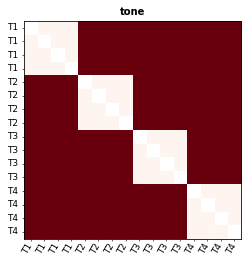

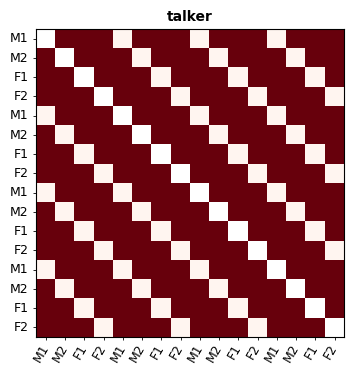

In [9]:
tone_rdms = cat_rdms.subset('categorical_model','tone')
fig, ax, ret_val = show_rdm(tone_rdms, rdm_descriptor='categorical_model', 
                            pattern_descriptor='tone', cmap='Reds', figsize=(4,4))

talker_rdms = cat_rdms.subset('categorical_model','talker')
fig, ax, ret_val = show_rdm(talker_rdms, rdm_descriptor='categorical_model', 
                            pattern_descriptor='talker', cmap='Reds', figsize=(4,4))

#### Convert from RDM to Model

In [10]:
tone_model = ModelFixed( 'Tone RDM', cat_rdms.subset('categorical_model', 'tone'))
talker_model = ModelFixed( 'Talker RDM', cat_rdms.subset('categorical_model', 'talker'))
cat_models = [tone_model, talker_model]

In [11]:
tone_model.name

'Tone RDM'

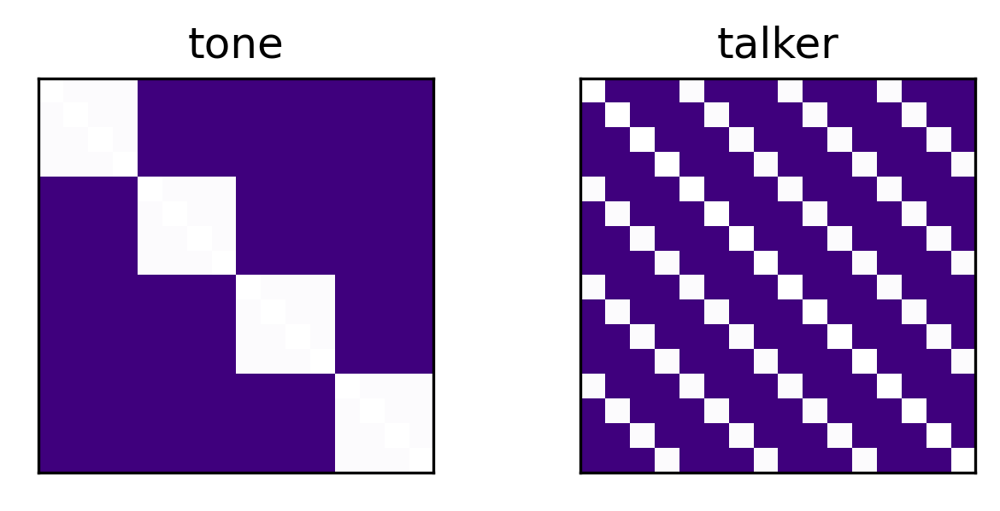

In [12]:
fig, axs = plt.subplots(1, 2, figsize=(5,2), dpi=300)

#show_rdm_panel(ffr_rdm, ax=axs.flat[0], rdm_descriptor='FFR model', cmap='inferno',)
show_rdm_panel(tone_rdms, ax=axs.flat[0], rdm_descriptor='categorical_model', cmap='Purples',)
show_rdm_panel(talker_rdms, ax=axs.flat[1], rdm_descriptor='categorical_model', cmap='Purples',)


### Merge model lists

In [13]:
#all_models = stim_models + ffr_models + cat_models
all_models = cat_models

In [14]:
[print(x.name) for x in all_models];

Tone RDM
Talker RDM


### Load subject-specific FFR classification confusion matrices

In [38]:
# load FFR classification confusion matrices
import pickle
with open('FFR_confusion_matrices/confusion_matrices.pickle', 'rb') as o:
    ffr_conf_mats = pickle.load(o)

## Set up participants

In [24]:
participants_fpath = os.path.join(bidsroot, 'participants.tsv')
participants_df = pd.read_csv(participants_fpath, sep='\t')

# subjects to ignore (not fully processed, etc.)
ignore_subs = ['sub-FLT27', # always leave out FLT27 – did not participate
               'sub-FLT07', # bad QA 11/14/23 
               'sub-FLT02', # incorrect button press coding for run00
              ]
participants_df.drop(participants_df[participants_df.participant_id.isin(ignore_subs)].index,
                     inplace=True)

# re-sort by participant ID
participants_df.sort_values(by=['participant_id'], 
                            ignore_index=True, 
                            inplace=True)

In [25]:
participants_df

,participant_id,age,sex,group,FFR_id
0,sub-FLT03,25,F,Mandarin,2002.0
1,sub-FLT04,21,F,non-Mandarin,1003.0
2,sub-FLT05,26,M,Mandarin,3010.0
3,sub-FLT06,21,F,non-Mandarin,3001.0
4,sub-FLT08,23,F,Mandarin,2005.0
5,sub-FLT09,30,F,non-Mandarin,3002.0
6,sub-FLT10,23,F,Mandarin,2006.0
7,sub-FLT11,20,F,non-Mandarin,1005.0
8,sub-FLT12,20,F,non-Mandarin,3004.0
9,sub-FLT13,23,F,non-Mandarin,3005.0


In [26]:
# create group-specific lists of subject IDs
sub_group_dict = {'Mandarin': list(participants_df.participant_id[participants_df.group=='Mandarin']),
                  'non-Mandarin': list(participants_df.participant_id[participants_df.group=='non-Mandarin'])}

In [27]:
len(sub_group_dict['Mandarin'])

13

In [28]:
sub_group_dict

{'Mandarin': ['sub-FLT03',
  'sub-FLT05',
  'sub-FLT08',
  'sub-FLT10',
  'sub-FLT15',
  'sub-FLT17',
  'sub-FLT18',
  'sub-FLT19',
  'sub-FLT21',
  'sub-FLT22',
  'sub-FLT23',
  'sub-FLT24',
  'sub-FLT26'],
 'non-Mandarin': ['sub-FLT04',
  'sub-FLT06',
  'sub-FLT09',
  'sub-FLT11',
  'sub-FLT12',
  'sub-FLT13',
  'sub-FLT14',
  'sub-FLT20',
  'sub-FLT25',
  'sub-FLT28',
  'sub-FLT30']}

In [29]:
participant_list = participants_df.participant_id
participant_list = [p.split('-')[1] for p in participant_list]
group_assignment = participants_df.group

# Auditory network

## Define network ROIs

In [195]:
## define ROIs
network_name = 'auditory' # 'tian_subcortical_S3' # auditory

if network_name == 'auditory':
    roi_list_ordered = [
                'L-IC', 'L-MGN', 'L-HG', 'L-PT',  'L-PP', 'L-STGp', 'L-STGa', 'L-ParsOp', 'L-ParsTri',
                'R-IC', 'R-MGN', 'R-HG', 'R-PT',  'R-PP', 'R-STGp', 'R-STGa', 'R-ParsOp', 'R-ParsTri', 
               ]
elif network_name == 'aud-striatal':
    roi_list_ordered = ['L-Caud', 'L-Put', 'L-IC', 'L-MGN',
                'L-HG', 'L-PP', 'L-PT', 'L-STGa', 'L-STGp', 
                'L-ParsOp', 'L-ParsTri',
                'R-Caud', 'R-Put','R-IC', 'R-MGN',
                'R-HG', 'R-PP', 'R-PT', 'R-STGa', 'R-STGp', 
                'R-ParsOp', 'R-ParsTri',
               ]
elif network_name == 'tian_subcortical_S3':
    roi_list_ordered = [
                'CAU-DA-lh', 'CAU-VA-lh', 'pCAU-lh', 
                'PUT-DA-lh', 'PUT-DP-lh', 'PUT-VA-lh', 'PUT-VP-lh',
                'aGP-lh', 'pGP-lh', 'NAc-core-lh', 'NAc-shell-lh',
                'CAU-DA-rh', 'CAU-VA-rh', 'pCAU-rh', 
                'PUT-DA-rh', 'PUT-DP-rh', 'PUT-VA-rh', 'PUT-VP-rh',
                'aGP-rh', 'pGP-rh', 'NAc-core-rh', 'NAc-shell-rh', 
               ]
    


## Load run-specific subject-specific RDMs

In [163]:
# from `rsa_roi.py`-generated outputs
group_rdm_list = []
for sx, sub_id in enumerate(participant_list): # enumerate(['FLT03']): #
    print(sub_id)
    group_id = group_assignment[sx]

    out_dir = os.path.join(model_dir, 'rsa_roi', network_name)
    sub_fpath = os.path.join(out_dir,
                         f'sub-{sub_id}_{network_name}_{model_desc}_rdms.hdf5')
    sub_rdm = rsatoolbox.rdm.rdms.load_rdm(sub_fpath)
    
    # add the group descriptor to the subject's RDM
    sub_rdm.rdm_descriptors['group'] = [group_id for x in sub_rdm.rdm_descriptors['index']]
    group_rdm_list.append(sub_rdm)
group_rdms = rsatoolbox.rdm.rdms.concat(group_rdm_list)

FLT03
FLT04
FLT05
FLT06
FLT08
FLT09
FLT10
FLT11
FLT12
FLT13
FLT14
FLT15
FLT17
FLT18
FLT19
FLT20
FLT21
FLT22
FLT23
FLT24
FLT25
FLT26
FLT28
FLT30


### Per run, per participant

group-Mandarin ROI-L-STGp sub-FLT03
group-Mandarin ROI-R-STGp sub-FLT03
group-Mandarin ROI-L-STGp sub-FLT05
group-Mandarin ROI-R-STGp sub-FLT05
group-Mandarin ROI-L-STGp sub-FLT08
group-Mandarin ROI-R-STGp sub-FLT08
group-Mandarin ROI-L-STGp sub-FLT10
group-Mandarin ROI-R-STGp sub-FLT10
group-Mandarin ROI-L-STGp sub-FLT15
group-Mandarin ROI-R-STGp sub-FLT15
group-Mandarin ROI-L-STGp sub-FLT17
group-Mandarin ROI-R-STGp sub-FLT17
group-Mandarin ROI-L-STGp sub-FLT18
group-Mandarin ROI-R-STGp sub-FLT18
group-Mandarin ROI-L-STGp sub-FLT19
group-Mandarin ROI-R-STGp sub-FLT19
group-Mandarin ROI-L-STGp sub-FLT21
group-Mandarin ROI-R-STGp sub-FLT21
group-Mandarin ROI-L-STGp sub-FLT22
group-Mandarin ROI-R-STGp sub-FLT22
group-Mandarin ROI-L-STGp sub-FLT23
group-Mandarin ROI-R-STGp sub-FLT23
group-Mandarin ROI-L-STGp sub-FLT24


/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/rsatoolbox/vis/model_plot.py:282: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(12.5, 10))


group-Mandarin ROI-R-STGp sub-FLT24
group-Mandarin ROI-L-STGp sub-FLT26
group-Mandarin ROI-R-STGp sub-FLT26
group-non-Mandarin ROI-L-STGp sub-FLT04
group-non-Mandarin ROI-R-STGp sub-FLT04
group-non-Mandarin ROI-L-STGp sub-FLT06
group-non-Mandarin ROI-R-STGp sub-FLT06
group-non-Mandarin ROI-L-STGp sub-FLT09
group-non-Mandarin ROI-R-STGp sub-FLT09
group-non-Mandarin ROI-L-STGp sub-FLT11
group-non-Mandarin ROI-R-STGp sub-FLT11
group-non-Mandarin ROI-L-STGp sub-FLT12
group-non-Mandarin ROI-R-STGp sub-FLT12
group-non-Mandarin ROI-L-STGp sub-FLT13
group-non-Mandarin ROI-R-STGp sub-FLT13
group-non-Mandarin ROI-L-STGp sub-FLT14
group-non-Mandarin ROI-R-STGp sub-FLT14
group-non-Mandarin ROI-L-STGp sub-FLT20
group-non-Mandarin ROI-R-STGp sub-FLT20
group-non-Mandarin ROI-L-STGp sub-FLT25
group-non-Mandarin ROI-R-STGp sub-FLT25
group-non-Mandarin ROI-L-STGp sub-FLT28
group-non-Mandarin ROI-R-STGp sub-FLT28
group-non-Mandarin ROI-L-STGp sub-FLT30
group-non-Mandarin ROI-R-STGp sub-FLT30


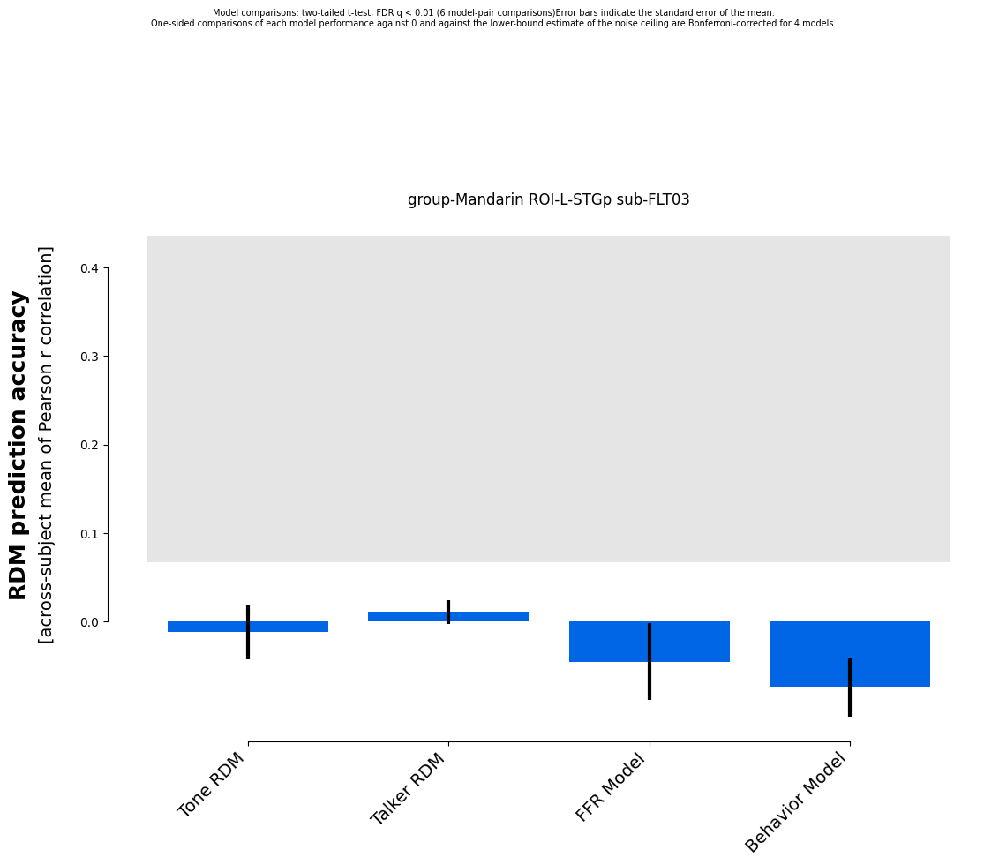

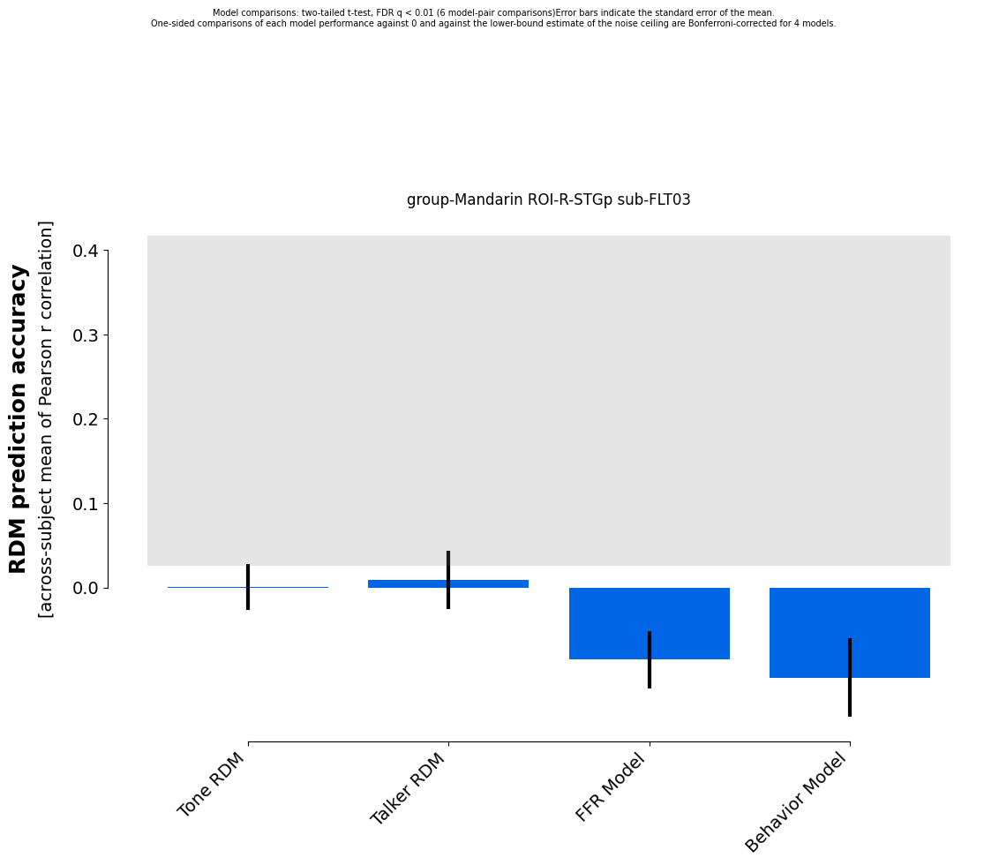

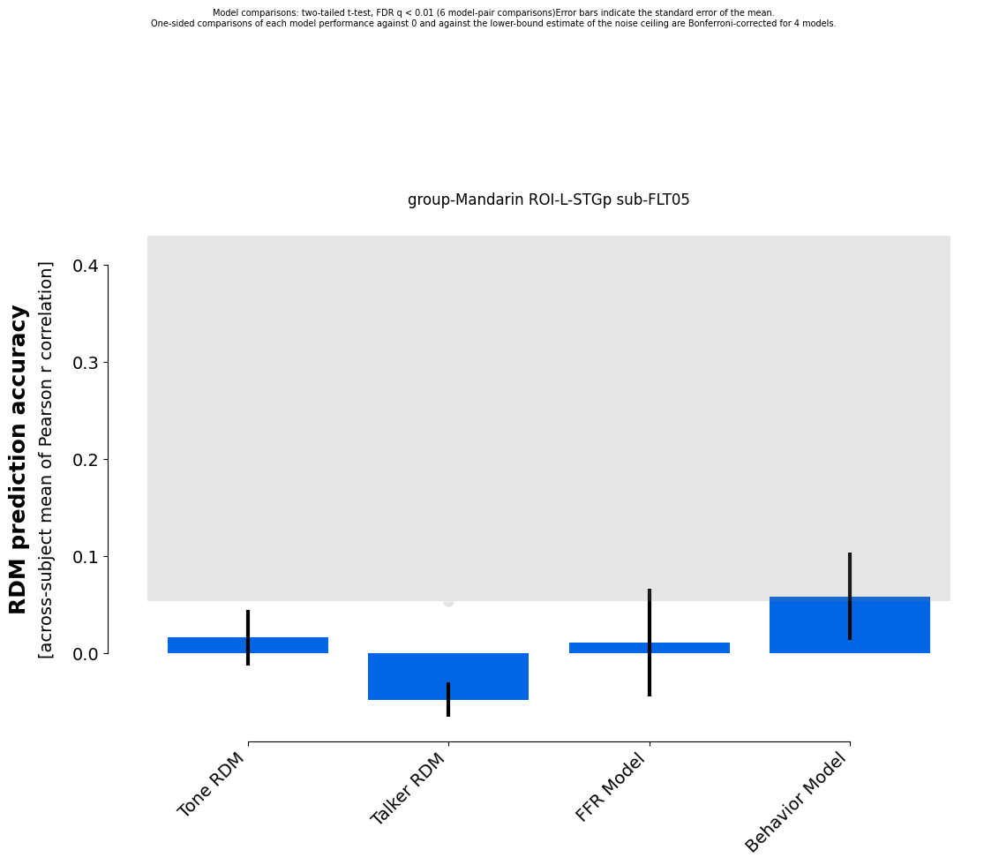

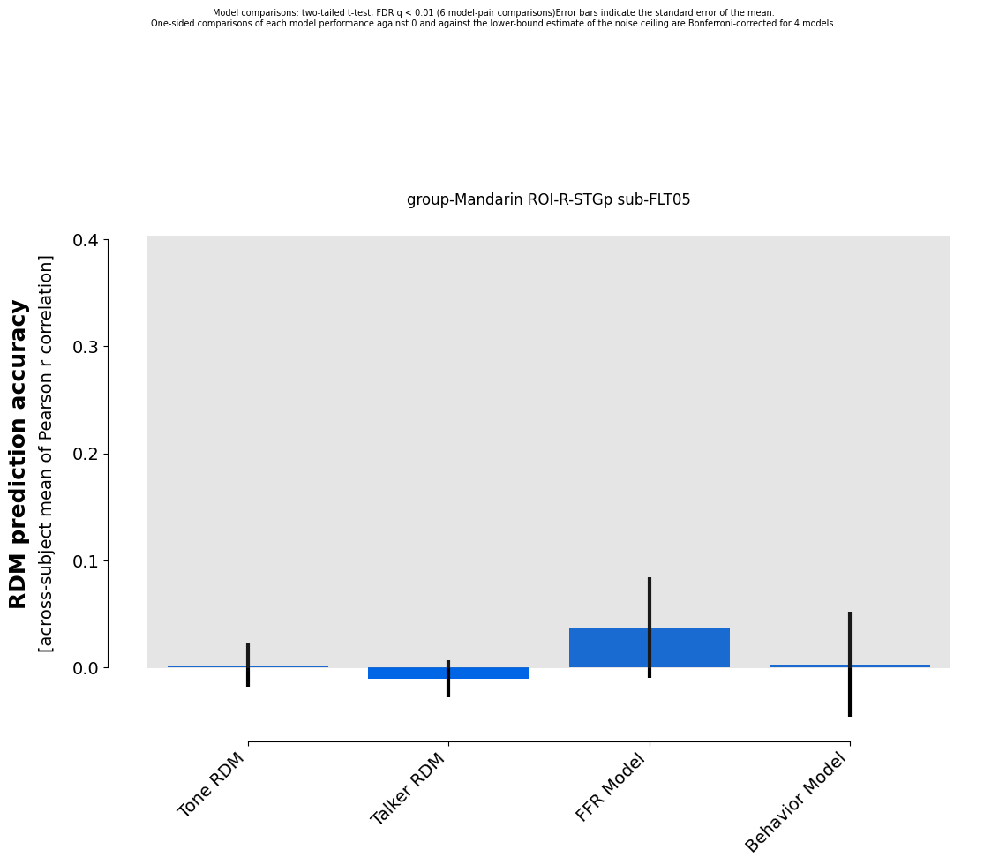

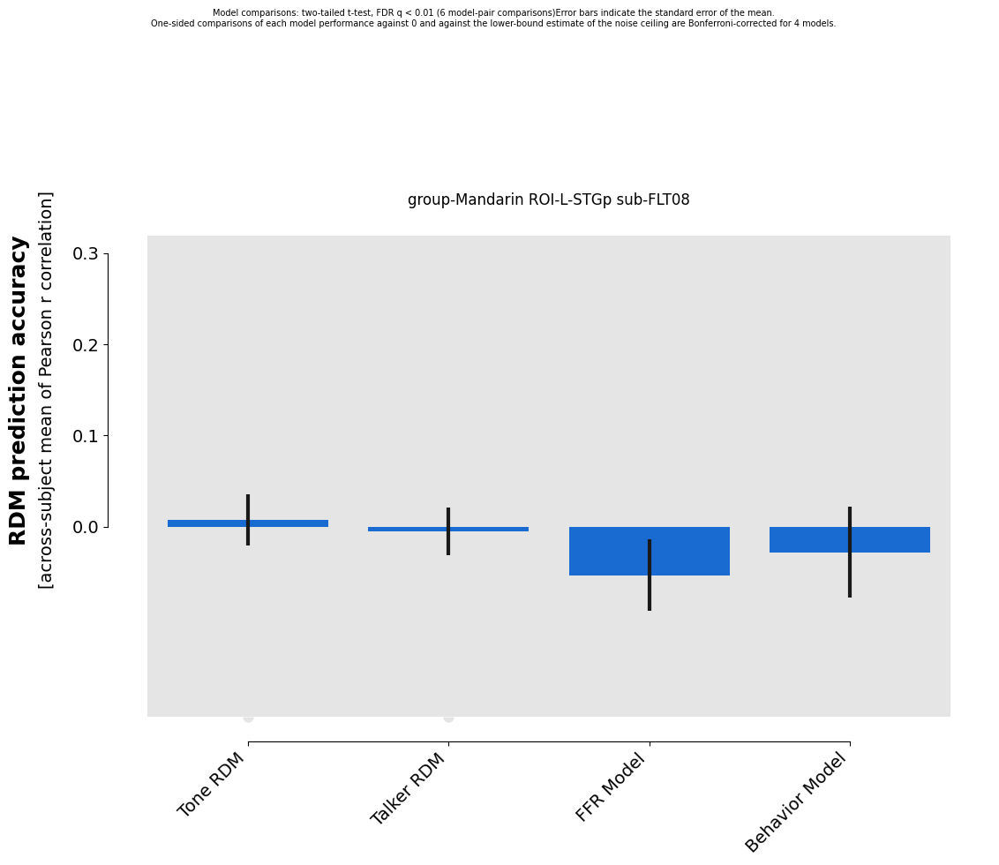

...

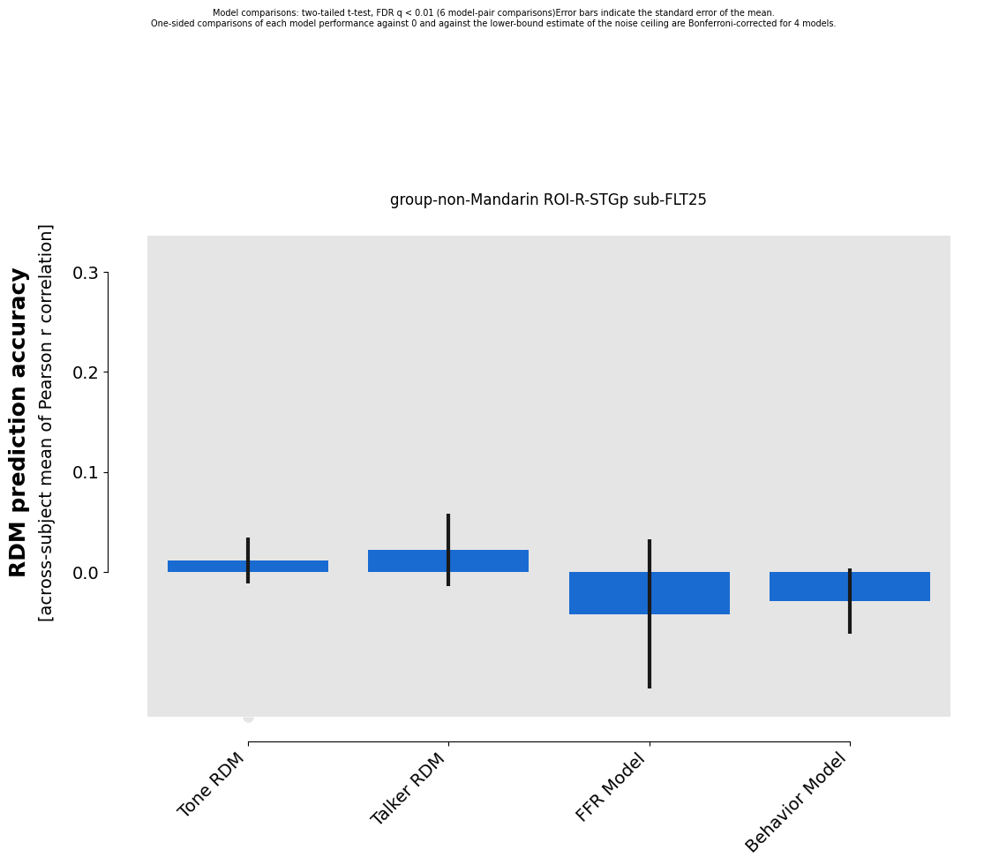

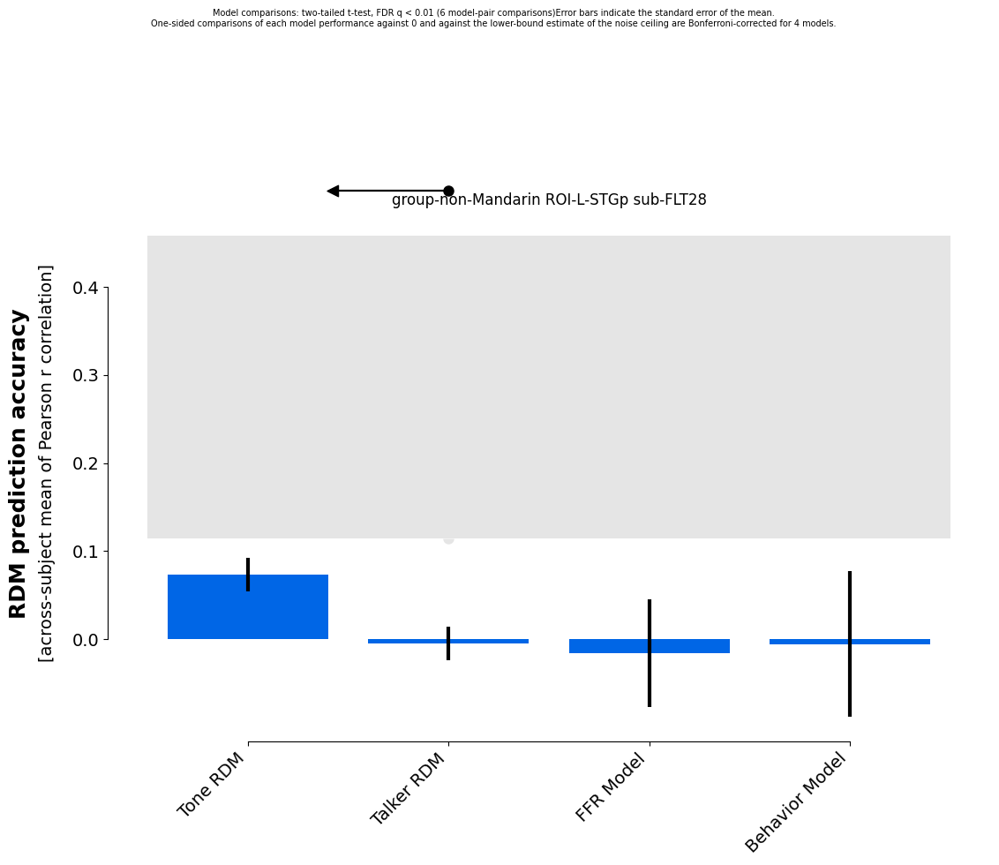

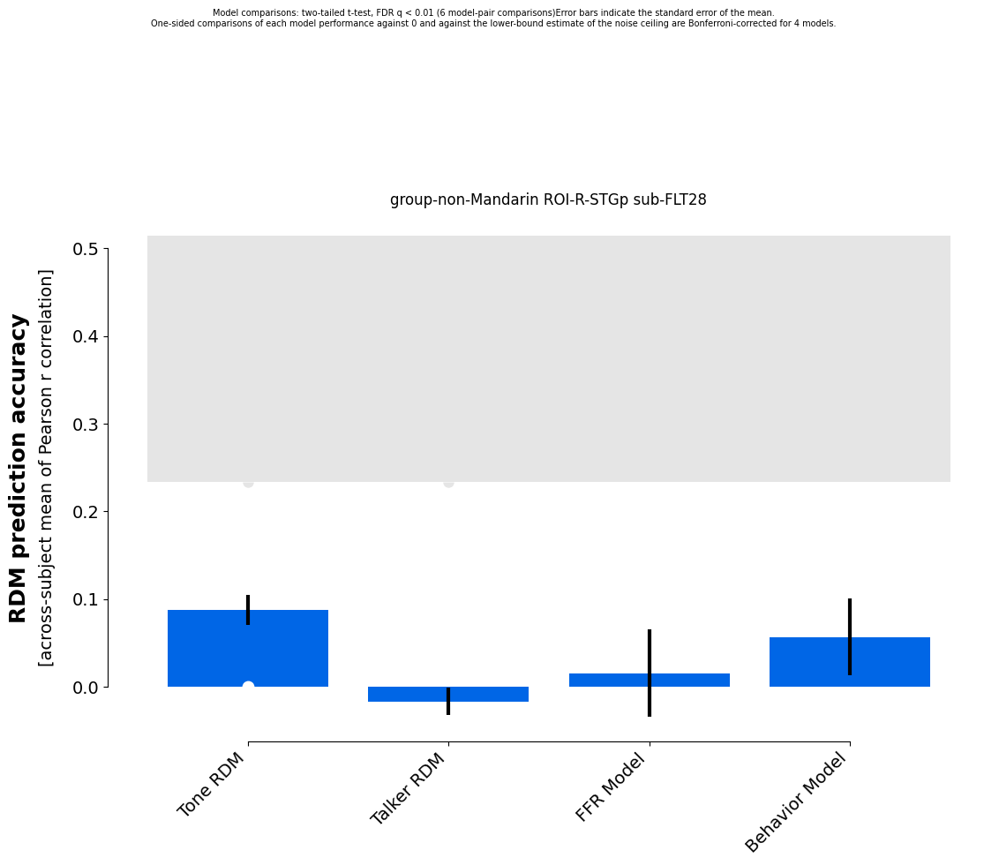

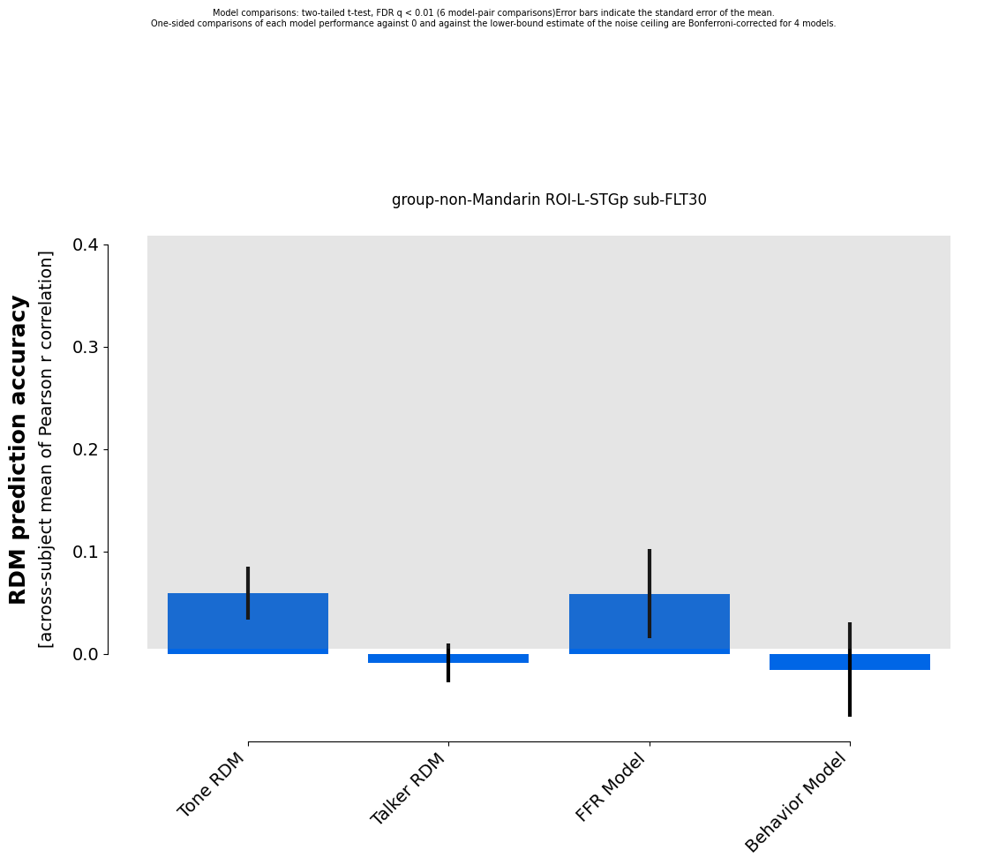

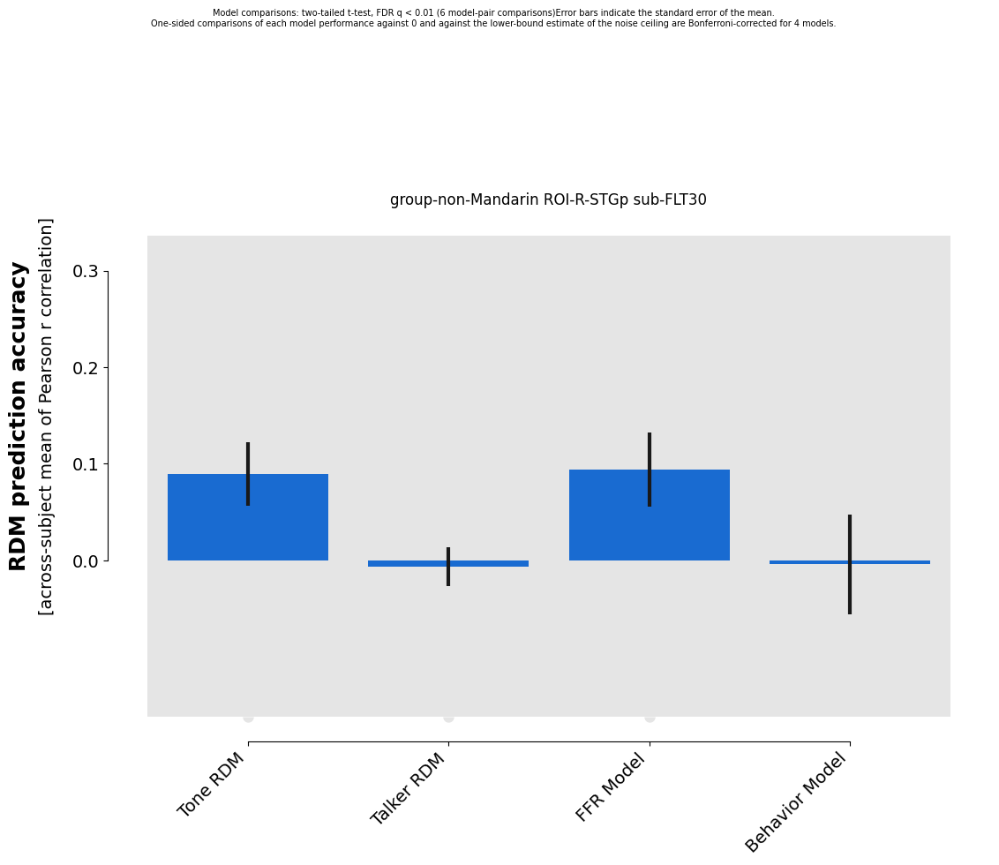

In [164]:
'''
ROI = 'mask-R-ParsTri'
'''

for group in sub_group_dict:
    for sub_id_long in sub_group_dict[group]:
        sub_id = sub_id_long[4:]
        for ROI in np.unique(group_rdms.rdm_descriptors['ROI']):
            if ROI == 'mask-L-MGN':
                continue
            if 'STGp' in ROI:
                print(f'group-{group} ROI-{ROI} sub-{sub_id}')
                results_grr = rsatoolbox.inference.eval_fixed(all_models, 
                                                              group_rdms.subset('ROI',value=ROI).subset('participant', value=sub_id),  
                                                              method='corr',)
                fig, ax1, ax2 = rsatoolbox.vis.plot_model_comparison(results_grr);
                ax1.set_title(f'group-{group} ROI-{ROI} sub-{sub_id}');
                ax1.axes.set_xticklabels(ax1.xaxis.get_majorticklabels(), ha="right")


### Per "stage" (runcombo), per subject

In [165]:
runcombo_dict = {'early': ['run00', 'run01'], 
                 'middle': ['run02', 'run03'], 
                 'final': ['run04','run05']}

#### Load run-specific subject-specific behavioral confusion matrices

In [166]:
beh_mat_dict = {}
for sx, sub_id in enumerate(participant_list): 
    print(sub_id)
    group_id = group_assignment[sx]
    
    sub_beh_dir = os.path.join(deriv_dir, 'behavior', f'sub-{sub_id}')
    
    sub_cm_dict = {}
    sub_cm_list = []
    for rx, run in enumerate(np.unique(group_rdms.rdm_descriptors['run'])):
        sub_run_stim_cm = np.genfromtxt(os.path.join(sub_beh_dir, f'sub-{sub_id}_run-0{rx+1}_stimulus_confusion_matrix.tsv'))
        
        sub_cm_dict[run] = sub_run_stim_cm
        sub_cm_list.append(sub_run_stim_cm)
        
    beh_mat_dict[sub_id] = sub_cm_dict

FLT03
FLT04
FLT05
FLT06
FLT08
FLT09
FLT10
FLT11
FLT12
FLT13
FLT14
FLT15
FLT17
FLT18
FLT19
FLT20
FLT21
FLT22
FLT23
FLT24
FLT25
FLT26
FLT28
FLT30


In [167]:
beh_mat_dict.keys()

dict_keys(['FLT03', 'FLT04', 'FLT05', 'FLT06', 'FLT08', 'FLT09', 'FLT10', 'FLT11', 'FLT12', 'FLT13', 'FLT14', 'FLT15', 'FLT17', 'FLT18', 'FLT19', 'FLT20', 'FLT21', 'FLT22', 'FLT23', 'FLT24', 'FLT25', 'FLT26', 'FLT28', 'FLT30'])

In [168]:
len(sub_cm_list)

6

#### Combine early, middle, and final run behavior RDMs

In [169]:
stage_beh_mat_dict = {}
for sub_id in beh_mat_dict:
    print(sub_id)
    
    sub_dict = {}
    sub_early_mat = np.mean(np.array([beh_mat_dict[sub_id]['run00'], beh_mat_dict[sub_id]['run01']]), axis=0)
    sub_middle_mat = np.mean(np.array([beh_mat_dict[sub_id]['run02'], beh_mat_dict[sub_id]['run03']]), axis=0)
    sub_final_mat = np.mean(np.array([beh_mat_dict[sub_id]['run04'], beh_mat_dict[sub_id]['run05']]), axis=0)
    
    sub_dict['early'] = sub_early_mat
    sub_dict['middle'] = sub_middle_mat
    sub_dict['final'] = sub_final_mat
    
    stage_beh_mat_dict[sub_id] = sub_dict

FLT03
FLT04
FLT05
FLT06
FLT08
FLT09
FLT10
FLT11
FLT12
FLT13
FLT14
FLT15
FLT17
FLT18
FLT19
FLT20
FLT21
FLT22
FLT23
FLT24
FLT25
FLT26
FLT28
FLT30


### Participant-specific across-model comparisons

In [170]:
group_dict = {}

for group_id in np.unique(group_rdms.rdm_descriptors['group']):

    for full_sub_id in sub_group_dict[group_id]:
        sub_id = full_sub_id[4:]
        try:
            ffr_id = str(int(participants_df[participants_df['participant_id'] == full_sub_id]['FFR_id'].values[0]))
            print(f'{sub_id} | ffr_id: {ffr_id}')
        except ValueError:
            print(f'no ffr_id for {sub_id}')
            continue

        sub_dict = {}
        
        # create FFR model from confusion matrix
        try:
            sub_ffr_mat = ffr_conf_mats[ffr_id]
        except KeyError:
            print(f'no FFR for subject {ffr_id}')
            continue
        norm_conf = sub_ffr_mat/np.sum(sub_ffr_mat, axis=1)
        inv_norm_conf = -1 * norm_conf + 1

        ffr_rdm = RDMs(np.array([inv_norm_conf],))
        ffr_model = ModelFixed('FFR Model', rdm=ffr_rdm)

        for runcombo in runcombo_dict:
            # initialize results list
            runcombo_roi_res_dict = {}
            
            # create beh model from confusion matrix
            beh_mat = stage_beh_mat_dict[sub_id][runcombo]
            beh_dis_mat = beh_mat * -1 +1
        
            beh_rdm = RDMs(np.array([beh_dis_mat],))
            beh_model = ModelFixed('Behavior Model', rdm=beh_rdm)
            
            # combine all four models to run concurrently
            all_models = [tone_model, talker_model, ffr_model, beh_model]

            for ROI in np.unique(group_rdms.rdm_descriptors['ROI']):
                if 'GP' not in ROI:
                    print(f'{sub_id} runcombo-{runcombo} ROI-{ROI}')
                    runs = runcombo_dict[runcombo]

                    results_grr = rsatoolbox.inference.eval_fixed(all_models, #ffr_model, 
                                                                  group_rdms.subset('participant', value=sub_id).subset('run',value=runs).subset('ROI',value=ROI),  
                                                                  method='corr',)
                    #print(f'p-value vs. 0: {results_grr.test_zero()[0]:.04f}')
                    runcombo_roi_res_dict[ROI] = results_grr.get_means()#[0]
                    #runcombo_roi_res_dict[ROI] = results_grr

            sub_dict[runcombo] = runcombo_roi_res_dict

        #except:
        #    print(f'no FFR data for {sub_id}')
        group_dict[sub_id] = sub_dict

FLT03 | ffr_id: 2002
FLT03 runcombo-early ROI-L-HG
FLT03 runcombo-early ROI-L-IC
FLT03 runcombo-early ROI-L-MGN
FLT03 runcombo-early ROI-L-PP
FLT03 runcombo-early ROI-L-PT
FLT03 runcombo-early ROI-L-ParsOp
FLT03 runcombo-early ROI-L-ParsTri
FLT03 runcombo-early ROI-L-STGa
FLT03 runcombo-early ROI-L-STGp
FLT03 runcombo-early ROI-R-HG
FLT03 runcombo-early ROI-R-IC
FLT03 runcombo-early ROI-R-MGN
FLT03 runcombo-early ROI-R-PP
FLT03 runcombo-early ROI-R-PT
FLT03 runcombo-early ROI-R-ParsOp
FLT03 runcombo-early ROI-R-ParsTri
FLT03 runcombo-early ROI-R-STGa
FLT03 runcombo-early ROI-R-STGp
FLT03 runcombo-middle ROI-L-HG
FLT03 runcombo-middle ROI-L-IC
FLT03 runcombo-middle ROI-L-MGN
FLT03 runcombo-middle ROI-L-PP
FLT03 runcombo-middle ROI-L-PT
FLT03 runcombo-middle ROI-L-ParsOp
FLT03 runcombo-middle ROI-L-ParsTri
FLT03 runcombo-middle ROI-L-STGa
FLT03 runcombo-middle ROI-L-STGp
FLT03 runcombo-middle ROI-R-HG
FLT03 runcombo-middle ROI-R-IC
FLT03 runcombo-middle ROI-R-MGN
FLT03 runcombo-middle RO

In [171]:
print(results_grr)

Results for running fixed evaluation for corr on 4 models:

Model          |   Eval ± SEM   | p (against 0) | p (against NC) |
------------------------------------------------------------------
Tone RDM       |  0.031 ± 0.053 |        0.330  |         0.653  |
Talker RDM     | -0.057 ± 0.016 |        0.915  |         0.082  |
FFR Model      |  0.154 ± 0.123 |        0.215  |         0.597  |
Behavior Model | -0.095 ± 0.058 |        0.824  |         0.225  |

p-values are based on uncorrected t-tests


In [172]:
group_df_list = []
for group_id in np.unique(group_rdms.rdm_descriptors['group']):
    print(group_id)
    sub_df_list = []
    
    for full_sub_id in sub_group_dict[group_id]:
        try:
            sub_id = full_sub_id[4:]

            sub_df = pd.DataFrame.from_dict(group_dict[sub_id])
            sub_df['sub_id'] = sub_id
            sub_df_list.append(sub_df)
        except KeyError:
            print(f'not available for {full_sub_id}')

    group_df = pd.concat(sub_df_list)
    group_df.reset_index(inplace=True)
    long_group_df = group_df.melt(value_vars=['early','middle','final'], id_vars='index', value_name='corr', var_name='stage', ignore_index=False)
    long_group_df['participant_group'] = group_id
    long_group_df.rename(columns={"index": "ROI"}, inplace=True)
    
    group_df_list.append(long_group_df)

long_df = pd.concat(group_df_list)

Mandarin
not available for sub-FLT05
not available for sub-FLT17
not available for sub-FLT19
not available for sub-FLT22
not available for sub-FLT23
not available for sub-FLT26
non-Mandarin
not available for sub-FLT20
not available for sub-FLT28
not available for sub-FLT30


In [173]:
# get model names for the models in the RSA operation
model_names = [x.name for x in results_grr.models]
print(model_names)

['Tone RDM', 'Talker RDM', 'FFR Model', 'Behavior Model']


In [174]:
# split the results arrays into single-element columns by model
long_df[model_names] = long_df['corr'].to_list()
long_df.drop('corr', axis='columns', inplace=True) 

In [175]:
long_df

,ROI,stage,participant_group,Tone RDM,Talker RDM,FFR Model,Behavior Model
0,L-HG,early,Mandarin,0.144426,0.004648,0.122179,0.136912
1,L-IC,early,Mandarin,0.095857,-0.059471,0.059149,0.089760
2,L-MGN,early,Mandarin,0.024895,0.018575,0.132867,0.021256
3,L-PP,early,Mandarin,0.162085,0.015270,0.060867,0.160222
4,L-PT,early,Mandarin,0.109846,-0.013564,0.164003,0.103666
...,...,...,...,...,...,...,...
139,R-PT,final,non-Mandarin,0.026445,-0.063302,0.152246,-0.085143
140,R-ParsOp,final,non-Mandarin,0.005294,-0.049883,0.107316,-0.059230
141,R-ParsTri,final,non-Mandarin,0.007732,-0.054543,0.130267,-0.061171
142,R-STGa,final,non-Mandarin,0.012597,-0.018636,0.147241,-0.025531


In [176]:
# reshape the dataframe again
model_long_df = long_df.melt(value_vars=model_names, 
                             id_vars=['ROI', 'stage', 'participant_group'], 
                             value_name='corr', 
                             var_name='model', 
                             ignore_index=False)

In [177]:
model_long_df

,ROI,stage,participant_group,model,corr
0,L-HG,early,Mandarin,Tone RDM,0.144426
1,L-IC,early,Mandarin,Tone RDM,0.095857
2,L-MGN,early,Mandarin,Tone RDM,0.024895
3,L-PP,early,Mandarin,Tone RDM,0.162085
4,L-PT,early,Mandarin,Tone RDM,0.109846
...,...,...,...,...,...
139,R-PT,final,non-Mandarin,Behavior Model,-0.085143
140,R-ParsOp,final,non-Mandarin,Behavior Model,-0.059230
141,R-ParsTri,final,non-Mandarin,Behavior Model,-0.061171
142,R-STGa,final,non-Mandarin,Behavior Model,-0.025531


In [178]:
from scipy import stats

In [179]:
for group_id in np.unique(group_rdms.rdm_descriptors['group']):
    group_long_df = model_long_df.where(model_long_df.participant_group==group_id)
    print(f'\ngroup = {group_id}')
    
    for model_id in model_names:
        print(f'\n{model_id}')
        for runcombo in ['early','final']:
            rc_df = group_long_df.where(group_long_df.stage==runcombo).where(group_long_df.model==model_id)
            print(f'\n{runcombo} runs')

            roi_list = []
            p_vals = []
            t_stats = []

            for roi in np.unique(group_rdms.rdm_descriptors['ROI']):
                if 'GP' not in roi:
                    groi_data = rc_df.where(rc_df.ROI==roi).dropna()['corr']
                    res = stats.ttest_1samp(groi_data, popmean=0)

                    p_vals.append(res.pvalue)
                    t_stats.append(res.statistic)
                    roi_list.append(roi)
            p_vals_adj = stats.false_discovery_control(p_vals)

            print('\nFDR-adjusted statistics')
            for rx, roi in enumerate(roi_list):
                if p_vals_adj[rx] < 0.05:
                    ast = ' *'
                if p_vals_adj[rx] < 0.01:
                    ast = '**'
                else:
                    ast = '  '
                print(f'{ast}t = {t_stats[rx]:.02f} p = {p_vals_adj[rx]:.04f} region = {roi}')

            print('\nunadjusted statistics')
            for rx, roi in enumerate(roi_list):
                if p_vals[rx] < 0.05:
                    ast = ' *'
                if p_vals[rx] < 0.01:
                    ast = '**'
                else:
                    ast = '  '
                print(f'{ast}t = {t_stats[rx]:.02f} p = {p_vals[rx]:.04f} region = {roi}')


group = Mandarin

Tone RDM

early runs

FDR-adjusted statistics
  t = 1.81 p = 0.3508 region = L-HG
  t = 0.46 p = 0.8112 region = L-IC
  t = -0.01 p = 0.9901 region = L-MGN
  t = 1.54 p = 0.3508 region = L-PP
  t = 1.81 p = 0.3508 region = L-PT
  t = 0.73 p = 0.6862 region = L-ParsOp
  t = 1.11 p = 0.4652 region = L-ParsTri
  t = 1.68 p = 0.3508 region = L-STGa
  t = 1.56 p = 0.3508 region = L-STGp
  t = 1.76 p = 0.3508 region = R-HG
  t = 0.44 p = 0.8112 region = R-IC
  t = -0.32 p = 0.8527 region = R-MGN
  t = 2.23 p = 0.3508 region = R-PP
  t = 2.47 p = 0.3508 region = R-PT
  t = 1.42 p = 0.3673 region = R-ParsOp
  t = 1.16 p = 0.4652 region = R-ParsTri
  t = 0.22 p = 0.8811 region = R-STGa
  t = 1.66 p = 0.3508 region = R-STGp

unadjusted statistics
  t = 1.81 p = 0.1210 region = L-HG
  t = 0.46 p = 0.6637 region = L-IC
  t = -0.01 p = 0.9901 region = L-MGN
  t = 1.54 p = 0.1754 region = L-PP
  t = 1.81 p = 0.1209 region = L-PT
  t = 0.73 p = 0.4956 region = L-ParsOp
  t = 1.11 p

In [180]:
# early vs. late runs

for group_id in np.unique(group_rdms.rdm_descriptors['group']):

    print(f'\ngroup = {group_id}')
    print(f'\nearly vs. late runs')
    
    group_long_df = model_long_df.where(model_long_df.participant_group==group_id)
    print(f'\ngroup = {group_id}')
    
    for model_id in model_names:
        print(f'\n{model_id}')
        roi_list = []
        p_vals = []
        t_stats = []

        early_df = group_long_df.where(group_long_df.stage=='early').where(group_long_df.model==model_id)
        final_df = group_long_df.where(group_long_df.stage=='final').where(group_long_df.model==model_id)


        for roi in np.unique(group_rdms.rdm_descriptors['ROI']):
            if 'GP' not in roi:
                early_data = early_df.where(early_df.ROI==roi).dropna()['corr']
                final_data = final_df.where(final_df.ROI==roi).dropna()['corr']

                res = stats.ttest_rel(final_data, early_data)

                p_vals.append(res.pvalue)
                t_stats.append(res.statistic)
                roi_list.append(roi)
        p_vals_adj = stats.false_discovery_control(p_vals)

        print('\nFDR-adjusted statistics')
        for rx, roi in enumerate(roi_list):
            if p_vals_adj[rx] < 0.05:
                ast = ' *'
            if p_vals_adj[rx] < 0.01:
                ast = '**'
            else:
                ast = '  '
            print(f'{ast}t = {t_stats[rx]:.02f} p = {p_vals_adj[rx]:.04f} region = {roi}')

        print('\nunadjusted statistics')
        for rx, roi in enumerate(roi_list):
            if p_vals[rx] < 0.05:
                ast = ' *'
            if p_vals[rx] < 0.01:
                ast = '**'
            else:
                ast = '  '
            print(f'{ast}t = {t_stats[rx]:.02f} p = {p_vals[rx]:.04f} region = {roi}')


group = Mandarin

early vs. late runs

group = Mandarin

Tone RDM

FDR-adjusted statistics
  t = -0.31 p = 0.9565 region = L-HG
  t = -1.15 p = 0.9565 region = L-IC
  t = 1.18 p = 0.9565 region = L-MGN
  t = -0.14 p = 0.9565 region = L-PP
  t = 0.53 p = 0.9565 region = L-PT
  t = 0.62 p = 0.9565 region = L-ParsOp
  t = -0.33 p = 0.9565 region = L-ParsTri
  t = -0.15 p = 0.9565 region = L-STGa
  t = 0.39 p = 0.9565 region = L-STGp
  t = -0.12 p = 0.9565 region = R-HG
  t = 0.74 p = 0.9565 region = R-IC
  t = 0.29 p = 0.9565 region = R-MGN
  t = 0.07 p = 0.9565 region = R-PP
  t = -0.33 p = 0.9565 region = R-PT
  t = -0.17 p = 0.9565 region = R-ParsOp
  t = -0.06 p = 0.9565 region = R-ParsTri
  t = 0.98 p = 0.9565 region = R-STGa
  t = 0.27 p = 0.9565 region = R-STGp

unadjusted statistics
  t = -0.31 p = 0.7659 region = L-HG
  t = -1.15 p = 0.2954 region = L-IC
  t = 1.18 p = 0.2837 region = L-MGN
  t = -0.14 p = 0.8964 region = L-PP
  t = 0.53 p = 0.6157 region = L-PT
  t = 0.62 p = 0

In [181]:
model_long_df.reset_index(inplace=True)

In [182]:
model_long_df.drop(model_long_df[model_long_df.stage=='middle'].index, inplace=True)

In [194]:
roi_list

['L-HG',
 'L-IC',
 'L-MGN',
 'L-PP',
 'L-PT',
 'L-ParsOp',
 'L-ParsTri',
 'L-STGa',
 'L-STGp',
 'R-HG',
 'R-IC',
 'R-MGN',
 'R-PP',
 'R-PT',
 'R-ParsOp',
 'R-ParsTri',
 'R-STGa',
 'R-STGp']

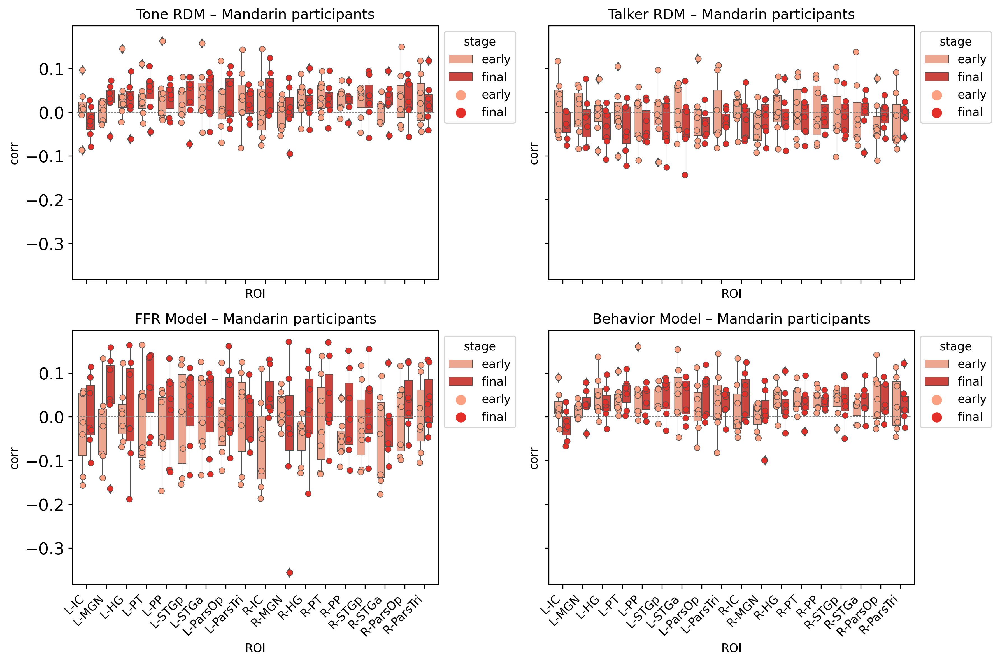

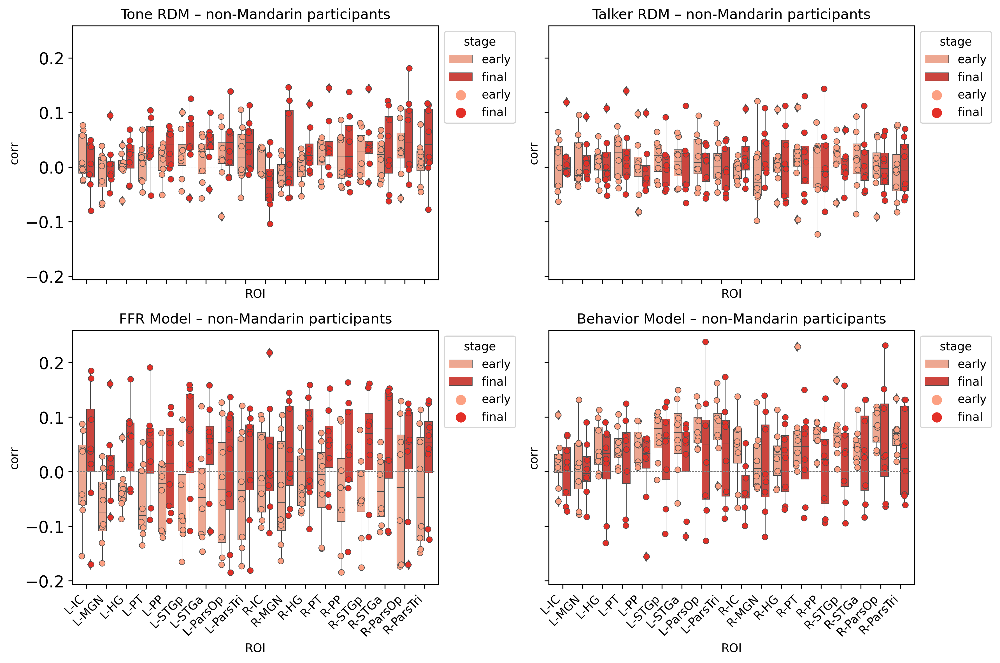

In [196]:

#for model_id in model_names:
for group_id in np.unique(group_rdms.rdm_descriptors['group']):
    fig, ax = plt.subplots(2,2, figsize=(12,8), dpi=300, sharex=True, sharey=True)
    ax = ax.flatten()
    
    for mx, model_id in enumerate(model_names):
        group_df = model_long_df.where(model_long_df.participant_group==group_id).where(model_long_df.model==model_id)

        sns.boxplot(data=group_df, 
                    x='ROI', y='corr', hue='stage', 
                    palette='Reds', linewidth=0.5, 
                    ax=ax[mx], 
                    order=roi_list_ordered)
        sns.stripplot(data=group_df, 
                      x='ROI', y='corr', hue='stage', 
                      palette='Reds', dodge=True, linewidth=0.5, 
                      ax=ax[mx], 
                      order=roi_list_ordered)
        xmin, xmax = ax[mx].get_xlim()
        ax[mx].hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
        sns.move_legend(ax[mx], "upper left", bbox_to_anchor=(1, 1))
        ax[mx].set_xticklabels(ax[mx].get_xticklabels(), rotation=45, ha='right');
        ax[mx].set_title(f'{model_id} – {group_id} participants');
        #plt.setp(ax[mx].get_xticklabels(), visible=False)
    fig.tight_layout()


In [ ]:
'''
# re-arrange plots by model instead of by group
for model_id in model_names:
    fig, ax = plt.subplots(2,1, figsize=(8,8), dpi=300)
    
    group_id = 'non-Mandarin'
    nman_df = model_long_df.where(model_long_df.participant_group==group_id).where(model_long_df.model==model_id)

    sns.boxplot(data=nman_df, x='ROI', y='corr', hue='stage', palette='Reds', linewidth=0.5, ax=ax[0])
    sns.stripplot(data=nman_df, x='ROI', y='corr', hue='stage', palette='Reds', dodge=True, linewidth=0.5, ax=ax[0])
    xmin, xmax = ax[0].get_xlim()
    ax[0].hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
    sns.move_legend(ax[0], "upper left", bbox_to_anchor=(1, 1))
    ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=45, ha='right');
    ax[0].set_title(f'{model_id} – {group_id} participants');
    plt.setp(ax[0].get_xticklabels(), visible=False)

    group_id = 'Mandarin'
    mand_df = model_long_df.where(model_long_df.participant_group==group_id).where(model_long_df.model==model_id)

    sns.boxplot(data=mand_df, x='ROI', y='corr', hue='stage', palette='Reds', linewidth=0.5, ax=ax[1])
    sns.stripplot(data=mand_df, x='ROI', y='corr', hue='stage', palette='Reds', dodge=True, linewidth=0.5, ax=ax[1])
    sns.move_legend(ax[1], "upper left", bbox_to_anchor=(1, 1))
    ax[1].hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
    ax[1].set_xticklabels(ax[1].get_xticklabels(), rotation=45, ha='right');
    ax[1].set_title(f'{model_id} – {group_id} participants');
'''

In [184]:
from scipy.stats import f_oneway


In [191]:
formula = 'corr ~ stage'
group_id = 'non-Mandarin'
    
print(f'{group_id}-speaking participants - {network_name}')
for model_id in model_names:
    print(f'\n{model_id}')
    
    nman_df = model_long_df.where(model_long_df.participant_group==group_id).where(model_long_df.model==model_id)
    
    model = ols(formula, data=nman_df).fit()
    aov_table = sm.stats.anova_lm(model, typ=2)
    print(aov_table)


non-Mandarin-speaking participants - auditory

Tone RDM
            sum_sq     df         F    PR(>F)
stage     0.020785    1.0  8.852606  0.003177
Residual  0.671486  286.0       NaN       NaN

Talker RDM
            sum_sq     df         F    PR(>F)
stage     0.000004    1.0  0.001579  0.968327
Residual  0.645314  286.0       NaN       NaN

FFR Model
            sum_sq     df          F        PR(>F)
stage     0.340648    1.0  43.657811  1.906707e-10
Residual  2.231564  286.0        NaN           NaN

Behavior Model
            sum_sq     df          F    PR(>F)
stage     0.071599    1.0  16.153421  0.000075
Residual  1.267684  286.0        NaN       NaN


In [192]:
formula = 'corr ~ stage'
group_id = 'Mandarin'

print(f'{group_id}-speaking participants - {network_name}')
for model_id in model_names:
    print(f'\n{model_id}')
    
    mand_df = model_long_df.where(model_long_df.participant_group==group_id).where(model_long_df.model==model_id)
    
    model = ols(formula, data=mand_df).fit()
    aov_table = sm.stats.anova_lm(model, typ=2)
    print(aov_table)


Mandarin-speaking participants - auditory

Tone RDM
            sum_sq     df         F    PR(>F)
stage     0.000823    1.0  0.360124  0.548981
Residual  0.571259  250.0       NaN       NaN

Talker RDM
            sum_sq     df        F    PR(>F)
stage     0.012202    1.0  4.53965  0.034095
Residual  0.671967  250.0      NaN       NaN

FFR Model
            sum_sq     df          F   PR(>F)
stage     0.084854    1.0  10.611071  0.00128
Residual  1.999182  250.0        NaN      NaN

Behavior Model
                sum_sq     df             F    PR(>F)
stage     1.469178e-09    1.0  7.381840e-07  0.999315
Residual  4.975650e-01  250.0           NaN       NaN


In [187]:
import statsmodels.api as sm
from statsmodels.formula.api import ols

In [188]:
model = ols(formula, data=nman_df).fit()
aov_table = sm.stats.anova_lm(model, typ=2)
aov_table

,sum_sq,df,F,PR(>F)
stage,0.071599,1.0,16.153421,0.000075
Residual,1.267684,286.0,NaN,NaN


In [189]:
model = ols(formula, data=mand_df).fit()
aov_table = sm.stats.anova_lm(model, typ=2)
aov_table

,sum_sq,df,F,PR(>F)
stage,1.469178e-09,1.0,7.381840e-07,0.999315
Residual,4.975650e-01,250.0,NaN,NaN


# Run with striatal ROIs

## Define network ROIs

In [198]:
## define ROIs
network_name = 'tian_subcortical_S3' # 'tian_subcortical_S3' # auditory

if network_name == 'auditory':
    roi_list_ordered = [
                'L-IC', 'L-MGN', 'L-HG', 'L-PT',  'L-PP', 'L-STGp', 'L-STGa', 'L-ParsOp', 'L-ParsTri',
                'R-IC', 'R-MGN', 'R-HG', 'R-PT',  'R-PP', 'R-STGp', 'R-STGa', 'R-ParsOp', 'R-ParsTri', 
               ]
elif network_name == 'aud-striatal':
    roi_list_ordered = ['L-Caud', 'L-Put', 'L-IC', 'L-MGN',
                'L-HG', 'L-PP', 'L-PT', 'L-STGa', 'L-STGp', 
                'L-ParsOp', 'L-ParsTri',
                'R-Caud', 'R-Put','R-IC', 'R-MGN',
                'R-HG', 'R-PP', 'R-PT', 'R-STGa', 'R-STGp', 
                'R-ParsOp', 'R-ParsTri',
               ]
elif network_name == 'tian_subcortical_S3':
    roi_list_ordered = [
                'CAU-DA-lh', 'CAU-VA-lh', 'pCAU-lh', 
                'PUT-DA-lh', 'PUT-DP-lh', 'PUT-VA-lh', 'PUT-VP-lh',
                'aGP-lh', 'pGP-lh', 'NAc-core-lh', 'NAc-shell-lh',
                'CAU-DA-rh', 'CAU-VA-rh', 'pCAU-rh', 
                'PUT-DA-rh', 'PUT-DP-rh', 'PUT-VA-rh', 'PUT-VP-rh',
                'aGP-rh', 'pGP-rh', 'NAc-core-rh', 'NAc-shell-rh', 
               ]
    


## Load run-specific subject-specific RDMs

In [199]:
# from `rsa_roi.py`-generated outputs
group_rdm_list = []
for sx, sub_id in enumerate(participant_list): # enumerate(['FLT03']): #
    print(sub_id)
    group_id = group_assignment[sx]

    out_dir = os.path.join(model_dir, 'rsa_roi', network_name)
    sub_fpath = os.path.join(out_dir,
                         f'sub-{sub_id}_{network_name}_{model_desc}_rdms.hdf5')
    sub_rdm = rsatoolbox.rdm.rdms.load_rdm(sub_fpath)
    
    # add the group descriptor to the subject's RDM
    sub_rdm.rdm_descriptors['group'] = [group_id for x in sub_rdm.rdm_descriptors['index']]
    group_rdm_list.append(sub_rdm)
group_rdms = rsatoolbox.rdm.rdms.concat(group_rdm_list)

FLT03
FLT04
FLT05
FLT06
FLT08
FLT09
FLT10
FLT11
FLT12
FLT13
FLT14
FLT15
FLT17
FLT18
FLT19
FLT20
FLT21
FLT22
FLT23
FLT24
FLT25
FLT26
FLT28
FLT30


### Per "stage" (runcombo), per subject

In [200]:
runcombo_dict = {'early': ['run00', 'run01'], 
                 'middle': ['run02', 'run03'], 
                 'final': ['run04','run05']}

#### Load run-specific subject-specific behavioral confusion matrices

In [201]:
beh_mat_dict = {}
for sx, sub_id in enumerate(participant_list): 
    print(sub_id)
    group_id = group_assignment[sx]
    
    sub_beh_dir = os.path.join(deriv_dir, 'behavior', f'sub-{sub_id}')
    
    sub_cm_dict = {}
    sub_cm_list = []
    for rx, run in enumerate(np.unique(group_rdms.rdm_descriptors['run'])):
        sub_run_stim_cm = np.genfromtxt(os.path.join(sub_beh_dir, f'sub-{sub_id}_run-0{rx+1}_stimulus_confusion_matrix.tsv'))
        
        sub_cm_dict[run] = sub_run_stim_cm
        sub_cm_list.append(sub_run_stim_cm)
        
    beh_mat_dict[sub_id] = sub_cm_dict

FLT03
FLT04
FLT05
FLT06
FLT08
FLT09
FLT10
FLT11
FLT12
FLT13
FLT14
FLT15
FLT17
FLT18
FLT19
FLT20
FLT21
FLT22
FLT23
FLT24
FLT25
FLT26
FLT28
FLT30


#### Combine early, middle, and final run behavior RDMs

In [202]:
stage_beh_mat_dict = {}
for sub_id in beh_mat_dict:
    print(sub_id)
    
    sub_dict = {}
    sub_early_mat = np.mean(np.array([beh_mat_dict[sub_id]['run00'], beh_mat_dict[sub_id]['run01']]), axis=0)
    sub_middle_mat = np.mean(np.array([beh_mat_dict[sub_id]['run02'], beh_mat_dict[sub_id]['run03']]), axis=0)
    sub_final_mat = np.mean(np.array([beh_mat_dict[sub_id]['run04'], beh_mat_dict[sub_id]['run05']]), axis=0)
    
    sub_dict['early'] = sub_early_mat
    sub_dict['middle'] = sub_middle_mat
    sub_dict['final'] = sub_final_mat
    
    stage_beh_mat_dict[sub_id] = sub_dict

FLT03
FLT04
FLT05
FLT06
FLT08
FLT09
FLT10
FLT11
FLT12
FLT13
FLT14
FLT15
FLT17
FLT18
FLT19
FLT20
FLT21
FLT22
FLT23
FLT24
FLT25
FLT26
FLT28
FLT30


### Participant-specific across-model comparisons

In [203]:
group_dict = {}

for group_id in np.unique(group_rdms.rdm_descriptors['group']):

    for full_sub_id in sub_group_dict[group_id]:
        sub_id = full_sub_id[4:]
        try:
            ffr_id = str(int(participants_df[participants_df['participant_id'] == full_sub_id]['FFR_id'].values[0]))
            print(f'{sub_id} | ffr_id: {ffr_id}')
        except ValueError:
            print(f'no ffr_id for {sub_id}')
            continue

        sub_dict = {}
        
        # create FFR model from confusion matrix
        try:
            sub_ffr_mat = ffr_conf_mats[ffr_id]
        except KeyError:
            print(f'no FFR for subject {ffr_id}')
            continue
        norm_conf = sub_ffr_mat/np.sum(sub_ffr_mat, axis=1)
        inv_norm_conf = -1 * norm_conf + 1

        ffr_rdm = RDMs(np.array([inv_norm_conf],))
        ffr_model = ModelFixed('FFR Model', rdm=ffr_rdm)

        for runcombo in runcombo_dict:
            # initialize results list
            runcombo_roi_res_dict = {}
            
            # create beh model from confusion matrix
            beh_mat = stage_beh_mat_dict[sub_id][runcombo]
            beh_dis_mat = beh_mat * -1 +1
        
            beh_rdm = RDMs(np.array([beh_dis_mat],))
            beh_model = ModelFixed('Behavior Model', rdm=beh_rdm)
            
            # combine all four models to run concurrently
            all_models = [tone_model, talker_model, ffr_model, beh_model]

            for ROI in np.unique(group_rdms.rdm_descriptors['ROI']):
                if 'GP' not in ROI:
                    print(f'{sub_id} runcombo-{runcombo} ROI-{ROI}')
                    runs = runcombo_dict[runcombo]

                    results_grr = rsatoolbox.inference.eval_fixed(all_models, #ffr_model, 
                                                                  group_rdms.subset('participant', value=sub_id).subset('run',value=runs).subset('ROI',value=ROI),  
                                                                  method='corr',)
                    #print(f'p-value vs. 0: {results_grr.test_zero()[0]:.04f}')
                    runcombo_roi_res_dict[ROI] = results_grr.get_means()#[0]
                    #runcombo_roi_res_dict[ROI] = results_grr

            sub_dict[runcombo] = runcombo_roi_res_dict

        #except:
        #    print(f'no FFR data for {sub_id}')
        group_dict[sub_id] = sub_dict

FLT03 | ffr_id: 2002
FLT03 runcombo-early ROI-CAU-DA-lh
FLT03 runcombo-early ROI-CAU-DA-rh
FLT03 runcombo-early ROI-CAU-VA-lh
FLT03 runcombo-early ROI-CAU-VA-rh
FLT03 runcombo-early ROI-NAc-core-lh
FLT03 runcombo-early ROI-NAc-core-rh
FLT03 runcombo-early ROI-NAc-shell-lh
FLT03 runcombo-early ROI-NAc-shell-rh
FLT03 runcombo-early ROI-PUT-DA-lh
FLT03 runcombo-early ROI-PUT-DA-rh
FLT03 runcombo-early ROI-PUT-DP-lh
FLT03 runcombo-early ROI-PUT-DP-rh
FLT03 runcombo-early ROI-PUT-VA-lh
FLT03 runcombo-early ROI-PUT-VA-rh
FLT03 runcombo-early ROI-PUT-VP-lh
FLT03 runcombo-early ROI-PUT-VP-rh
FLT03 runcombo-early ROI-pCAU-lh
FLT03 runcombo-early ROI-pCAU-rh
FLT03 runcombo-middle ROI-CAU-DA-lh
FLT03 runcombo-middle ROI-CAU-DA-rh
FLT03 runcombo-middle ROI-CAU-VA-lh
FLT03 runcombo-middle ROI-CAU-VA-rh
FLT03 runcombo-middle ROI-NAc-core-lh
FLT03 runcombo-middle ROI-NAc-core-rh
FLT03 runcombo-middle ROI-NAc-shell-lh
FLT03 runcombo-middle ROI-NAc-shell-rh
FLT03 runcombo-middle ROI-PUT-DA-lh
FLT03 run

In [204]:
print(results_grr)

Results for running fixed evaluation for corr on 4 models:

Model          |   Eval ± SEM   | p (against 0) | p (against NC) |
------------------------------------------------------------------
Tone RDM       |  0.011 ± 0.048 |        0.428  |         0.591  |
Talker RDM     | -0.040 ± 0.091 |        0.633  |         0.893  |
FFR Model      |  0.145 ± 0.012 |        0.026  |         0.044  |
Behavior Model | -0.034 ± 0.012 |        0.893  |         0.591  |

p-values are based on uncorrected t-tests


In [205]:
group_df_list = []
for group_id in np.unique(group_rdms.rdm_descriptors['group']):
    print(group_id)
    sub_df_list = []
    
    for full_sub_id in sub_group_dict[group_id]:
        try:
            sub_id = full_sub_id[4:]

            sub_df = pd.DataFrame.from_dict(group_dict[sub_id])
            sub_df['sub_id'] = sub_id
            sub_df_list.append(sub_df)
        except KeyError:
            print(f'not available for {full_sub_id}')

    group_df = pd.concat(sub_df_list)
    group_df.reset_index(inplace=True)
    long_group_df = group_df.melt(value_vars=['early','middle','final'], id_vars='index', value_name='corr', var_name='stage', ignore_index=False)
    long_group_df['participant_group'] = group_id
    long_group_df.rename(columns={"index": "ROI"}, inplace=True)
    
    group_df_list.append(long_group_df)

long_df = pd.concat(group_df_list)

Mandarin
not available for sub-FLT05
not available for sub-FLT17
not available for sub-FLT19
not available for sub-FLT22
not available for sub-FLT23
not available for sub-FLT26
non-Mandarin
not available for sub-FLT20
not available for sub-FLT28
not available for sub-FLT30


In [206]:
# get model names for the models in the RSA operation
model_names = [x.name for x in results_grr.models]
print(model_names)

['Tone RDM', 'Talker RDM', 'FFR Model', 'Behavior Model']


In [207]:
# split the results arrays into single-element columns by model
long_df[model_names] = long_df['corr'].to_list()
long_df.drop('corr', axis='columns', inplace=True) 

In [208]:
long_df

,ROI,stage,participant_group,Tone RDM,Talker RDM,FFR Model,Behavior Model
0,CAU-DA-lh,early,Mandarin,0.035841,0.090843,0.078661,0.021942
1,CAU-DA-rh,early,Mandarin,0.067888,-0.035757,0.108914,0.054554
2,CAU-VA-lh,early,Mandarin,-0.052462,0.094342,0.211733,-0.056194
3,CAU-VA-rh,early,Mandarin,-0.012262,0.092696,0.031682,-0.020055
4,NAc-core-lh,early,Mandarin,0.040135,0.018155,0.056451,0.048642
...,...,...,...,...,...,...,...
139,PUT-VA-rh,final,non-Mandarin,-0.002961,-0.011259,0.114356,-0.065497
140,PUT-VP-lh,final,non-Mandarin,0.014267,-0.038446,0.025546,-0.142849
141,PUT-VP-rh,final,non-Mandarin,0.024422,-0.030956,0.048679,-0.094297
142,pCAU-lh,final,non-Mandarin,0.014293,-0.025803,0.127829,0.025933


In [209]:
# reshape the dataframe again
model_long_df = long_df.melt(value_vars=model_names, 
                             id_vars=['ROI', 'stage', 'participant_group'], 
                             value_name='corr', 
                             var_name='model', 
                             ignore_index=False)

In [210]:
model_long_df

,ROI,stage,participant_group,model,corr
0,CAU-DA-lh,early,Mandarin,Tone RDM,0.035841
1,CAU-DA-rh,early,Mandarin,Tone RDM,0.067888
2,CAU-VA-lh,early,Mandarin,Tone RDM,-0.052462
3,CAU-VA-rh,early,Mandarin,Tone RDM,-0.012262
4,NAc-core-lh,early,Mandarin,Tone RDM,0.040135
...,...,...,...,...,...
139,PUT-VA-rh,final,non-Mandarin,Behavior Model,-0.065497
140,PUT-VP-lh,final,non-Mandarin,Behavior Model,-0.142849
141,PUT-VP-rh,final,non-Mandarin,Behavior Model,-0.094297
142,pCAU-lh,final,non-Mandarin,Behavior Model,0.025933


In [211]:
from scipy import stats

In [212]:
for group_id in np.unique(group_rdms.rdm_descriptors['group']):
    group_long_df = model_long_df.where(model_long_df.participant_group==group_id)
    print(f'\ngroup = {group_id}')
    
    for model_id in model_names:
        print(f'\n{model_id}')
        for runcombo in ['early','final']:
            rc_df = group_long_df.where(group_long_df.stage==runcombo).where(group_long_df.model==model_id)
            print(f'\n{runcombo} runs')

            roi_list = []
            p_vals = []
            t_stats = []

            for roi in np.unique(group_rdms.rdm_descriptors['ROI']):
                if 'GP' not in roi:
                    groi_data = rc_df.where(rc_df.ROI==roi).dropna()['corr']
                    res = stats.ttest_1samp(groi_data, popmean=0)

                    p_vals.append(res.pvalue)
                    t_stats.append(res.statistic)
                    roi_list.append(roi)
            p_vals_adj = stats.false_discovery_control(p_vals)

            print('\nFDR-adjusted statistics')
            for rx, roi in enumerate(roi_list):
                if p_vals_adj[rx] < 0.05:
                    ast = ' *'
                if p_vals_adj[rx] < 0.01:
                    ast = '**'
                else:
                    ast = '  '
                print(f'{ast}t = {t_stats[rx]:.02f} p = {p_vals_adj[rx]:.04f} region = {roi}')

            print('\nunadjusted statistics')
            for rx, roi in enumerate(roi_list):
                if p_vals[rx] < 0.05:
                    ast = ' *'
                if p_vals[rx] < 0.01:
                    ast = '**'
                else:
                    ast = '  '
                print(f'{ast}t = {t_stats[rx]:.02f} p = {p_vals[rx]:.04f} region = {roi}')


group = Mandarin

Tone RDM

early runs

FDR-adjusted statistics
  t = 1.52 p = 0.3544 region = CAU-DA-lh
  t = 2.03 p = 0.3544 region = CAU-DA-rh
  t = 1.59 p = 0.3544 region = CAU-VA-lh
  t = 1.92 p = 0.3544 region = CAU-VA-rh
  t = 0.63 p = 0.6769 region = NAc-core-lh
  t = 0.49 p = 0.6769 region = NAc-core-rh
  t = 0.18 p = 0.8609 region = NAc-shell-lh
  t = -3.29 p = 0.3007 region = NAc-shell-rh
  t = 0.52 p = 0.6769 region = PUT-DA-lh
  t = 1.54 p = 0.3544 region = PUT-DA-rh
  t = 0.80 p = 0.6324 region = PUT-DP-lh
  t = 1.04 p = 0.5046 region = PUT-DP-rh
  t = 0.54 p = 0.6769 region = PUT-VA-lh
  t = 1.38 p = 0.3544 region = PUT-VA-rh
  t = 1.44 p = 0.3544 region = PUT-VP-lh
  t = 1.44 p = 0.3544 region = PUT-VP-rh
  t = 2.32 p = 0.3544 region = pCAU-lh
  t = 1.83 p = 0.3544 region = pCAU-rh

unadjusted statistics
  t = 1.52 p = 0.1792 region = CAU-DA-lh
  t = 2.03 p = 0.0884 region = CAU-DA-rh
  t = 1.59 p = 0.1638 region = CAU-VA-lh
  t = 1.92 p = 0.1030 region = CAU-VA-rh
  t

In [213]:
# early vs. late runs

for group_id in np.unique(group_rdms.rdm_descriptors['group']):

    print(f'\ngroup = {group_id}')
    print(f'\nearly vs. late runs')
    
    group_long_df = model_long_df.where(model_long_df.participant_group==group_id)
    print(f'\ngroup = {group_id}')
    
    for model_id in model_names:
        print(f'\n{model_id}')
        roi_list = []
        p_vals = []
        t_stats = []

        early_df = group_long_df.where(group_long_df.stage=='early').where(group_long_df.model==model_id)
        final_df = group_long_df.where(group_long_df.stage=='final').where(group_long_df.model==model_id)


        for roi in np.unique(group_rdms.rdm_descriptors['ROI']):
            if 'GP' not in roi:
                early_data = early_df.where(early_df.ROI==roi).dropna()['corr']
                final_data = final_df.where(final_df.ROI==roi).dropna()['corr']

                res = stats.ttest_rel(final_data, early_data)

                p_vals.append(res.pvalue)
                t_stats.append(res.statistic)
                roi_list.append(roi)
        p_vals_adj = stats.false_discovery_control(p_vals)

        print('\nFDR-adjusted statistics')
        for rx, roi in enumerate(roi_list):
            if p_vals_adj[rx] < 0.05:
                ast = ' *'
            if p_vals_adj[rx] < 0.01:
                ast = '**'
            else:
                ast = '  '
            print(f'{ast}t = {t_stats[rx]:.02f} p = {p_vals_adj[rx]:.04f} region = {roi}')

        print('\nunadjusted statistics')
        for rx, roi in enumerate(roi_list):
            if p_vals[rx] < 0.05:
                ast = ' *'
            if p_vals[rx] < 0.01:
                ast = '**'
            else:
                ast = '  '
            print(f'{ast}t = {t_stats[rx]:.02f} p = {p_vals[rx]:.04f} region = {roi}')


group = Mandarin

early vs. late runs

group = Mandarin

Tone RDM

FDR-adjusted statistics
  t = -0.33 p = 0.9920 region = CAU-DA-lh
  t = -0.90 p = 0.9920 region = CAU-DA-rh
  t = -0.34 p = 0.9920 region = CAU-VA-lh
  t = -0.51 p = 0.9920 region = CAU-VA-rh
  t = 1.83 p = 0.9920 region = NAc-core-lh
  t = -0.06 p = 0.9920 region = NAc-core-rh
  t = 0.93 p = 0.9920 region = NAc-shell-lh
  t = 2.38 p = 0.9846 region = NAc-shell-rh
  t = 0.03 p = 0.9920 region = PUT-DA-lh
  t = -0.55 p = 0.9920 region = PUT-DA-rh
  t = -0.45 p = 0.9920 region = PUT-DP-lh
  t = 0.01 p = 0.9920 region = PUT-DP-rh
  t = 0.29 p = 0.9920 region = PUT-VA-lh
  t = -0.42 p = 0.9920 region = PUT-VA-rh
  t = -0.82 p = 0.9920 region = PUT-VP-lh
  t = 0.17 p = 0.9920 region = PUT-VP-rh
  t = -0.85 p = 0.9920 region = pCAU-lh
  t = -0.75 p = 0.9920 region = pCAU-rh

unadjusted statistics
  t = -0.33 p = 0.7544 region = CAU-DA-lh
  t = -0.90 p = 0.4027 region = CAU-DA-rh
  t = -0.34 p = 0.7423 region = CAU-VA-lh
  t 

In [214]:
model_long_df.reset_index(inplace=True)

In [215]:
model_long_df.drop(model_long_df[model_long_df.stage=='middle'].index, inplace=True)

/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/seaborn/categorical.py:1143: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  hue_mask = self.plot_hues[i] == hue_level
/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/seaborn/categorical.py:1143: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  hue_mask = self.plot_hues[i] == hue_level
/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/seaborn/categorical.py:1143: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  hue_mask = self.plot_hues[i] == hue_level
/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/seaborn/categorical.py:1143: FutureWarning: elementwise com

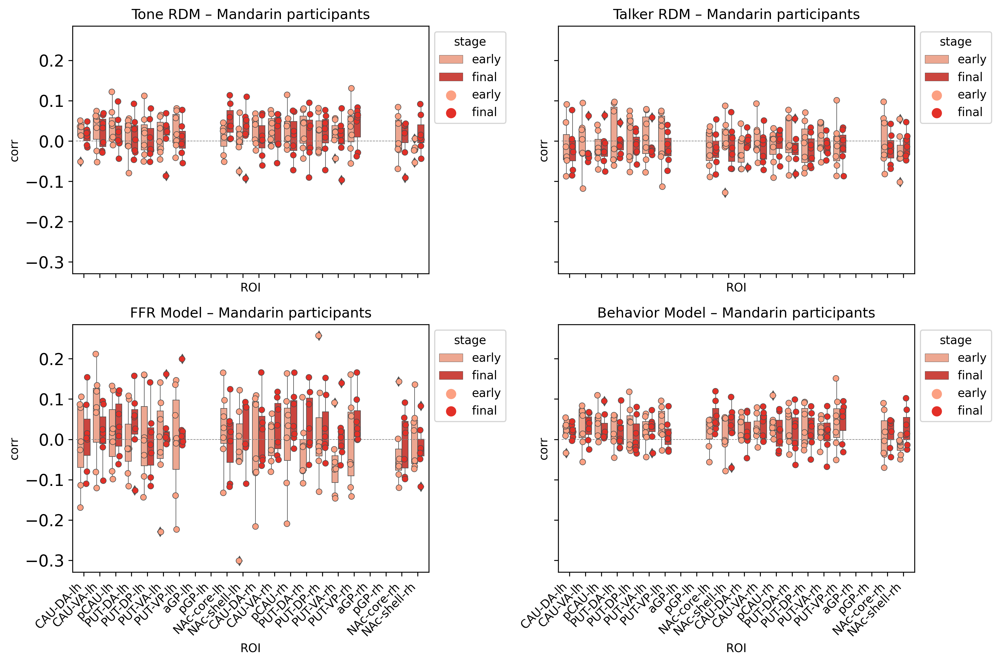

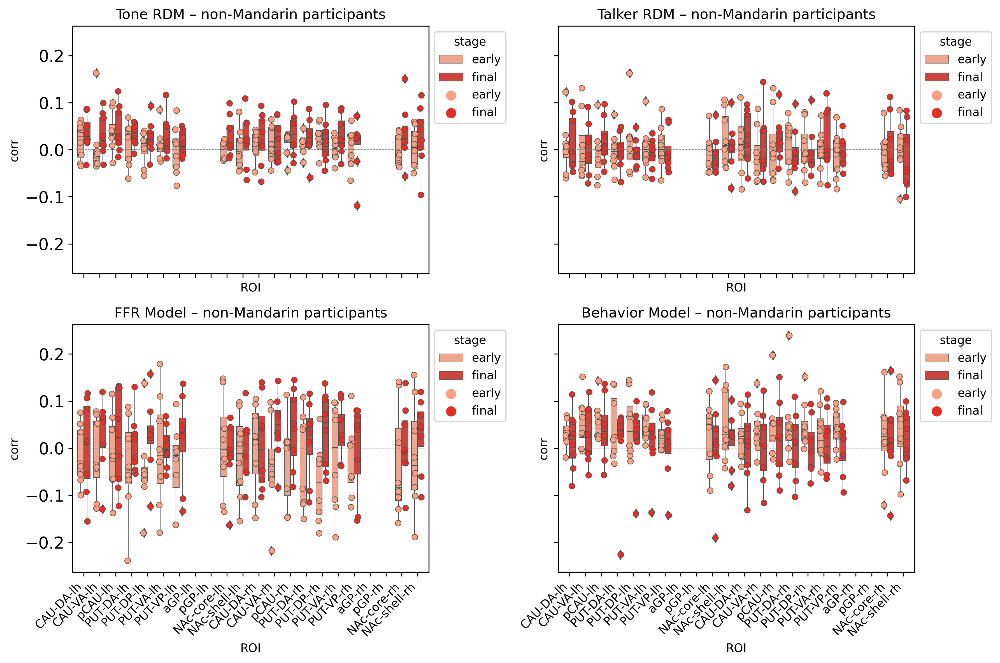

In [216]:

#for model_id in model_names:
for group_id in np.unique(group_rdms.rdm_descriptors['group']):
    fig, ax = plt.subplots(2,2, figsize=(12,8), dpi=300, sharex=True, sharey=True)
    ax = ax.flatten()
    
    for mx, model_id in enumerate(model_names):
        group_df = model_long_df.where(model_long_df.participant_group==group_id).where(model_long_df.model==model_id)

        sns.boxplot(data=group_df, 
                    x='ROI', y='corr', hue='stage', 
                    palette='Reds', linewidth=0.5, 
                    ax=ax[mx], 
                    order=roi_list_ordered)
        sns.stripplot(data=group_df, 
                      x='ROI', y='corr', hue='stage', 
                      palette='Reds', dodge=True, linewidth=0.5, 
                      ax=ax[mx], 
                      order=roi_list_ordered)
        xmin, xmax = ax[mx].get_xlim()
        ax[mx].hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
        sns.move_legend(ax[mx], "upper left", bbox_to_anchor=(1, 1))
        ax[mx].set_xticklabels(ax[mx].get_xticklabels(), rotation=45, ha='right');
        ax[mx].set_title(f'{model_id} – {group_id} participants');
        #plt.setp(ax[mx].get_xticklabels(), visible=False)
    fig.tight_layout()


In [217]:
from scipy.stats import f_oneway
import statsmodels.api as sm
from statsmodels.formula.api import ols

In [218]:
formula = 'corr ~ stage'
group_id = 'non-Mandarin'
    
print(f'{group_id}-speaking participants')
for model_id in model_names:
    print(f'\n{model_id}')
    
    nman_df = model_long_df.where(model_long_df.participant_group==group_id).where(model_long_df.model==model_id)
    
    model = ols(formula, data=nman_df).fit()
    aov_table = sm.stats.anova_lm(model, typ=2)
    print(aov_table)


non-Mandarin-speaking participants

Tone RDM
            sum_sq     df          F    PR(>F)
stage     0.020455    1.0  12.067482  0.000593
Residual  0.484792  286.0        NaN       NaN

Talker RDM
                sum_sq     df         F    PR(>F)
stage     2.664226e-07    1.0  0.000101  0.991974
Residual  7.516865e-01  286.0       NaN       NaN

FFR Model
            sum_sq     df          F    PR(>F)
stage     0.132744    1.0  18.285401  0.000026
Residual  2.076236  286.0        NaN       NaN

Behavior Model
            sum_sq     df          F    PR(>F)
stage     0.047039    1.0  11.525328  0.000784
Residual  1.167272  286.0        NaN       NaN


In [219]:
model = ols(formula, data=nman_df).fit()
aov_table = sm.stats.anova_lm(model, typ=2)
aov_table

,sum_sq,df,F,PR(>F)
stage,0.047039,1.0,11.525328,0.000784
Residual,1.167272,286.0,NaN,NaN


In [220]:
formula = 'corr ~ stage'
group_id = 'Mandarin'

print(f'{group_id}-speaking participants')
for model_id in model_names:
    print(f'\n{model_id}')
    
    mand_df = model_long_df.where(model_long_df.participant_group==group_id).where(model_long_df.model==model_id)
    
    model = ols(formula, data=mand_df).fit()
    aov_table = sm.stats.anova_lm(model, typ=2)
    print(aov_table)


Mandarin-speaking participants

Tone RDM
            sum_sq     df         F   PR(>F)
stage     0.000127    1.0  0.061708  0.80402
Residual  0.514130  250.0       NaN      NaN

Talker RDM
            sum_sq     df        F    PR(>F)
stage     0.006433    1.0  3.00591  0.084194
Residual  0.535054  250.0      NaN       NaN

FFR Model
            sum_sq     df         F    PR(>F)
stage     0.037813    1.0  4.837431  0.028764
Residual  1.954168  250.0       NaN       NaN

Behavior Model
            sum_sq     df         F    PR(>F)
stage     0.000015    1.0  0.008558  0.926369
Residual  0.435730  250.0       NaN       NaN


In [221]:
model = ols(formula, data=mand_df).fit()
aov_table = sm.stats.anova_lm(model, typ=2)
aov_table

,sum_sq,df,F,PR(>F)
stage,0.000015,1.0,0.008558,0.926369
Residual,0.435730,250.0,NaN,NaN


# ARCHIVE

### [DO NOT RUN - FILES CURRENTLY MISSING/REANALYZED] Stimulus RDMs

In [8]:
stim_rdm_dir = os.path.abspath('/bgfs/bchandrasekaran/ngg12/16tone/analysis_scripts/RDMs_kevin')

In [ ]:
glob(stim_rdm_dir+'/STIM*')

In [ ]:
stim_rdm_files = sorted(glob(stim_rdm_dir+'/STIM*PCA*'))
n_rdms = len(stim_rdm_files)
stim_rdms_name_list = []
stim_rdms_array = np.zeros((n_rdms, 16, 16))
for i, fpath in enumerate(stim_rdm_files):
    rdm_name = os.path.basename(fpath)[5:-4]
    print(rdm_name)
    stim_rdm_data = np.genfromtxt(fpath, delimiter=',', skip_header=1)
    try:
        stim_rdms_array[i] = stim_rdm_data
        stim_rdms_name_list.append(rdm_name)
    except ValueError:
        # some of the DSMs are 4x4 instead of 16x16
        # so skip them
        continue

In [11]:
stim_rdms_array.shape

(6, 16, 16)

In [12]:
stim_rdms = RDMs(stim_rdms_array,
                  rdm_descriptors={'stimulus_model':stim_rdms_name_list,},
                  pattern_descriptors=pattern_descriptors,
                  dissimilarity_measure='Euclidean'
                  )

In [ ]:
fig, axs = plt.subplots(2, 3, figsize=(8,5), dpi=200)
for dx, descrip in enumerate(stim_rdms.rdm_descriptors['stimulus_model']):
    spec_rdms = stim_rdms.subset('stimulus_model', descrip)
    show_rdm_panel(spec_rdms, ax=axs.flat[dx], rdm_descriptor='stimulus_model', cmap='inferno',)


#### Convert to models

In [14]:
stim_models = []
for dx, descrip in enumerate(stim_rdms.rdm_descriptors['stimulus_model']):
    spec_model = ModelFixed( '{} RDM'.format(descrip), stim_rdms.subset('stimulus_model', descrip))
    stim_models.append(spec_model)

### [DO NOT RUN - FILES CURRENTLY MISSING/REANALYZED] FFR RDMs

In [15]:
# start with grand average FFR
print('loading FFR dissimilarity matrix')
ffr_rdm_fpath = os.path.join(stim_rdm_dir, 'FFRdistancesgrandavg.csv')
rdm_name = 'FFR_grandavg'
ffr_rdm_data = np.genfromtxt(fpath, delimiter=',', skip_header=1)
print(len(ffr_rdm_data))

# input array needs to be 3-dimensional, despite docs saying 2-D is ok
# (thus the newaxis)
ffr_rdm = RDMs(ffr_rdm_data[np.newaxis,:,:],
               rdm_descriptors={'FFR model': rdm_name},
               pattern_descriptors=pattern_descriptors,
               dissimilarity_measure='Euclidean')
ffr_model = ModelFixed('FFR model', ffr_rdm)

ffr_models = [ffr_model]
    

loading FFR dissimilarity matrix
16


In [ ]:
show_rdm(ffr_rdm, cmap='inferno',)

## [DO NOT RUN – ARCHIVE] Generate run-specific RDMs (NOW RUN WITH RSA_ROI.PY)

#### Generate group RDMs

In [ ]:
group_rdm_list = []
for sx, sub_id in enumerate(participant_list):
    print(sub_id)
    group_id = group_assignment[sx]

    # set this path to wherever you saved the folder containing the img-files
    model_folder = os.path.join(model_dir, 'masked_statmaps',
                               'sub-{}'.format(sub_id),
                               'statmaps_masked',
                               'stimulus_per_run_LSS')
    for runx, data_folder in enumerate(sorted(glob('{}/run*'.format(model_folder)))):
        #print(data_folder)
        
        #mask_list = np.unique([os.path.basename(x).split('_')[2] for x in all_im_paths])

        all_mask_data = []
        for mx, mask_descrip in enumerate(roi_list):

            #print(mask_descrip)
            image_paths = sorted(glob('{}/mask-{}/*_cond-*_map-{}.csv'.format(data_folder, mask_descrip, statmap)))

            try:
                n_vox = np.genfromtxt(image_paths[0]).shape[0]
            except IndexError:
                n_vox = 1

            data = np.zeros((len(image_paths), n_vox))
            for x, im in enumerate(image_paths):
                data[x] = np.genfromtxt(im)
            all_mask_data.append(data)

            roi_rdms = []
        for rx, mask_data in enumerate(all_mask_data):
            dataset = rsatoolbox.data.Dataset(mask_data, 
                                              descriptors={'participant': sub_id, 
                                                           'run': os.path.basename(data_folder),
                                                           'ROI': roi_list[rx], 
                                                           'group': group_id
                                                          },)
            test_rdm = rsatoolbox.rdm.calc_rdm(dataset)
            roi_rdms.append(test_rdm)
            group_rdm_list.append(test_rdm)

        concat_rdms = rsatoolbox.rdm.rdms.concat(roi_rdms)
group_rdms = rsatoolbox.rdm.rdms.concat(group_rdm_list)

In [ ]:
group_rdm_list

In [ ]:
test_rdm

In [35]:
group_rdms.pattern_descriptors = pattern_descriptors

In [56]:
group_rdms.save('group_run_LSS_rdms.hdf5', file_type='hdf5', overwrite=True)

#### Load pre-saved run-specific RDMs

In [35]:
group_rdms = rsatoolbox.rdm.rdms.load_rdm('group_run_LSS_rdms.hdf5')

## [ARCHIVE] Run-specific RSA

### Create group-mean RDMs

In [25]:
mean_rdms_mand_list = []
mean_rdms_nman_list = []
for runx, run in enumerate(np.unique(group_rdms.rdm_descriptors['run'])):
    for rx, roi in enumerate(roi_list):
        # Mandarin-speaking
        dissim_mand = group_rdms.subset('group', value='Mandarin').subset('run', value=run).subset('ROI', value=roi).dissimilarities

        roi_mand = RDMs(dissim_mand.mean(axis=0),
                        rdm_descriptors={'run': run, 'ROI': roi_list[rx], 'group': 'Mandarin'},
                        pattern_descriptors=pattern_descriptors)
        mean_rdms_mand_list.append(roi_mand)

        # non-Mandarin-speaking
        dissim_nman = group_rdms.subset('group', value='non-Mandarin').subset('run', value=run).subset('ROI', value=roi).dissimilarities
        roi_nman = RDMs(dissim_nman.mean(axis=0),
                        rdm_descriptors={'run': run, 'ROI': roi_list[rx], 'group': 'non-Mandarin'},
                        pattern_descriptors=pattern_descriptors)
        mean_rdms_nman_list.append(roi_nman)

mean_rdms_mand = rsatoolbox.rdm.rdms.concat(mean_rdms_mand_list)
mean_rdms_nman = rsatoolbox.rdm.rdms.concat(mean_rdms_nman_list)



In [26]:
mean_rdms_mand

rsatoolbox.rdm.RDMs(
dissimilarity_measure = 
None
dissimilarities = 
[[1.79559562 1.85987127 1.44008664 ... 2.03217626 2.13648545 1.78558371]
 [2.13960337 1.93413196 1.65211813 ... 2.53605299 2.26584816 2.36121041]
 [2.25672361 2.08204578 1.87461425 ... 2.10008194 2.11558743 2.12260766]
 ...
 [2.32496597 2.24698125 2.33635625 ... 1.973868   2.3184011  2.05239057]
 [2.47460807 2.41258482 2.45276991 ... 2.16965667 2.36265713 2.07016866]
 [2.48002883 2.33859697 2.49014896 ... 2.07384879 2.37162237 1.98952845]]
descriptors = 
{}
rdm_descriptors = 
{'run': ['run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02',

#### plot data RDMs

In [ ]:
n_mand = len(sub_group_dict['Mandarin'])

fig = plt.figure(constrained_layout=True, figsize=(20,10), dpi=300)
fig.suptitle('Mandarin (n = {}) mean RDMs by run and ROI'.format(n_mand))

subfigs = fig.subfigures(nrows=6, ncols=1)


for sf, run in enumerate(np.unique(group_rdms.rdm_descriptors['run'])):
    subfigs[sf].suptitle(run)

    axs = subfigs[sf].subplots(nrows=1, ncols=len(roi_list))
    for rx, roi in enumerate(roi_list):
        rsatoolbox.vis.show_rdm_panel(mean_rdms_mand.subset('run', value=run).subset('ROI', value=roi), 
                                      rdm_descriptor='ROI', 
                                      cmap='inferno', 
                                      ax=axs[rx])

In [ ]:
n_nman = len(sub_group_dict['non-Mandarin'])

fig = plt.figure(constrained_layout=True, figsize=(20,10), dpi=300)
fig.suptitle('Non-Mandarin (n = {}) mean RDMs by run and ROI'.format(n_nman))

subfigs = fig.subfigures(nrows=6, ncols=1)

for sf, run in enumerate(np.unique(group_rdms.rdm_descriptors['run'])):
    subfigs[sf].suptitle(run)

    axs = subfigs[sf].subplots(nrows=1, ncols=len(roi_list))
    for rx, roi in enumerate(roi_list):
        rsatoolbox.vis.show_rdm_panel(mean_rdms_nman.subset('run', value=run).subset('ROI', value=roi), 
                                      rdm_descriptor='ROI', 
                                      cmap='inferno', 
                                      ax=axs[rx])

In [ ]:
for sf, run in enumerate(np.unique(group_rdms.rdm_descriptors['run'])):
    rsatoolbox.vis.scatter_plot.show_MDS(mean_rdms_nman.subset('run', run), 
                                         rdm_descriptor='ROI',
                                         pattern_descriptor='tone');

### Each run independently

In [27]:
len(group_rdms.get_matrices()[0])

16

In [28]:
len(group_rdms.subset('group', value='Mandarin').subset('run', value='run05'))

234

In [29]:
len(all_models)

2

group-non-Mandarin run-run00 ROI-L-HG
group-non-Mandarin run-run05 ROI-L-HG
group-non-Mandarin run-run00 ROI-L-IC
group-non-Mandarin run-run05 ROI-L-IC
group-non-Mandarin run-run00 ROI-L-MGN
group-non-Mandarin run-run05 ROI-L-MGN
group-non-Mandarin run-run00 ROI-L-PP
group-non-Mandarin run-run05 ROI-L-PP
group-non-Mandarin run-run00 ROI-L-PT
group-non-Mandarin run-run05 ROI-L-PT
group-non-Mandarin run-run00 ROI-L-ParsOp
group-non-Mandarin run-run05 ROI-L-ParsOp
group-non-Mandarin run-run00 ROI-L-ParsTri
group-non-Mandarin run-run05 ROI-L-ParsTri
group-non-Mandarin run-run00 ROI-L-STGa
group-non-Mandarin run-run05 ROI-L-STGa
group-non-Mandarin run-run00 ROI-L-STGp
group-non-Mandarin run-run05 ROI-L-STGp
group-non-Mandarin run-run00 ROI-R-HG
group-non-Mandarin run-run05 ROI-R-HG
group-non-Mandarin run-run00 ROI-R-IC


/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/rsatoolbox/vis/model_plot.py:282: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(12.5, 10))


group-non-Mandarin run-run05 ROI-R-IC
group-non-Mandarin run-run00 ROI-R-MGN
group-non-Mandarin run-run05 ROI-R-MGN
group-non-Mandarin run-run00 ROI-R-PP
group-non-Mandarin run-run05 ROI-R-PP
group-non-Mandarin run-run00 ROI-R-PT
group-non-Mandarin run-run05 ROI-R-PT
group-non-Mandarin run-run00 ROI-R-ParsOp
group-non-Mandarin run-run05 ROI-R-ParsOp
group-non-Mandarin run-run00 ROI-R-ParsTri
group-non-Mandarin run-run05 ROI-R-ParsTri
group-non-Mandarin run-run00 ROI-R-STGa
group-non-Mandarin run-run05 ROI-R-STGa
group-non-Mandarin run-run00 ROI-R-STGp
group-non-Mandarin run-run05 ROI-R-STGp


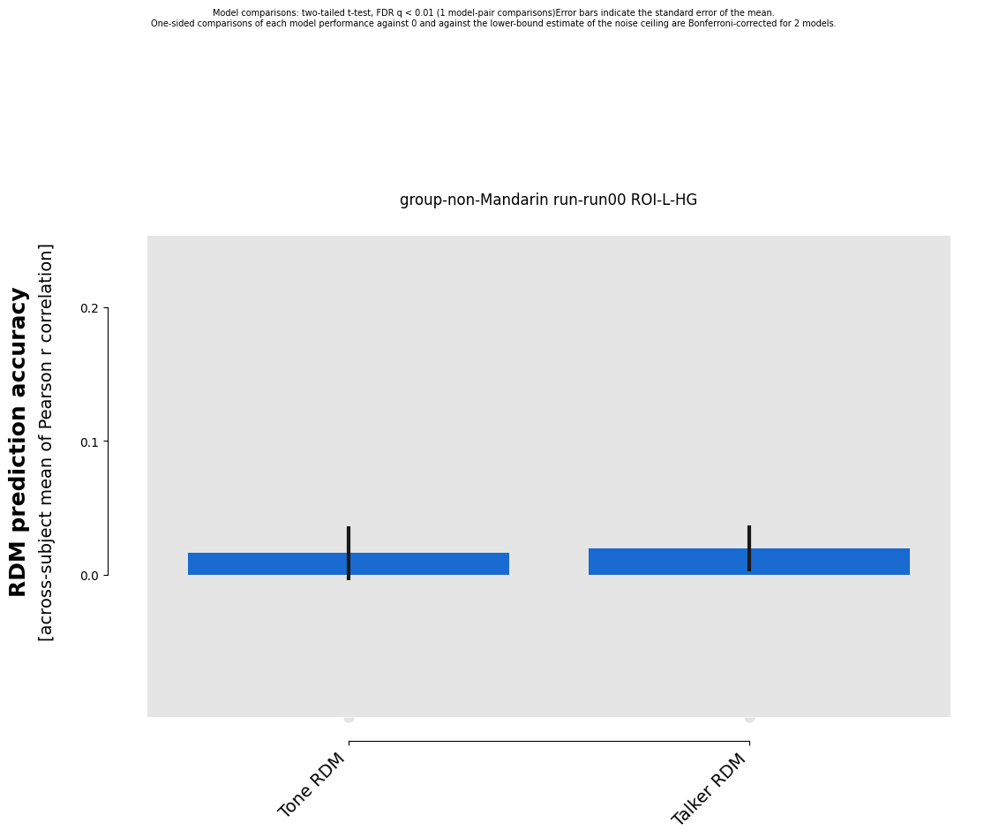

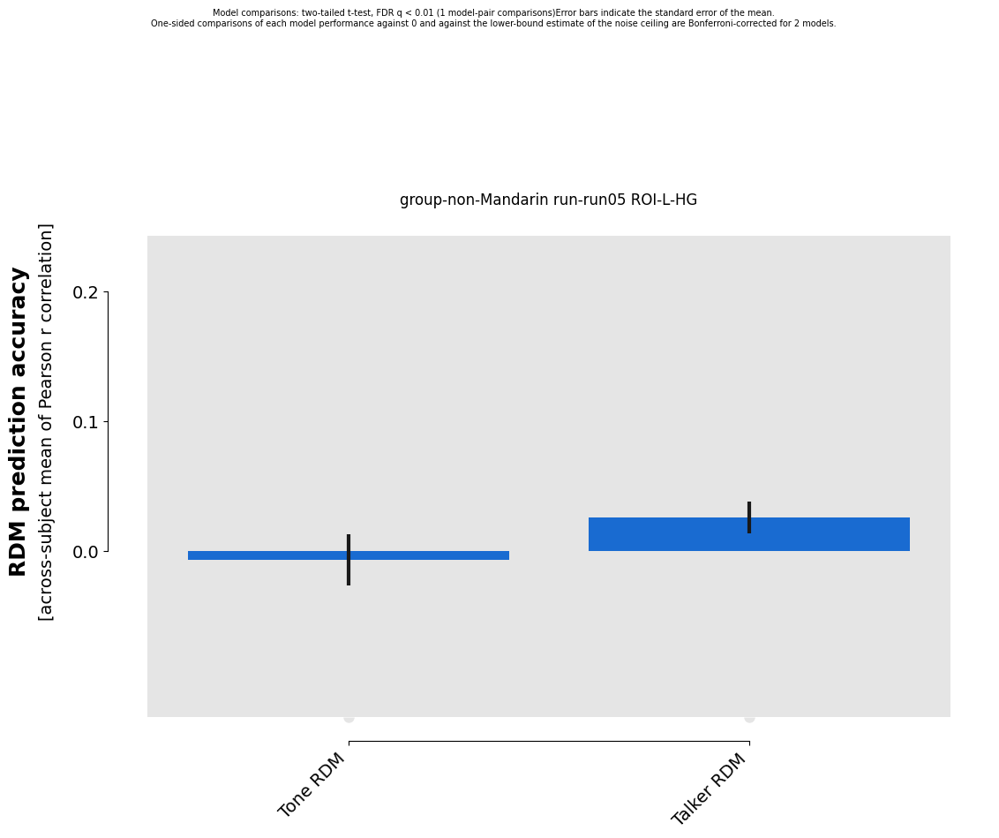

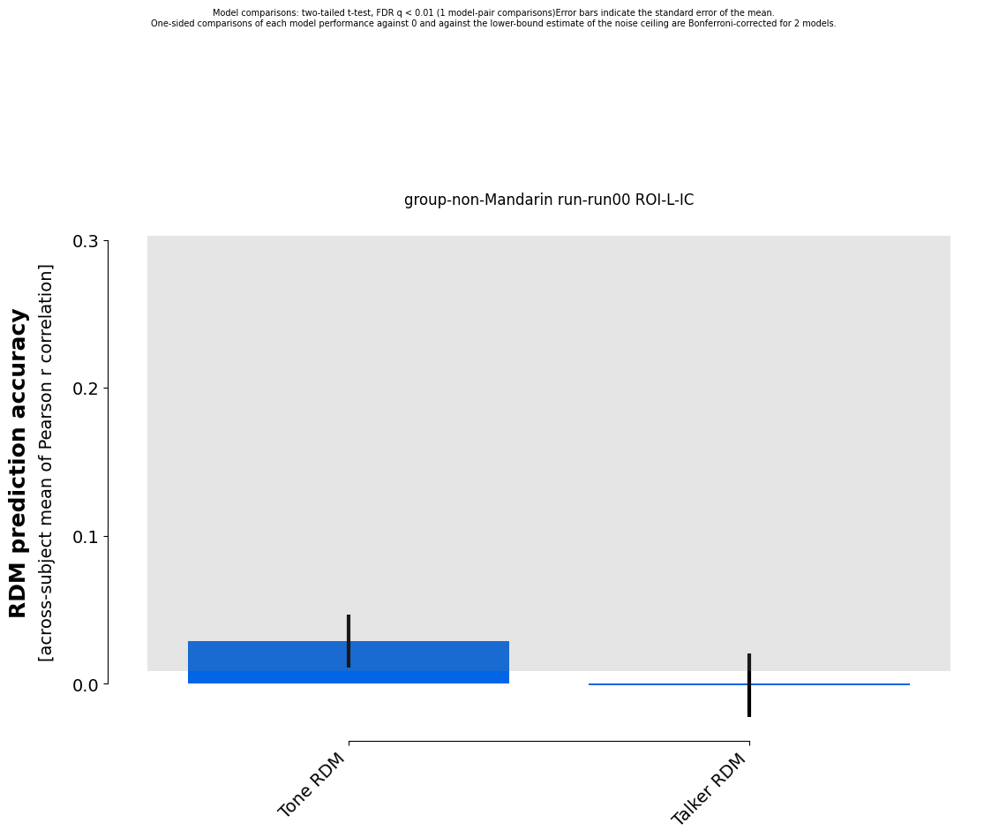

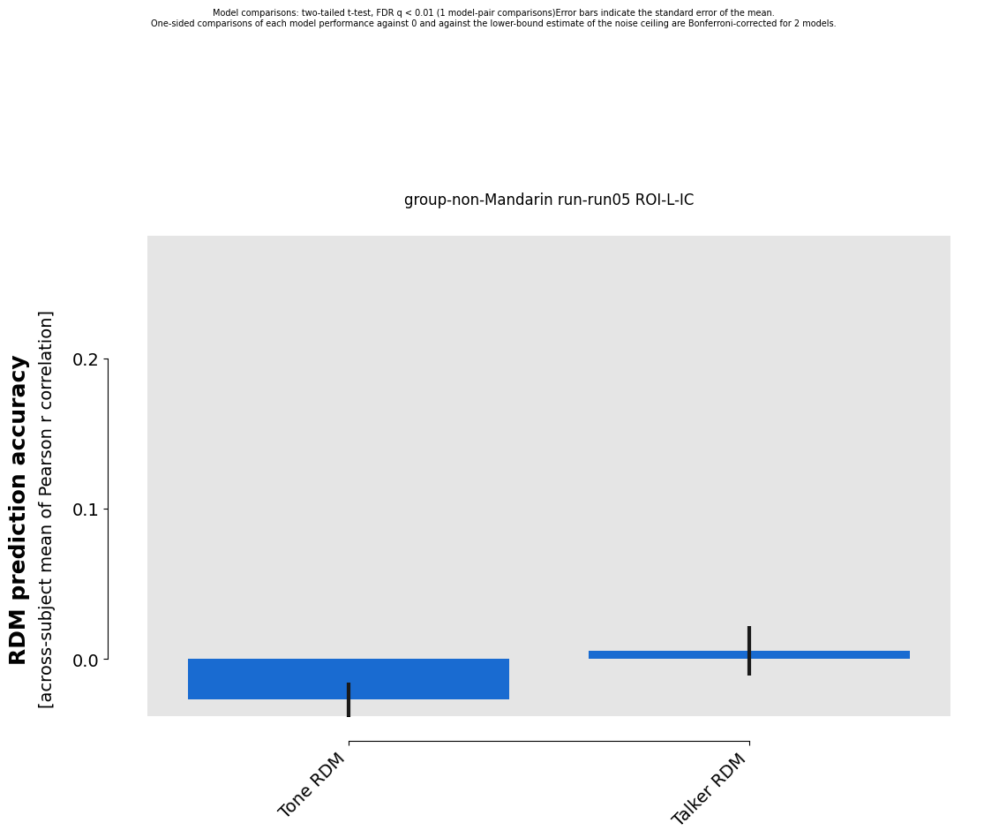

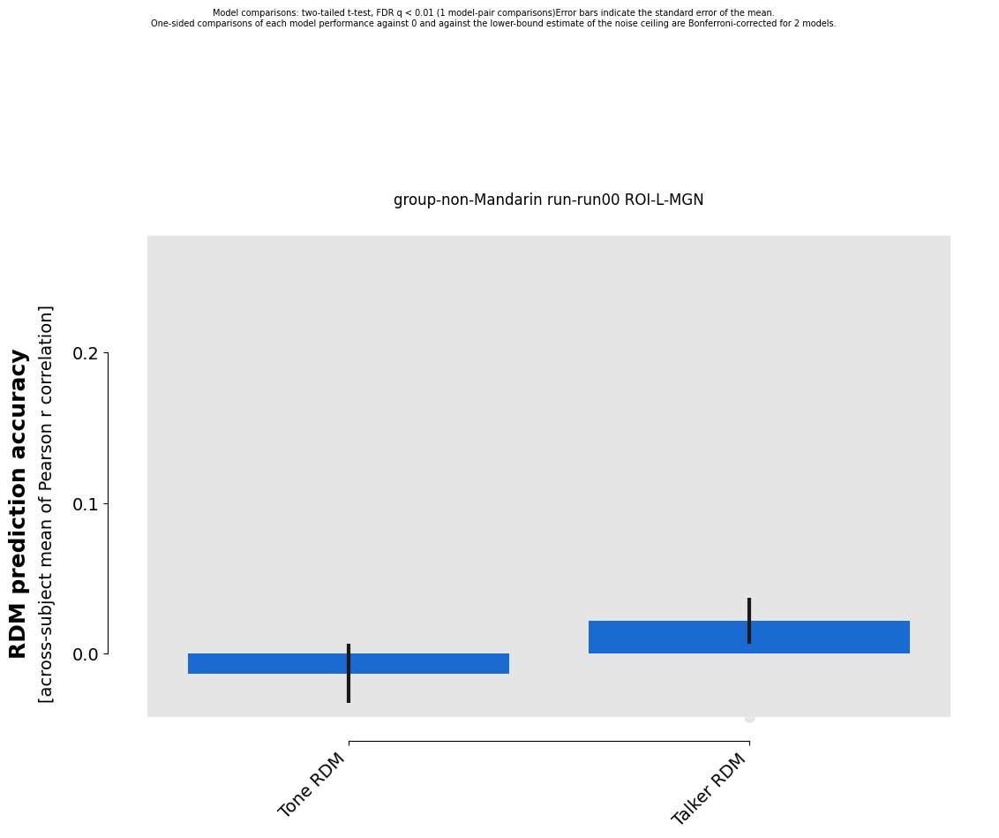

...

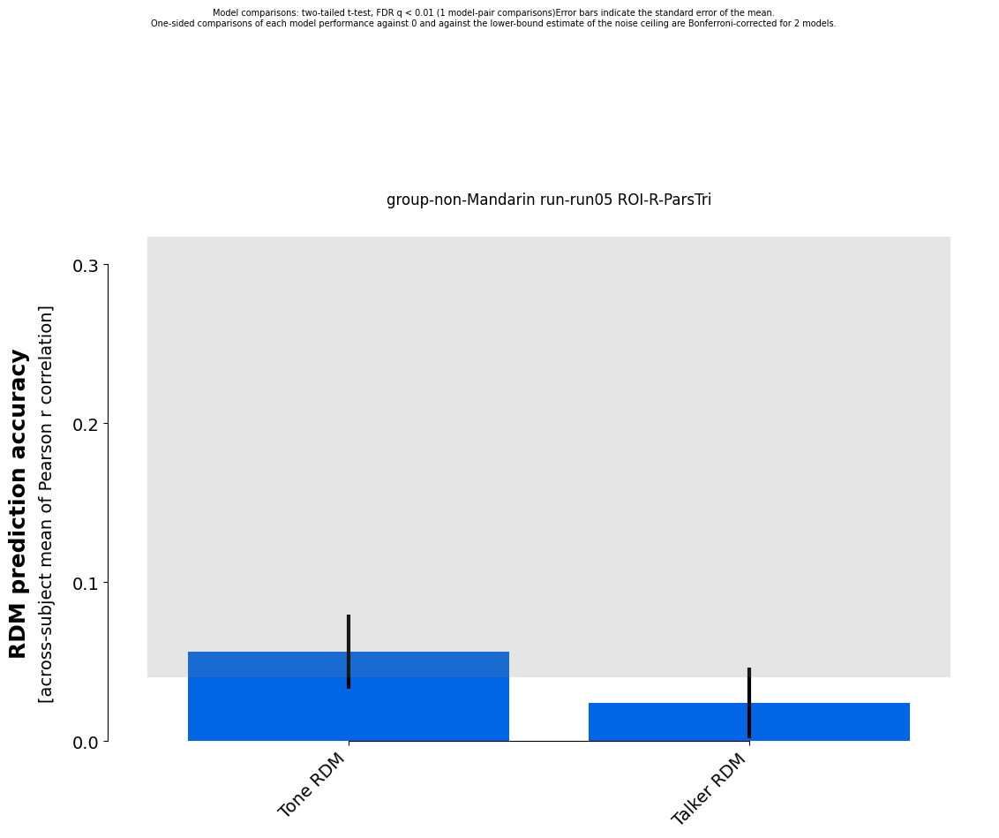

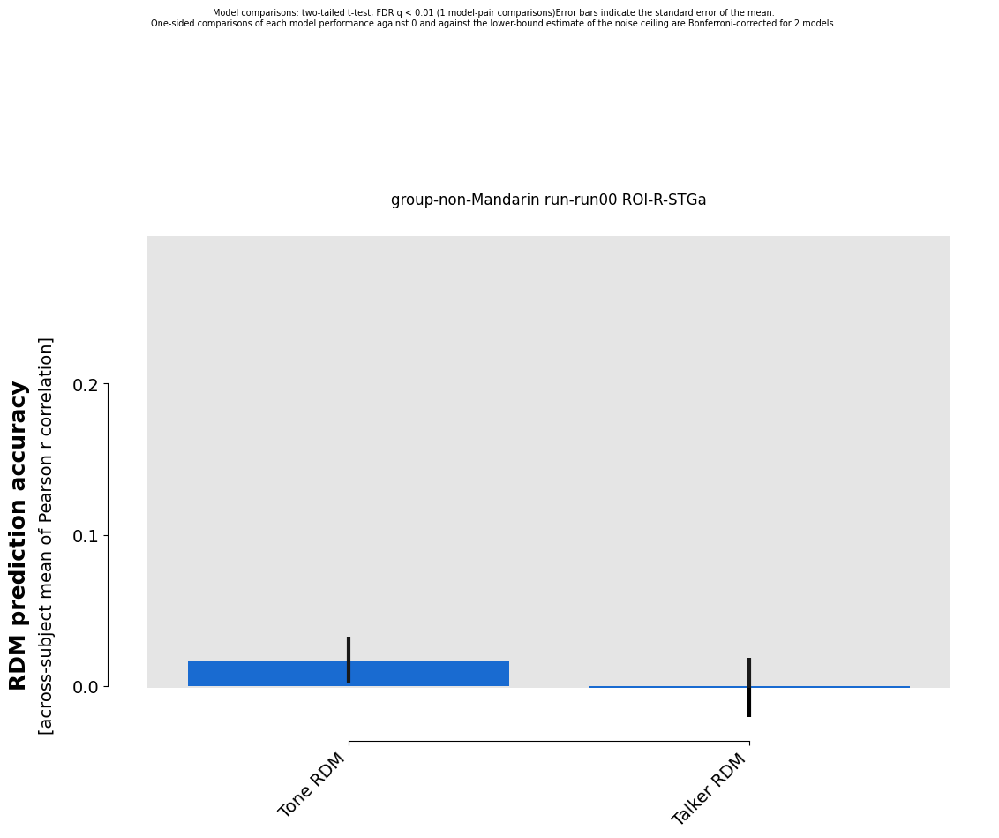

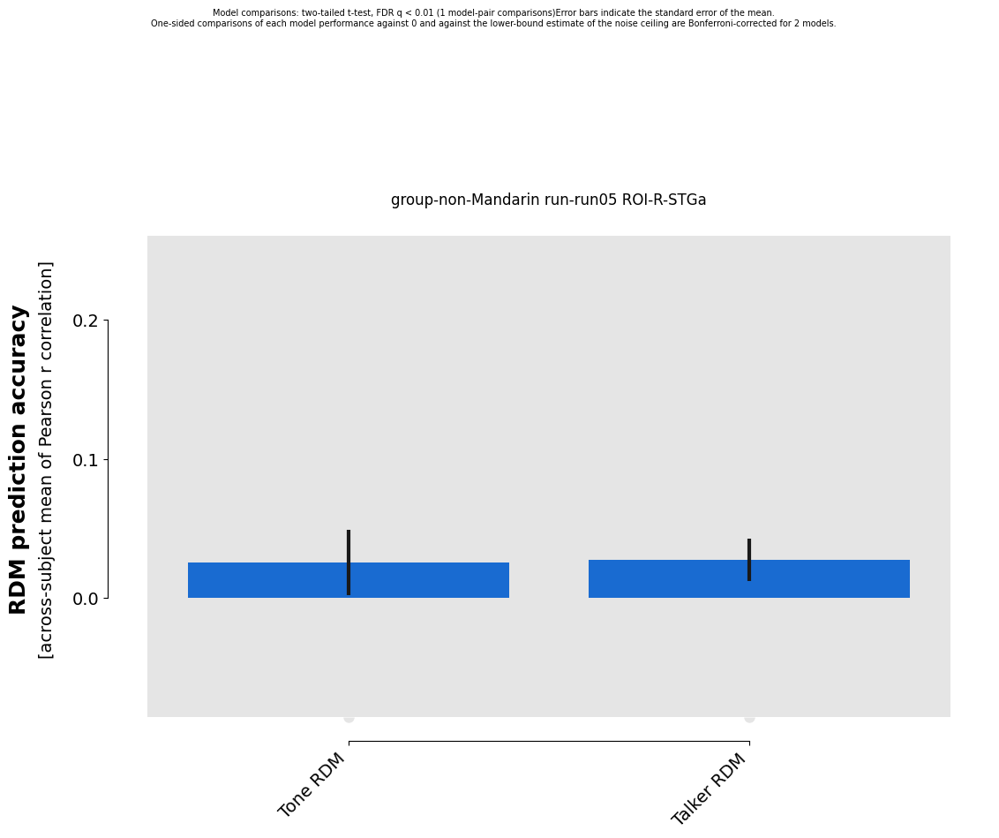

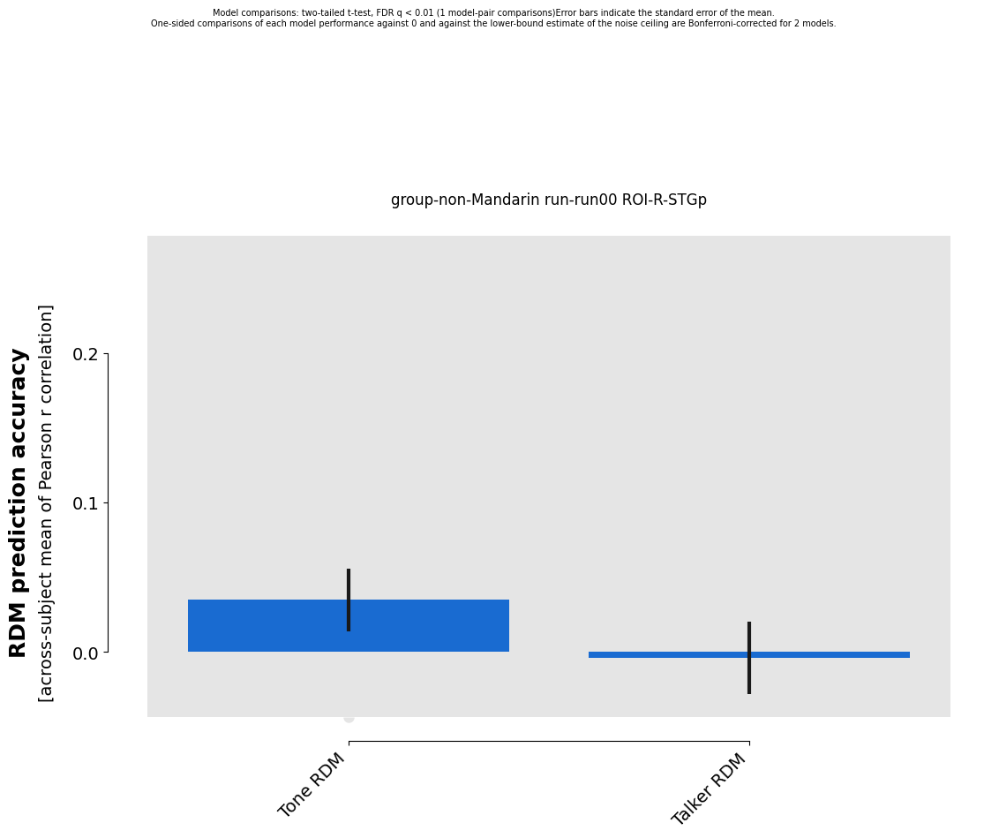

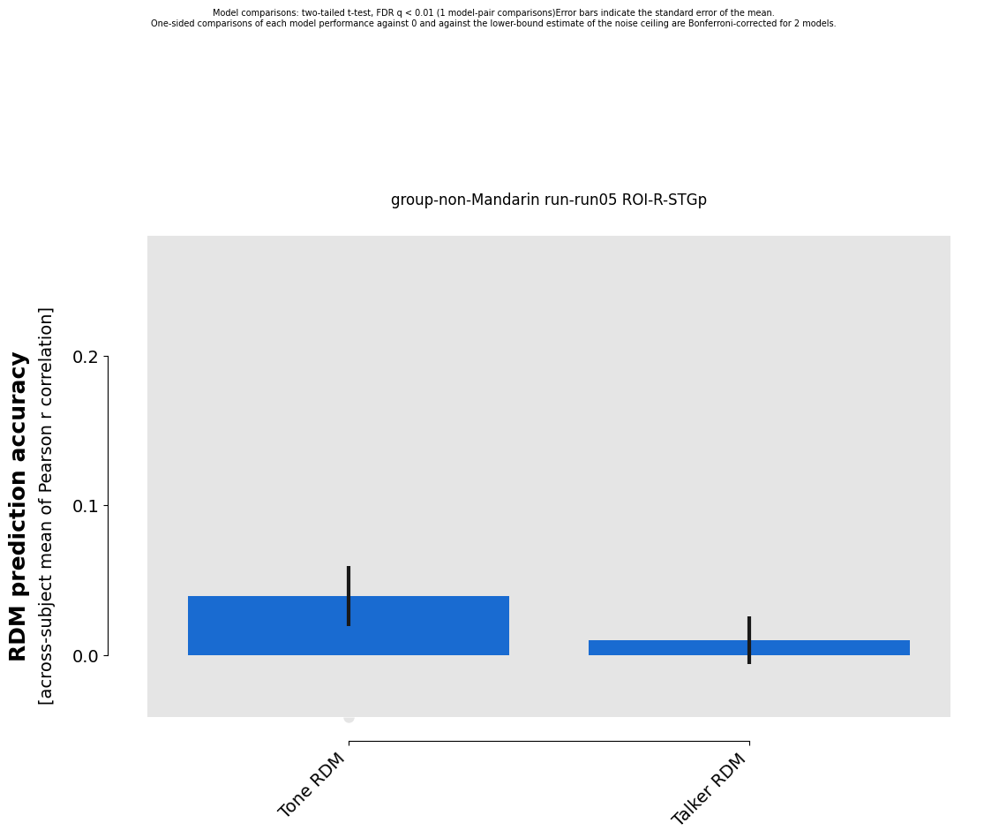

In [30]:
'''
group = 'Mandarin'
run = 'run00'
ROI = 'mask-R-ParsTri'
'''
for group in ['non-Mandarin']:#np.unique(group_rdms.rdm_descriptors['group']):
    #for run in np.unique(group_rdms.rdm_descriptors['run']):
    for ROI in np.unique(group_rdms.rdm_descriptors['ROI']):
        for run in ['run00', 'run05']:
            print(f'group-{group} run-{run} ROI-{ROI}')
            results_grr = rsatoolbox.inference.eval_fixed(all_models, 
                                                          group_rdms.subset('group', value=group).subset('run',value=run).subset('ROI',value=ROI),  
                                                          method='corr',)
            fig, ax1, ax2 = rsatoolbox.vis.plot_model_comparison(results_grr);
            ax1.set_title(f'group-{group} run-{run} ROI-{ROI}');
            ax1.axes.set_xticklabels(ax1.xaxis.get_majorticklabels(), ha="right")

            #results_grr.save(f'results-eval/results-eval_group-{group}_run-{run}_ROI-{ROI}.hdf5',overwrite=True)

In [31]:
print(results_grr)

Results for running fixed evaluation for corr on 2 models:

Model      |   Eval ± SEM   | p (against 0) | p (against NC) |
--------------------------------------------------------------
Tone RDM   |  0.039 ± 0.020 |        0.040  |         0.003  |
Talker RDM |  0.010 ± 0.016 |        0.276  |         0.009  |

p-values are based on uncorrected t-tests


### Run separate RSA for each subject and run

In [ ]:
for sub_id in ['FLT03']: #beh_mat_dict:
    print(sub_id)
    
    for run_id in beh_mat_dict[sub_id]:
        print(run_id)
        
        beh_mat = beh_mat_dict[sub_id][run_id]
        beh_dis_mat = beh_mat * -1 +1
        
        beh_rdm = RDMs(beh_dis_mat,)
        beh_model = ModelFixed('Behavior Model', rdm=beh_rdm)
        
        print(f'sub-{sub_id} {run_id}')
        results_beh = rsatoolbox.inference.eval_fixed(beh_model, 
                                                      group_rdms.subset('run',value=run_id).subset('participant', value=sub_id),  
                                                      method='corr',)
        fig, ax1, ax2 = rsatoolbox.vis.plot_model_comparison(results_grr);
        ax1.set_title(f'group-{group} ROI-{ROI} sub-{sub_id}');
        ax1.axes.set_xticklabels(ax1.xaxis.get_majorticklabels(), ha="right")

### Combine runs 1–2, 3–4, and 5–6

In [27]:
runcombo_dict = {'early': ['run00', 'run01'], 'middle': ['run02', 'run03'], 'final': ['run04','run05']}

In [28]:
runcombo_dict

{'early': ['run00', 'run01'],
 'middle': ['run02', 'run03'],
 'final': ['run04', 'run05']}

In [29]:
for x in runcombo_dict:
    print(runcombo_dict[x])

['run00', 'run01']
['run02', 'run03']
['run04', 'run05']


In [35]:
'''
group = 'Mandarin'
run = 'run00'
ROI = 'mask-R-ParsTri'
'''
for group in ['non-Mandarin']:#np.unique(group_rdms.rdm_descriptors['group']):
    runcombo_res_dict = {}
    for runcombo in runcombo_dict:
        # initialize results list
        runcombo_roi_res_dict = {}
        
        for ROI in np.unique(group_rdms.rdm_descriptors['ROI']):
            if 'GP' not in ROI:
                print(f'group-{group} runcombo-{runcombo} ROI-{ROI}')
                runs = runcombo_dict[runcombo]
                results_grr = rsatoolbox.inference.eval_fixed(all_models, 
                                                              group_rdms.subset('group', value=group).subset('run',value=runs).subset('ROI',value=ROI),  
                                                              method='corr',)
                print(results_grr.test_pairwise())
                runcombo_roi_res_dict[ROI] = results_grr
                
                #fig, ax1, ax2 = rsatoolbox.vis.plot_model_comparison(results_grr);
                #ax1.set_title(f'group-{group} runcombo-{runcombo} ROI-{ROI}');
                #ax1.axes.set_xticklabels(ax1.xaxis.get_majorticklabels(), ha="right")

                #results_grr.save(f'results-eval/results-eval_group-{group}_run-{run}_ROI-{ROI}.hdf5',overwrite=True)
        runcombo_res_dict[runcombo] = runcombo_roi_res_dict

group-non-Mandarin runcombo-early ROI-L-HG
[[1.         0.47819621]
 [0.47819621 1.        ]]
group-non-Mandarin runcombo-early ROI-L-IC
[[1.         0.24061192]
 [0.24061192 1.        ]]
group-non-Mandarin runcombo-early ROI-L-MGN
[[1.         0.68491909]
 [0.68491909 1.        ]]
group-non-Mandarin runcombo-early ROI-L-PP
[[1.        0.1456813]
 [0.1456813 1.       ]]
group-non-Mandarin runcombo-early ROI-L-PT
[[1.         0.33096821]
 [0.33096821 1.        ]]
group-non-Mandarin runcombo-early ROI-L-ParsOp
[[1.         0.52531362]
 [0.52531362 1.        ]]
group-non-Mandarin runcombo-early ROI-L-ParsTri
[[1.         0.19624258]
 [0.19624258 1.        ]]
group-non-Mandarin runcombo-early ROI-L-STGa
[[1.         0.13444548]
 [0.13444548 1.        ]]
group-non-Mandarin runcombo-early ROI-L-STGp
[[1.         0.11994314]
 [0.11994314 1.        ]]
group-non-Mandarin runcombo-early ROI-R-HG
[[1.         0.54283431]
 [0.54283431 1.        ]]
group-non-Mandarin runcombo-early ROI-R-IC
[[1.   

In [37]:
# get the model-vs-model pairwise t-test results
runcombo_res_dict['early']['R-HG'].test_pairwise()[0][1]

0.5428343134009257

In [39]:
#get the mean evaluations
runcombo_res_dict['early']['R-HG'].get_means()

array([0.01402361, 0.00204882])

In [40]:
# as a check, compute the mean evaluations (comes to the same as above)
#'CAU-DA-lh'
np.mean(runcombo_res_dict['early']['R-HG'].evaluations[0,1])

0.0020488234351700857

In [41]:
# see all the values in the evaluations (equal to number of subjects x number of runs in this model)
runcombo_res_dict['early']['R-HG'].evaluations[0][1]

array([-0.01000728,  0.0460764 , -0.03478492,  0.05396415,  0.10243966,
        0.10804536,  0.015302  ,  0.02484771, -0.04130915, -0.09082552,
        0.0247724 , -0.06577297,  0.00174687, -0.01291057,  0.01797668,
       -0.02528725,  0.01809979, -0.01157045,  0.00394744, -0.04126436,
       -0.05539608,  0.01698419])

In [42]:
print(runcombo_res_dict['early']['R-HG'])#['CAU-DA-lh'])

Results for running fixed evaluation for corr on 2 models:

Model      |   Eval ± SEM   | p (against 0) | p (against NC) |
--------------------------------------------------------------
Tone RDM   |  0.014 ± 0.013 |        0.139  |       < 0.001  |
Talker RDM |  0.002 ± 0.010 |        0.424  |       < 0.001  |

p-values are based on uncorrected t-tests


In [63]:
for group in ['non-Mandarin']:
    runcombo_eval_tone_dict = {}
    runcombo_eval_talker_dict = {}
    for runcombo in runcombo_dict:
        runcombo_roi_mean_tone_dict = {}
        runcombo_roi_mean_talker_dict = {}
        for ROI in np.unique(group_rdms.rdm_descriptors['ROI']):
            if 'GP' not in ROI:
            
                print(f'group-{group} runcombo-{runcombo} ROI-{ROI}')
                runs = runcombo_dict[runcombo]
                results_grr = rsatoolbox.inference.eval_fixed(all_models, 
                                                              group_rdms.subset('group', value=group).subset('run',value=runs).subset('ROI',value=ROI),  
                                                              method='corr',)
                runcombo_roi_mean_tone_dict[ROI] = results_grr.get_means()[0]
                runcombo_roi_mean_talker_dict[ROI] = results_grr.get_means()[1]
                #print(results_grr)
                print(f'pairwise t-test: {results_grr.test_pairwise()[0][1]:.04f}')
                print(f'tone t-test ind: {results_grr.test_zero()[0]:.04f}')
                print('\n')
        runcombo_eval_tone_dict[runcombo] = runcombo_roi_mean_tone_dict
        runcombo_eval_talker_dict[runcombo] = runcombo_roi_mean_talker_dict

group-non-Mandarin runcombo-early ROI-L-HG
pairwise t-test: 0.4782
tone t-test ind: 0.1042


group-non-Mandarin runcombo-early ROI-L-IC
pairwise t-test: 0.2406
tone t-test ind: 0.0693


group-non-Mandarin runcombo-early ROI-L-MGN
pairwise t-test: 0.6849
tone t-test ind: 0.5728


group-non-Mandarin runcombo-early ROI-L-PP
pairwise t-test: 0.1457
tone t-test ind: 0.0190


group-non-Mandarin runcombo-early ROI-L-PT
pairwise t-test: 0.3310
tone t-test ind: 0.0180


group-non-Mandarin runcombo-early ROI-L-ParsOp
pairwise t-test: 0.5253
tone t-test ind: 0.0359


group-non-Mandarin runcombo-early ROI-L-ParsTri
pairwise t-test: 0.1962
tone t-test ind: 0.0181


group-non-Mandarin runcombo-early ROI-L-STGa
pairwise t-test: 0.1344
tone t-test ind: 0.0135


group-non-Mandarin runcombo-early ROI-L-STGp
pairwise t-test: 0.1199
tone t-test ind: 0.0035


group-non-Mandarin runcombo-early ROI-R-HG
pairwise t-test: 0.5428
tone t-test ind: 0.1388


group-non-Mandarin runcombo-early ROI-R-IC
pairwise t-te

In [44]:
results_grr.test_zero()

array([0.00062801, 0.54096775])

In [46]:
tone_df = pd.DataFrame.from_dict(runcombo_eval_tone_dict, orient='columns').melt(value_name='mean_eval', var_name='stage', ignore_index=False).reset_index()
tone_df.rename(columns={'index':'ROI'}, inplace=True)
tone_df['model'] = 'tone'

talker_df = pd.DataFrame.from_dict(runcombo_eval_talker_dict, orient='columns').melt(value_name='mean_eval', var_name='stage', ignore_index=False).reset_index()
talker_df.rename(columns={'index':'ROI'}, inplace=True)
talker_df['model'] = 'talker'

model_df = pd.concat([tone_df, talker_df])

In [47]:
model_df

,ROI,stage,mean_eval,model
0,L-HG,early,0.017920,tone
1,L-IC,early,0.020273,tone
2,L-MGN,early,-0.002137,tone
3,L-PP,early,0.029609,tone
4,L-PT,early,0.030334,tone
...,...,...,...,...
49,R-PT,final,0.011740,talker
50,R-ParsOp,final,-0.001535,talker
51,R-ParsTri,final,0.001608,talker
52,R-STGa,final,0.003219,talker


In [48]:
model_df.dtypes

ROI           object
stage         object
mean_eval    float64
model         object
dtype: object

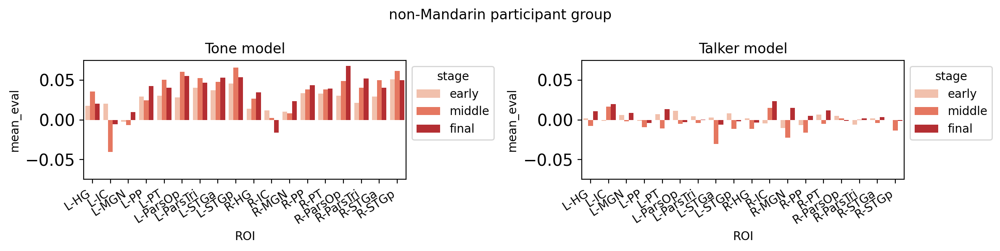

In [60]:
fig, ax = plt.subplots(1,2, figsize=(12,3), dpi=200)
fig.suptitle(f'{group} participant group')
sns.barplot(data=model_df[model_df['model']=='tone'], x='ROI', y='mean_eval', hue='stage', 
            ax=ax[0], palette='Reds',)
sns.barplot(data=model_df[model_df['model']=='talker'], x='ROI', y='mean_eval', hue='stage', 
            ax=ax[1], palette='Reds',)
ax[0].set_title('Tone model')
ax[1].set_title('Talker model')

#ax[0].set_ylim([-.025, .05])
ax[0].set_ylim([-.075, .075])
ax[1].set_ylim([-.075, .075])
ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=33, ha='right')
ax[1].set_xticklabels(ax[0].get_xticklabels(), rotation=33, ha='right')
sns.move_legend(ax[0], "upper left", bbox_to_anchor=(1, 1))
sns.move_legend(ax[1], "upper left", bbox_to_anchor=(1, 1))
fig.tight_layout()

#sns.displot(data=model_df, x='ROI', y='mean_eval', hue='stage', col='model')

In [ ]:
# print(results_grr)

In [55]:
for group in ['non-Mandarin']:
    for runcombo in runcombo_dict:
        #for ROI in np.unique(group_rdms.rdm_descriptors['ROI']):
        #    if 'GP' not in ROI:

        print(f'group-{group} runcombo-{runcombo}')
        runs = runcombo_dict[runcombo]
        results_grr = rsatoolbox.inference.eval_fixed(all_models, 
                                                      group_rdms.subset('group', value=group).subset('run',value=runs),#.subset('ROI',value=ROI),  
                                                      method='corr',)
        #print(results_grr)
        print(f'pairwise t-test: {results_grr.test_pairwise()[0][1]:.04f}')
        print('\n')

group-non-Mandarin runcombo-early
pairwise t-test: 0.0000


group-non-Mandarin runcombo-middle
pairwise t-test: 0.0000


group-non-Mandarin runcombo-final
pairwise t-test: 0.0000




### [ARCHIVE] Combine runs 1–3, 4–6

In [44]:
runcombo_dict = {'firsthalf': ['run00', 'run01', 'run02'], 'secondhalf': ['run03', 'run04','run05']}

In [45]:
runcombo_dict

{'firsthalf': ['run00', 'run01', 'run02'],
 'secondhalf': ['run03', 'run04', 'run05']}

In [46]:
for x in runcombo_dict:
    print(runcombo_dict[x])

['run00', 'run01', 'run02']
['run03', 'run04', 'run05']


group-Mandarin runs-firsthalf CAU-DA-lh
group-Mandarin runs-secondhalf CAU-DA-lh
group-Mandarin runs-firsthalf CAU-DA-rh
group-Mandarin runs-secondhalf CAU-DA-rh
group-Mandarin runs-firsthalf CAU-VA-lh
group-Mandarin runs-secondhalf CAU-VA-lh
group-Mandarin runs-firsthalf CAU-VA-rh
group-Mandarin runs-secondhalf CAU-VA-rh
group-Mandarin runs-firsthalf NAc-core-lh
group-Mandarin runs-secondhalf NAc-core-lh
group-Mandarin runs-firsthalf NAc-core-rh
group-Mandarin runs-secondhalf NAc-core-rh
group-Mandarin runs-firsthalf NAc-shell-lh
group-Mandarin runs-secondhalf NAc-shell-lh
group-Mandarin runs-firsthalf NAc-shell-rh
group-Mandarin runs-secondhalf NAc-shell-rh
group-Mandarin runs-firsthalf PUT-DA-lh
group-Mandarin runs-secondhalf PUT-DA-lh
group-Mandarin runs-firsthalf PUT-DA-rh
group-Mandarin runs-secondhalf PUT-DA-rh
group-Mandarin runs-firsthalf PUT-DP-lh
group-Mandarin runs-secondhalf PUT-DP-lh
group-Mandarin runs-firsthalf PUT-DP-rh
group-Mandarin runs-secondhalf PUT-DP-rh
group-Ma

ValueError: rdm1 and rdm2 have different nan positions

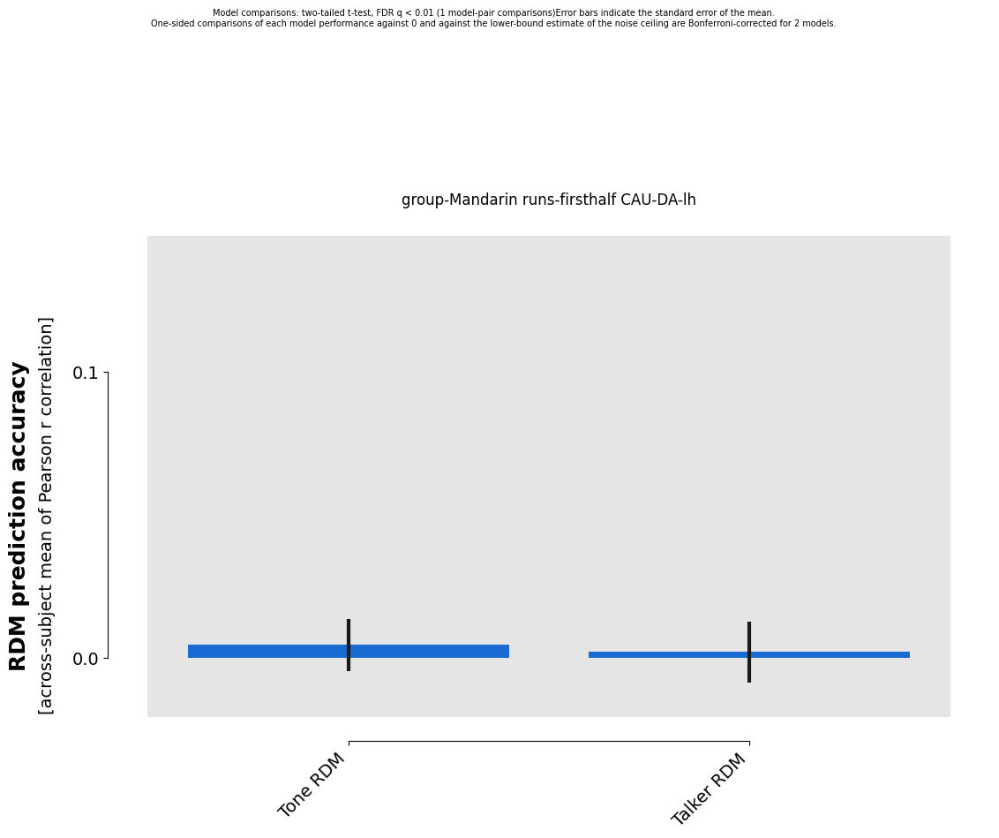

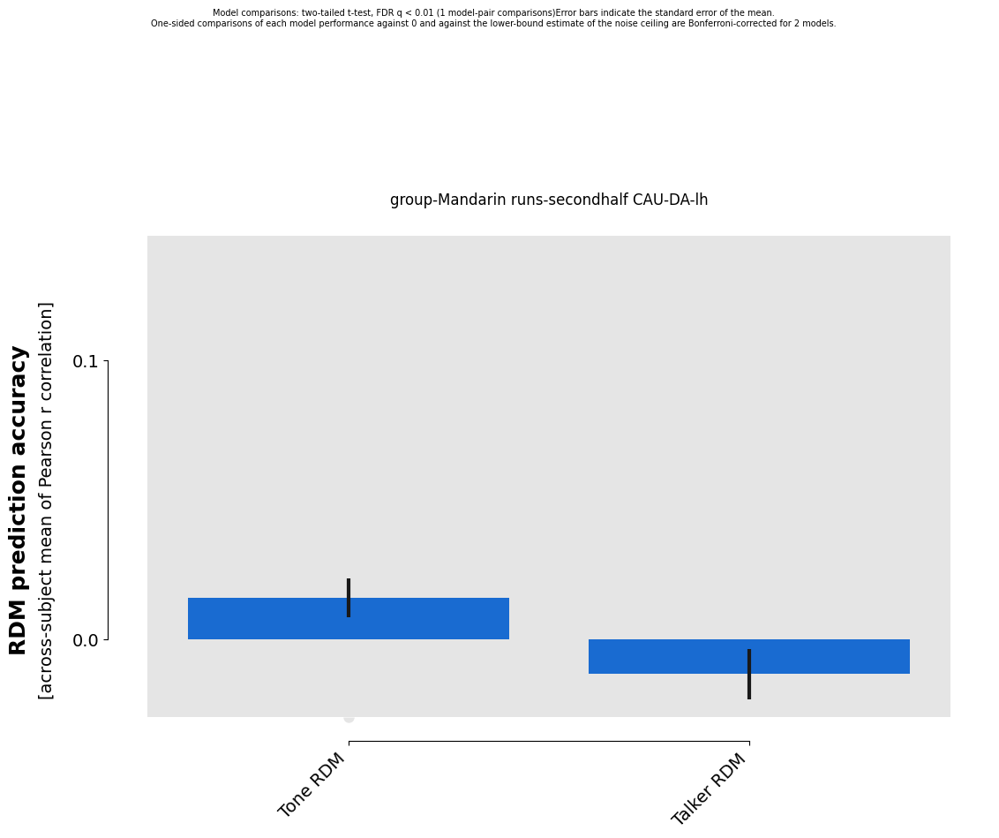

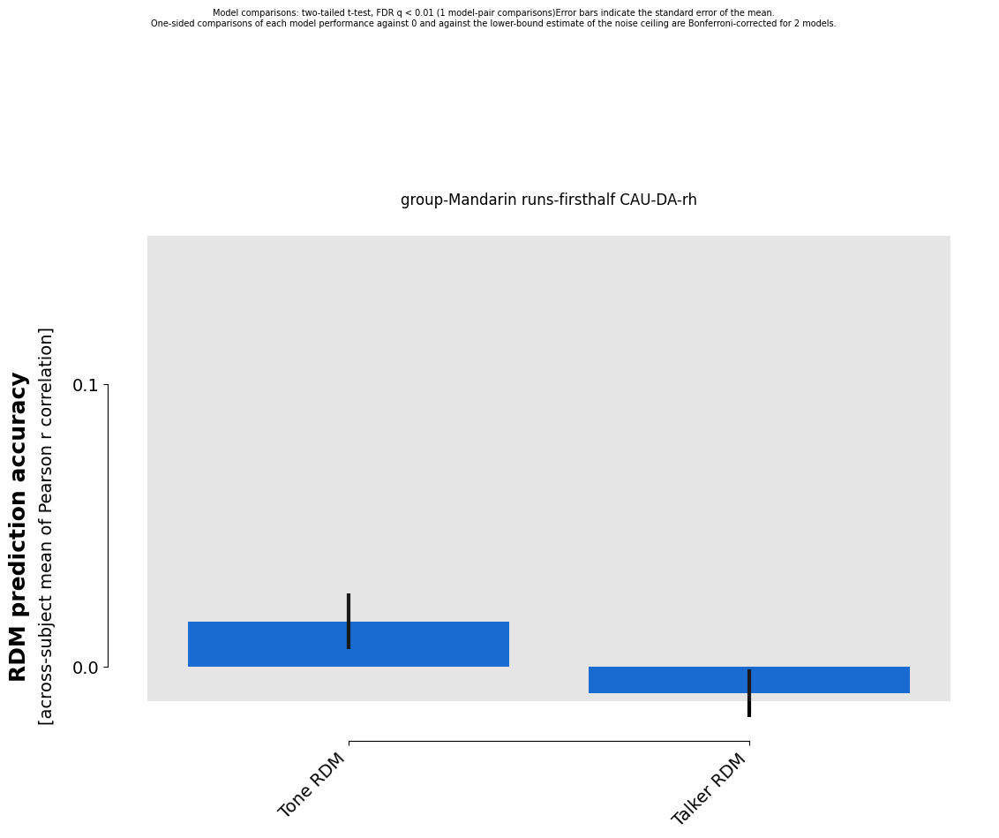

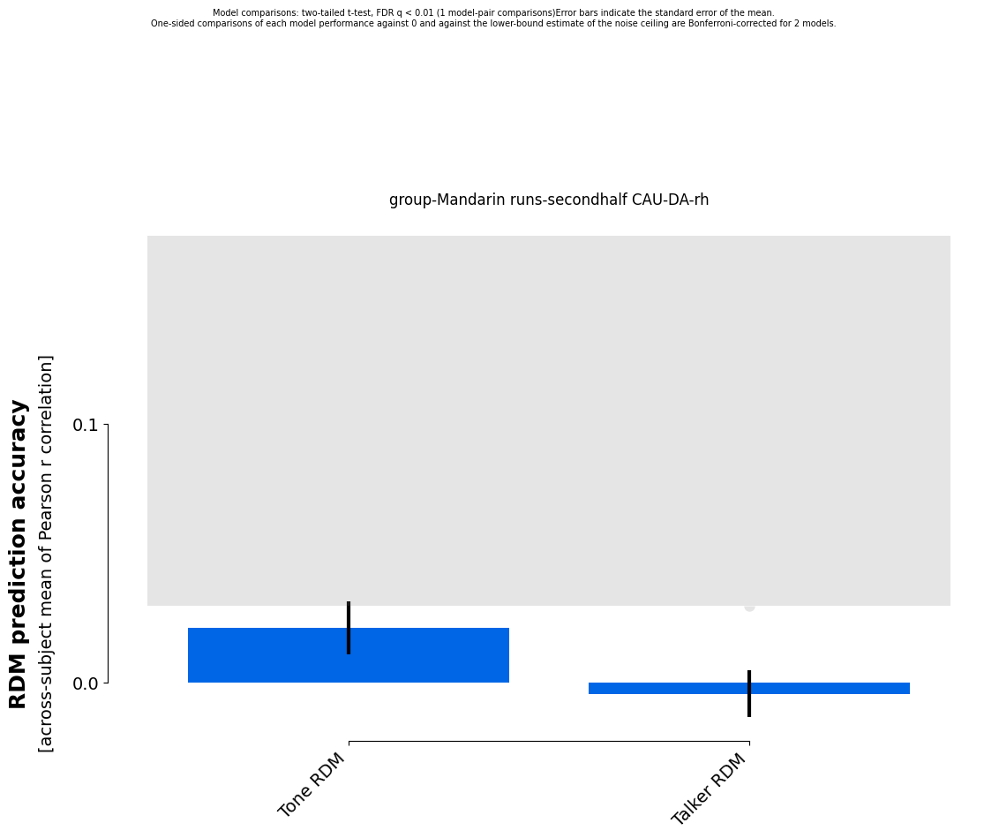

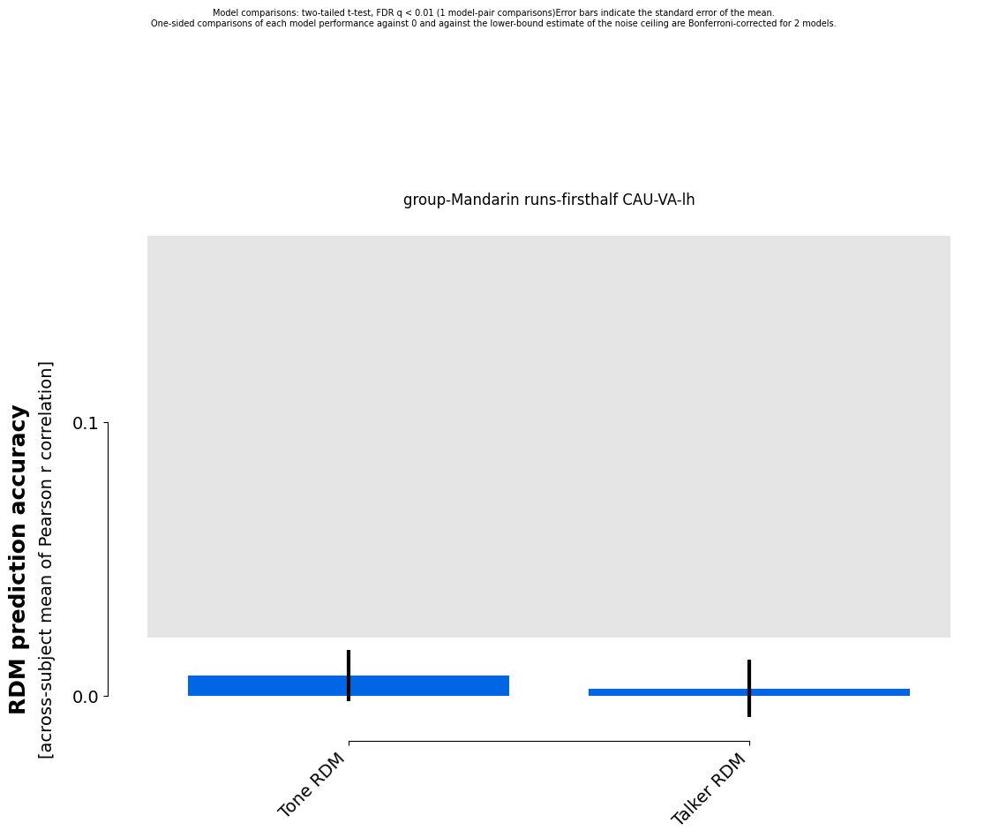

...

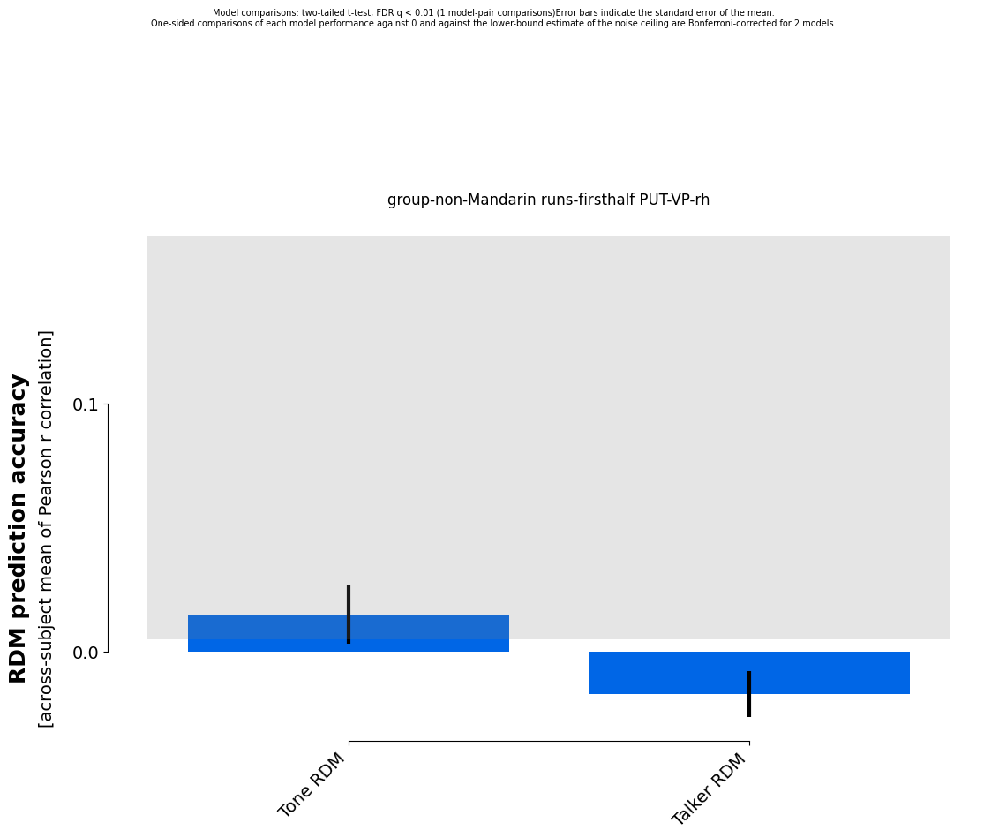

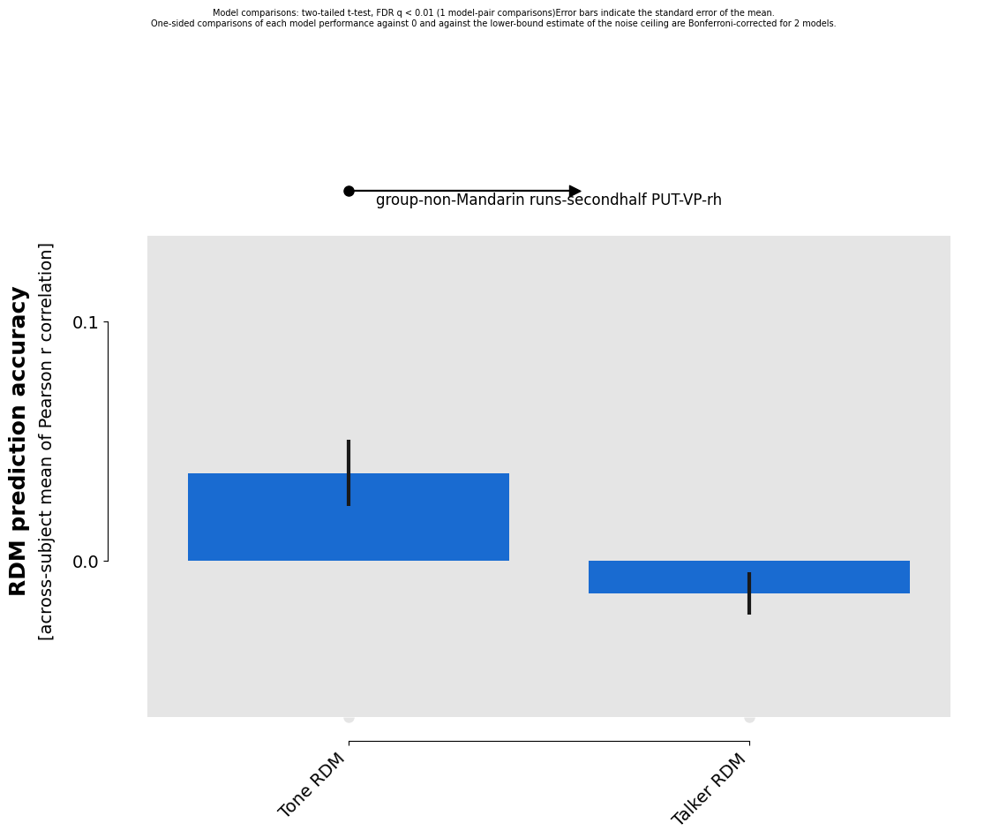

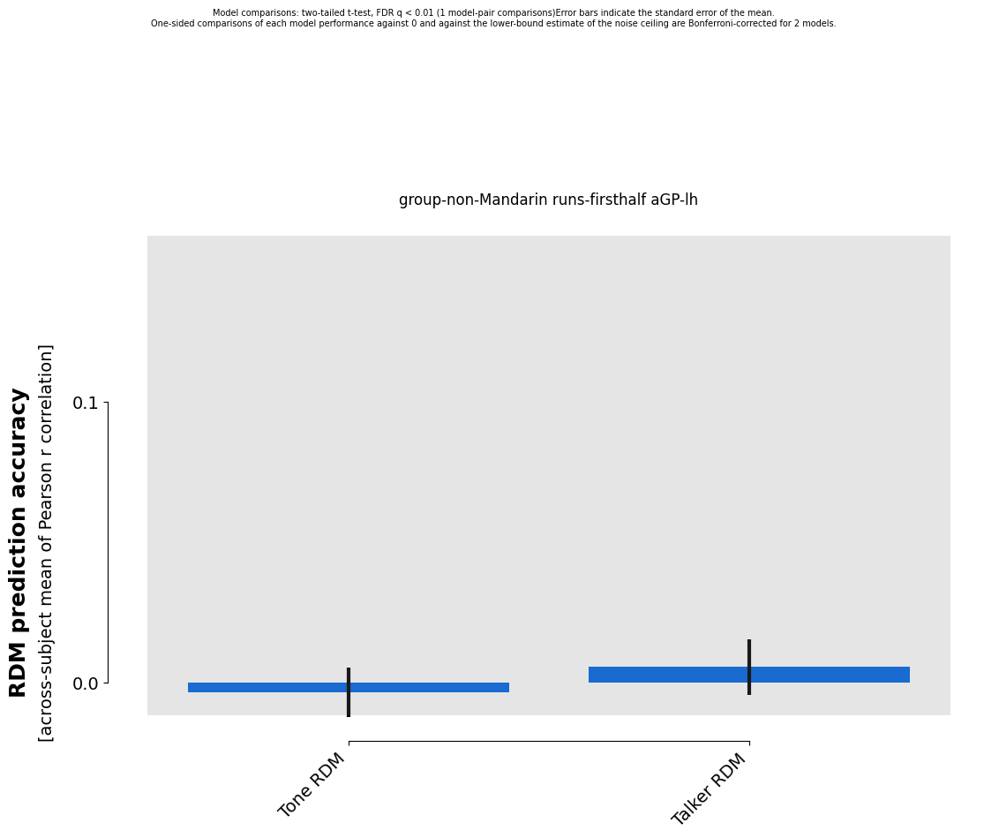

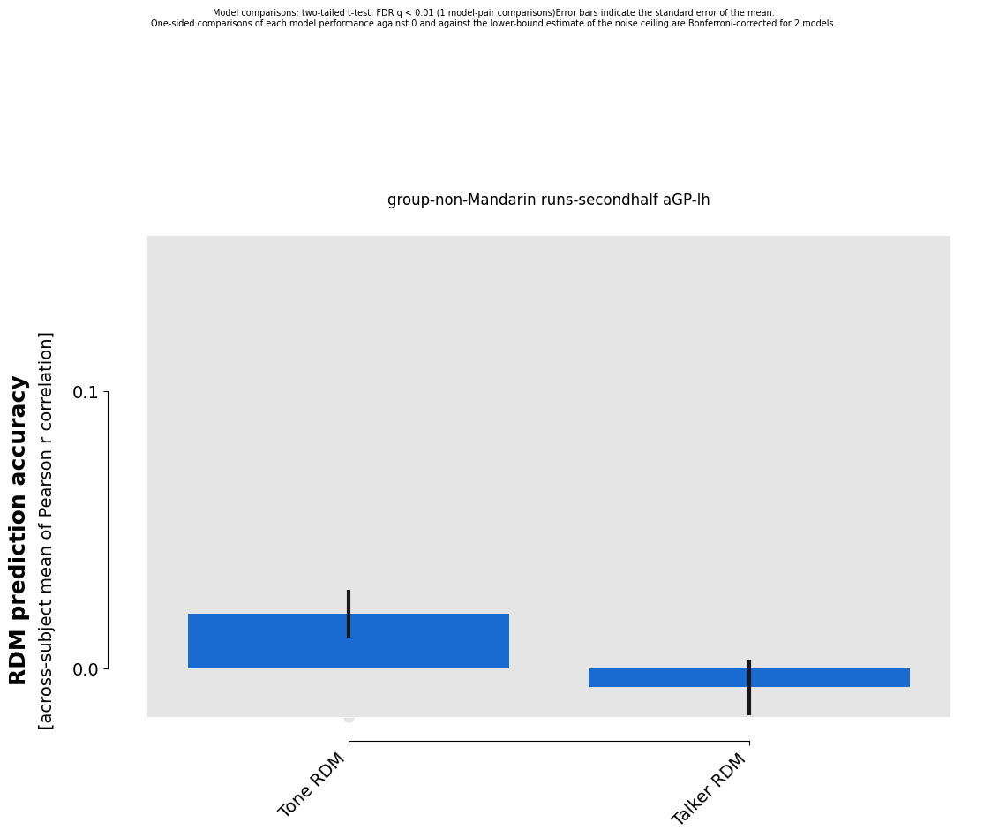

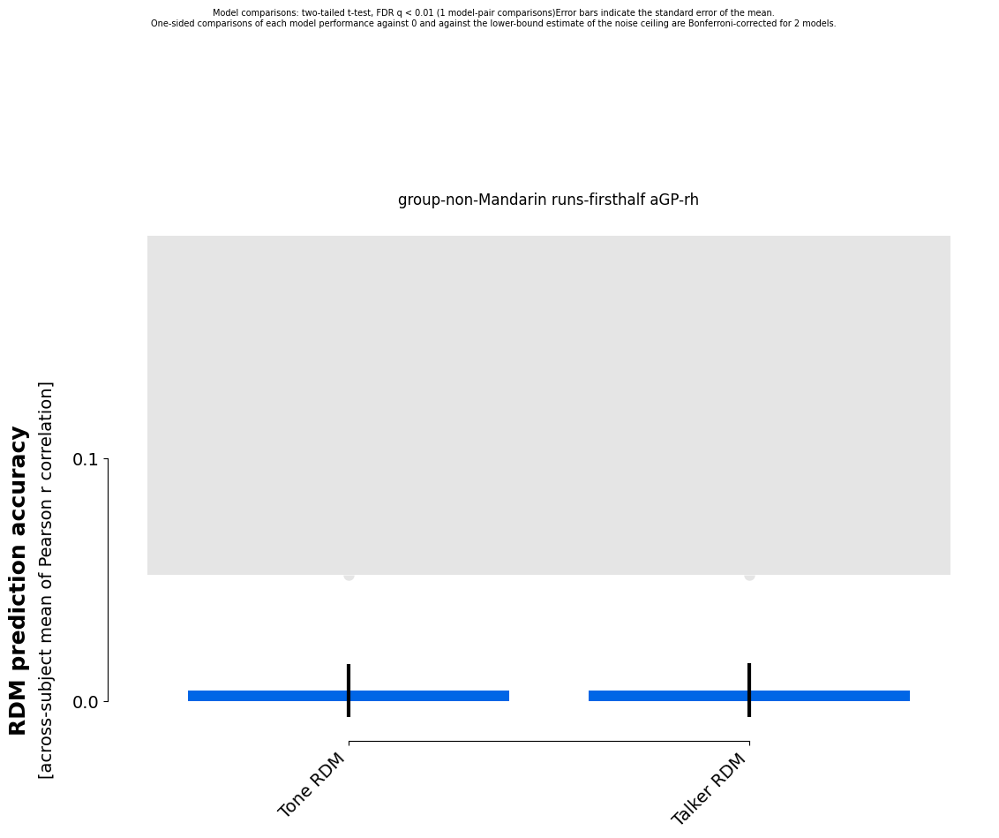

In [47]:
'''
group = 'Mandarin'
run = 'run00'
ROI = 'mask-R-ParsTri'
'''
for group in np.unique(group_rdms.rdm_descriptors['group']): #['non-Mandarin']:#
    #for run in np.unique(group_rdms.rdm_descriptors['run']):
    for ROI in np.unique(group_rdms.rdm_descriptors['ROI']):
        if 'MGN' in ROI:
            continue
        for runcombo in runcombo_dict:
            print(f'group-{group} runs-{runcombo} {ROI}')
            runs = runcombo_dict[runcombo]
            results_grr = rsatoolbox.inference.eval_fixed(
                                                          cat_models, #all_models, 
                                                          group_rdms.subset('group', value=group).subset('run',value=runs).subset('ROI',value=ROI),  
                                                          method='corr',)
            fig, ax1, ax2 = rsatoolbox.vis.plot_model_comparison(results_grr);
            ax1.set_title(f'group-{group} runs-{runcombo} {ROI}');
            ax1.axes.set_xticklabels(ax1.xaxis.get_majorticklabels(), ha="right")

            #results_grr.save(f'results-eval/results-eval_group-{group}_run-{run}_ROI-{ROI}.hdf5',overwrite=True)

In [48]:
print(results_grr)

Results for running fixed evaluation for corr on 2 models:

Model      |   Eval ± SEM   | p (against 0) | p (against NC) |
--------------------------------------------------------------
Tone RDM   |  0.004 ± 0.011 |        0.352  |       < 0.001  |
Talker RDM |  0.004 ± 0.011 |        0.349  |       < 0.001  |

p-values are based on uncorrected t-tests


### WIP: Hierarchical tests, split runs

In [39]:
mean_rdms_mand

rsatoolbox.rdm.RDMs(
dissimilarity_measure = 
None
dissimilarities = 
[[2.18434469 2.16593166 1.71754503 ... 1.64891619 2.0924978  1.91266717]
 [2.24480756 2.12806912 2.00712243 ... 2.41159459 2.52758356 2.16290508]
 [2.3028531  2.16342697 2.05838177 ... 2.16271216 2.17274798 2.16089866]
 ...
 [2.33004238 2.27638168 2.32752825 ... 2.00584334 2.37240804 2.01215973]
 [2.41159076 2.38467481 2.47870339 ... 2.16319079 2.40912419 2.06779915]
 [2.42380789 2.32801541 2.47918812 ... 2.1073666  2.41325774 2.00063277]]
descriptors = 
{}
rdm_descriptors = 
{'run': ['run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02',

In [40]:
neural_models_dict = {}

neural_models_dict['Mandarin'] = [ModelFixed(x, rdm=mean_rdms_mand.subset('group', value='Mandarin').subset('ROI',value=x)) for x in np.unique(mean_rdms_mand.rdm_descriptors['ROI'])]
neural_models_dict['non-Mandarin'] = [ModelFixed(x, rdm=mean_rdms_nman.subset('group', value='non-Mandarin').subset('ROI',value=x)) for x in np.unique(mean_rdms_nman.rdm_descriptors['ROI'])]


In [43]:
for group in ['non-Mandarin']:# np.unique(group_rdms.rdm_descriptors['group']): # 
    for ROI in np.unique(group_rdms.rdm_descriptors['ROI']):
        print(f'group-{group} ROI-{ROI}')
        results_grr = rsatoolbox.inference.eval_fixed(neural_models_dict[group], 
                                                      group_rdms.subset('group', value=group).subset('ROI',value=ROI),  
                                                      method='corr',)
        fig, ax1, ax2 = rsatoolbox.vis.plot_model_comparison(results_grr,
                                                             test_pair_comparisons='nili', #False, # getting a bug from plot_arrow()
                                                            );
        ax1.set_title(f'group-{group} ROI-{ROI}');
        ax1.axes.set_xticklabels(ax1.xaxis.get_majorticklabels(), ha="right")

group-Mandarin ROI-mask-L-HG


ValueError: could not broadcast input array from shape (6,84) into shape (84,)

## Run-all

In [25]:
model_desc = 'run-all_LSS'

### Load run-all subject-specific RDMs

In [26]:
# from `rsa_roi.py`-generated outputs
group_rdm_list = []
for sx, sub_id in enumerate(participant_list): # enumerate(['FLT03']): #
    print(sub_id)
    group_id = group_assignment[sx]

    out_dir = os.path.join(model_dir, 'rsa_roi', network_name)
    os.makedirs(out_dir, exist_ok=True)
    sub_fpath = os.path.join(out_dir,
                         f'sub-{sub_id}_{network_name}_{model_desc}_rdms.hdf5')
    sub_rdm = rsatoolbox.rdm.rdms.load_rdm(sub_fpath)
    
    # add the group descriptor to the subject's RDM
    sub_rdm.rdm_descriptors['group'] = [group_id for x in sub_rdm.rdm_descriptors['index']]
    group_rdm_list.append(sub_rdm)
runall_rdms = rsatoolbox.rdm.rdms.concat(group_rdm_list)

FLT02
FLT03
FLT04
FLT05
FLT06
FLT08
FLT09
FLT10
FLT11
FLT12
FLT13
FLT14
FLT15
FLT17
FLT18
FLT19
FLT20
FLT21
FLT22
FLT23
FLT24
FLT25
FLT26
FLT28
FLT30


### [ARCHIVE] Generate run-all RDMs (NOW RUN WITH RSA_ROI.PY)

#### generate run-all RDMs

In [24]:
group_rdm_list = []
for sx, sub_id in enumerate(participant_list):
    print(sub_id)
    group_id = group_assignment[sx]

    # set this path to wherever you saved the folder containing the img-files
    data_folder = os.path.join(model_dir, 'masked_statmaps',
                               'sub-{}'.format(sub_id),
                               'statmaps_masked',
                               'run-all_LSS')

    all_im_paths = sorted(glob('{}/*mask-*_cond-*_map-{}.csv'.format(data_folder, statmap)))
    #mask_list = np.unique([os.path.basename(x).split('_')[2] for x in all_im_paths])

    all_mask_data = []
    for mx, mask_descrip in enumerate(mask_list):

        print(mask_descrip)
        image_paths = sorted(glob('{}/*{}*/*{}*_cond-*_map-{}.csv'.format(data_folder, mask_descrip, mask_descrip, statmap)))
        #print('# of images: ', len(image_paths))

        mask_fpath = os.path.join(deriv_dir, 'nilearn', 'masks', 'sub-{}'.format(sub_id),
                                  'space-{}'.format(space_label), 'masks-dseg',
                                  'sub-{}_space-{}_mask-gm.nii.gz'.format(sub_id, space_label))

        try:
            n_vox = np.genfromtxt(image_paths[0]).shape[0]
        except IndexError:
            n_vox = 1

        data = np.zeros((len(image_paths), n_vox))
        for x, im in enumerate(image_paths):
            data[x] = np.genfromtxt(im)
        all_mask_data.append(data)

        roi_rdms = []
    for rx, mask_data in enumerate(all_mask_data):
        dataset = rsatoolbox.data.Dataset(mask_data, 
                                          descriptors={'participant': sub_id, 
                                                       'ROI': mask_list[rx], 
                                                       'group': group_id
                                                      },)
        test_rdm = rsatoolbox.rdm.calc_rdm(dataset)
        roi_rdms.append(test_rdm)
        group_rdm_list.append(test_rdm)

    concat_rdms = rsatoolbox.rdm.rdms.concat(roi_rdms)
runall_rdms = rsatoolbox.rdm.rdms.concat(group_rdm_list)
runall_rdms.save('group_run-all_denoised_LSS_rdms.hdf5')

FLT02
mask-L-IC
mask-L-MGN
mask-L-HG
mask-L-PP
mask-L-PT
mask-L-STGp
mask-L-STGa
mask-L-ParsOp
mask-L-ParsTri
mask-L-Caud
mask-L-Put
mask-R-IC
mask-R-MGN
mask-R-HG
mask-R-PP
mask-R-PT
mask-R-STGp
mask-R-STGa
mask-R-ParsOp
mask-R-ParsTri
mask-R-Caud
mask-R-Put
FLT03
mask-L-IC
mask-L-MGN
mask-L-HG
mask-L-PP
mask-L-PT
mask-L-STGp
mask-L-STGa
mask-L-ParsOp
mask-L-ParsTri
mask-L-Caud
mask-L-Put
mask-R-IC
mask-R-MGN
mask-R-HG
mask-R-PP
mask-R-PT
mask-R-STGp
mask-R-STGa
mask-R-ParsOp
mask-R-ParsTri
mask-R-Caud
mask-R-Put
FLT04
mask-L-IC
mask-L-MGN
mask-L-HG
mask-L-PP
mask-L-PT
mask-L-STGp
mask-L-STGa
mask-L-ParsOp
mask-L-ParsTri
mask-L-Caud
mask-L-Put
mask-R-IC
mask-R-MGN
mask-R-HG
mask-R-PP
mask-R-PT
mask-R-STGp
mask-R-STGa
mask-R-ParsOp
mask-R-ParsTri
mask-R-Caud
mask-R-Put
FLT05
mask-L-IC
mask-L-MGN
mask-L-HG
mask-L-PP
mask-L-PT
mask-L-STGp
mask-L-STGa
mask-L-ParsOp
mask-L-ParsTri
mask-L-Caud
mask-L-Put
mask-R-IC
mask-R-MGN
mask-R-HG
mask-R-PP
mask-R-PT
mask-R-STGp
mask-R-STGa
mask-R-ParsO

In [ ]:
runall_rdms.pattern_descriptors = pattern_descriptors

In [ ]:
runall_rdms

rsatoolbox.rdm.RDMs(
dissimilarity_measure = 
None
dissimilarities = 
[[1.65090326 2.54498709 2.7461404  ... 0.88731255 0.79245524 0.51212648]
 [1.76075364 2.25880332 2.01826887 ... 1.77228326 1.47480753 1.52958053]
 [2.1523935  2.63733217 2.3533549  ... 1.40091974 1.40092946 1.37507129]
 ...
 [1.59879128 1.7957521  2.21123099 ... 1.49749671 2.75822086 2.76852238]
 [1.73091562 1.73639412 2.10535821 ... 1.99467207 2.45316524 3.33237666]
 [1.44020635 1.53642467 1.73675281 ... 1.94358428 2.57684323 1.77874183]]
descriptors = 
{}
rdm_descriptors = 
{'participant': ['FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT04', 'FLT04', 'FLT04', 'FLT04', 

#### load pre-generated run-all RDMs

In [33]:
runall_rdms = rsatoolbox.rdm.rdms.load_rdm('group_run-all_denoised_LSS_rdms.hdf5')

### plot all RDMs

In [27]:
fig = plt.figure(constrained_layout=True, figsize=(20,30), dpi=500)
fig.suptitle('Single-participant ROI RDMs')

subfigs = fig.subfigures(nrows=len(participant_list), ncols=1)

for sx, sub_id in enumerate(participant_list):
    subfigs[sx].suptitle(f'{sub_id} - {group_assignment[sx]} group')
    axes = subfigs[sx].subplots(nrows=1, ncols=len(roi_list))
    for rx, roi in enumerate(roi_list):
        rsatoolbox.vis.show_rdm_panel(runall_rdms.subset('participant', value=sub_id).subset('ROI', value=roi), 
                                        ax=axes[rx],
                                        rdm_descriptor='ROI', 
                                        cmap='inferno',
                                        #show_colorbar='panel', # cut figsize height in half if showing colorbar
                                       );


### Mean RDMs across participants per group

In [29]:
mean_rdms_mand_list = []
mean_rdms_nman_list = []
for rx, roi in enumerate(roi_list):
    # Mandarin-speaking
    dissim_mand = runall_rdms.subset('group', value='Mandarin').subset('ROI', value=roi).dissimilarities
    
    roi_mand = RDMs(dissim_mand.mean(axis=0),
                    rdm_descriptors={'ROI': roi_list[rx], 'group': 'Mandarin'},
                    pattern_descriptors=pattern_descriptors)
    mean_rdms_mand_list.append(roi_mand)
    
    # non-Mandarin-speaking
    dissim_nman = runall_rdms.subset('group', value='non-Mandarin').subset('ROI', value=roi).dissimilarities
    roi_nman = RDMs(dissim_nman.mean(axis=0),
                    rdm_descriptors={'ROI': roi_list[rx], 'group': 'non-Mandarin'},
                    pattern_descriptors=pattern_descriptors)
    mean_rdms_nman_list.append(roi_nman)

mean_rdms_mand = rsatoolbox.rdm.rdms.concat(mean_rdms_mand_list)
mean_rdms_nman = rsatoolbox.rdm.rdms.concat(mean_rdms_nman_list)



In [30]:
mean_rdms_nman

rsatoolbox.rdm.RDMs(
dissimilarity_measure = 
None
dissimilarities = 
[[2.11618211 2.38992923 2.2205338  ... 2.65738062 2.46549204 2.235462  ]
 [2.79261284 2.38764144 2.2699422  ... 2.2483238  2.03318107 2.13801953]
 [1.80170904 2.14256189 2.10990384 ... 2.23414089 1.91849686 2.25176959]
 ...
 [1.59680929 1.64366008 1.67798193 ... 1.55006426 1.56168073 1.59821656]
 [2.09717294 2.2730553  2.20896911 ... 2.29347383 2.20986174 1.96615651]
 [1.78959167 1.92622611 1.77073852 ... 1.87612073 1.82248211 1.58717749]]
descriptors = 
{}
rdm_descriptors = 
{'ROI': ['CAU-DA-lh', 'CAU-VA-lh', 'pCAU-lh', 'PUT-DA-lh', 'PUT-DP-lh', 'PUT-VA-lh', 'PUT-VP-lh', 'aGP-lh', 'pGP-lh', 'NAc-core-lh', 'NAc-shell-lh', 'CAU-DA-rh', 'CAU-VA-rh', 'pCAU-rh', 'PUT-DA-rh', 'PUT-DP-rh', 'PUT-VA-rh', 'PUT-VP-rh', 'aGP-rh', 'pGP-rh', 'NAc-core-rh', 'NAc-shell-rh'], 'group': ['non-Mandarin', 'non-Mandarin', 'non-Mandarin', 'non-Mandarin', 'non-Mandarin', 'non-Mandarin', 'non-Mandarin', 'non-Mandarin', 'non-Mandarin', 'non-

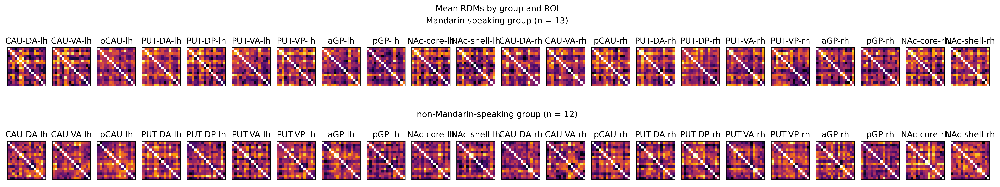

In [31]:
fig = plt.figure(constrained_layout=True, figsize=(20,4), dpi=500)
fig.suptitle('Mean RDMs by group and ROI')

subfigs = fig.subfigures(nrows=2, ncols=1)

n_mand = len(sub_group_dict['Mandarin'])
n_nman = len(sub_group_dict['non-Mandarin'])

subfigs[0].suptitle(f'Mandarin-speaking group (n = {n_mand})')
subfigs[1].suptitle(f'non-Mandarin-speaking group (n = {n_nman})')

axs0 = subfigs[0].subplots(nrows=1, ncols=len(roi_list))
axs1 = subfigs[1].subplots(nrows=1, ncols=len(roi_list))
for rx, roi in enumerate(roi_list):
    rsatoolbox.vis.show_rdm_panel(mean_rdms_mand.subset('ROI', value=roi), 
                                  rdm_descriptor='ROI', 
                                  cmap='inferno', 
                                  ax=axs0[rx])
    rsatoolbox.vis.show_rdm_panel(mean_rdms_nman.subset('ROI', value=roi), 
                                  rdm_descriptor='ROI', 
                                  cmap='inferno', 
                                  ax=axs1[rx])

#### MDS

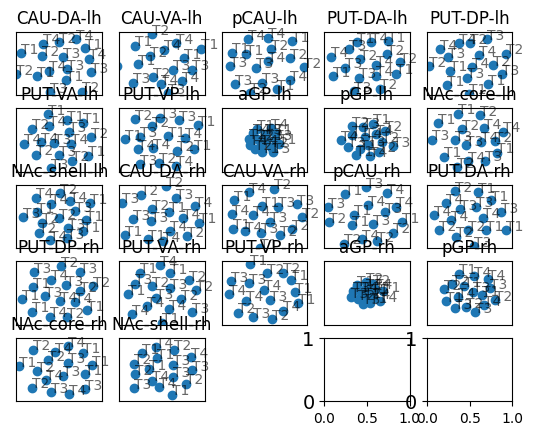

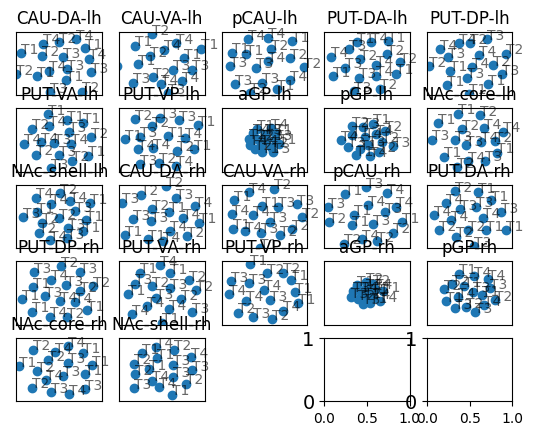

In [58]:
rsatoolbox.vis.scatter_plot.show_MDS(mean_rdms_mand, 
                                     rdm_descriptor='ROI',
                                     pattern_descriptor='tone')

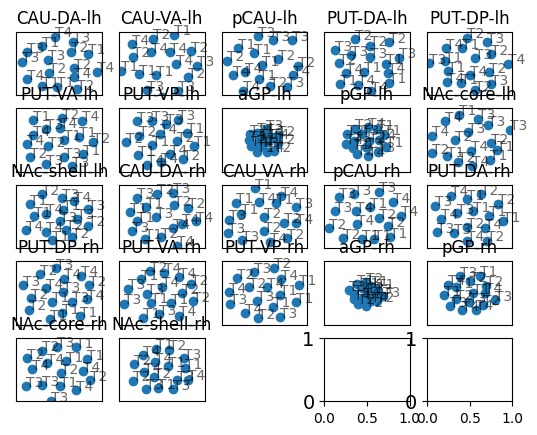

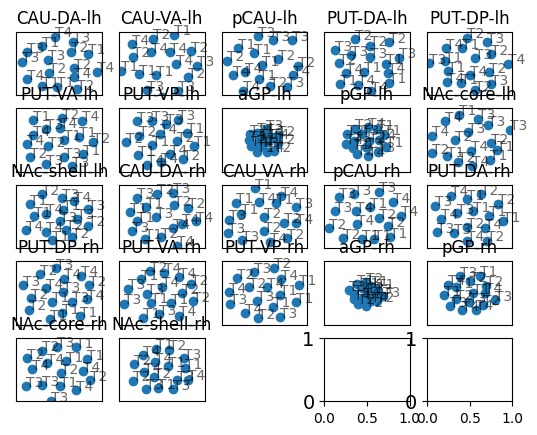

In [59]:
rsatoolbox.vis.scatter_plot.show_MDS(mean_rdms_nman, 
                                     rdm_descriptor='ROI',
                                     pattern_descriptor='tone')

### Model comparisons

In [35]:
[x.name for x in all_models]

['Tone RDM', 'Talker RDM']

In [78]:
test = {}
test['testkey'] = 'testval'
test

{'testkey': 'testval'}

group-Mandarin ROI-CAU-DA-lh
group-Mandarin ROI-CAU-DA-rh
group-Mandarin ROI-CAU-VA-lh
group-Mandarin ROI-CAU-VA-rh
group-Mandarin ROI-NAc-core-lh
group-Mandarin ROI-NAc-core-rh
group-Mandarin ROI-NAc-shell-lh
group-Mandarin ROI-NAc-shell-rh
group-Mandarin ROI-PUT-DA-lh
group-Mandarin ROI-PUT-DA-rh
group-Mandarin ROI-PUT-DP-lh
group-Mandarin ROI-PUT-DP-rh
group-Mandarin ROI-PUT-VA-lh
group-Mandarin ROI-PUT-VA-rh
group-Mandarin ROI-PUT-VP-lh
group-Mandarin ROI-PUT-VP-rh
group-Mandarin ROI-aGP-lh
group-Mandarin ROI-aGP-rh
group-Mandarin ROI-pCAU-lh
group-Mandarin ROI-pCAU-rh
group-Mandarin ROI-pGP-lh
group-Mandarin ROI-pGP-rh
group-non-Mandarin ROI-CAU-DA-lh
group-non-Mandarin ROI-CAU-DA-rh
group-non-Mandarin ROI-CAU-VA-lh


/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/rsatoolbox/vis/model_plot.py:282: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(12.5, 10))


group-non-Mandarin ROI-CAU-VA-rh
group-non-Mandarin ROI-NAc-core-lh
group-non-Mandarin ROI-NAc-core-rh
group-non-Mandarin ROI-NAc-shell-lh
group-non-Mandarin ROI-NAc-shell-rh
group-non-Mandarin ROI-PUT-DA-lh
group-non-Mandarin ROI-PUT-DA-rh
group-non-Mandarin ROI-PUT-DP-lh
group-non-Mandarin ROI-PUT-DP-rh
group-non-Mandarin ROI-PUT-VA-lh
group-non-Mandarin ROI-PUT-VA-rh
group-non-Mandarin ROI-PUT-VP-lh
group-non-Mandarin ROI-PUT-VP-rh
group-non-Mandarin ROI-aGP-lh
group-non-Mandarin ROI-aGP-rh
group-non-Mandarin ROI-pCAU-lh
group-non-Mandarin ROI-pCAU-rh
group-non-Mandarin ROI-pGP-lh
group-non-Mandarin ROI-pGP-rh


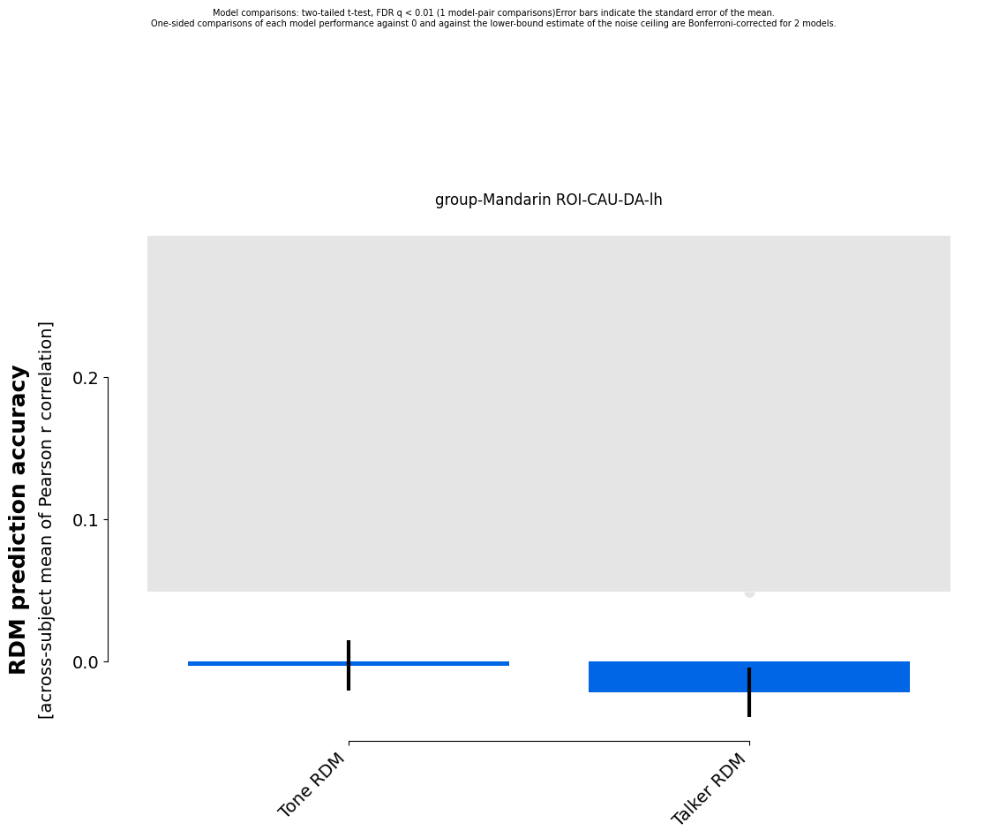

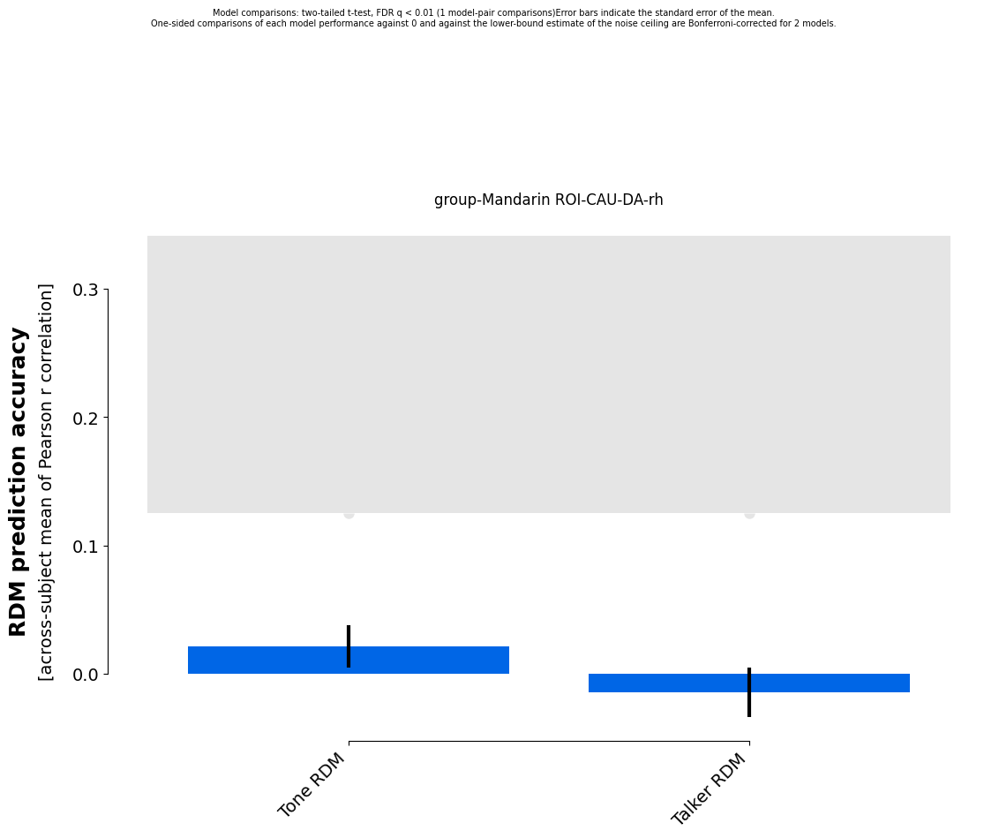

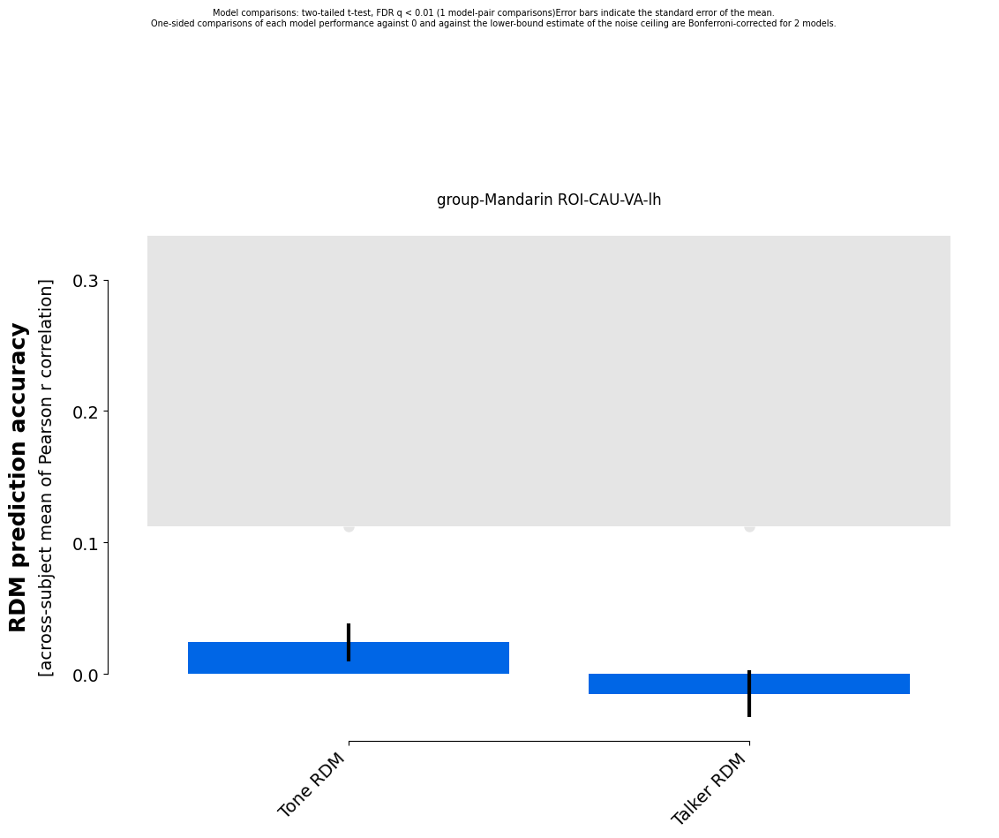

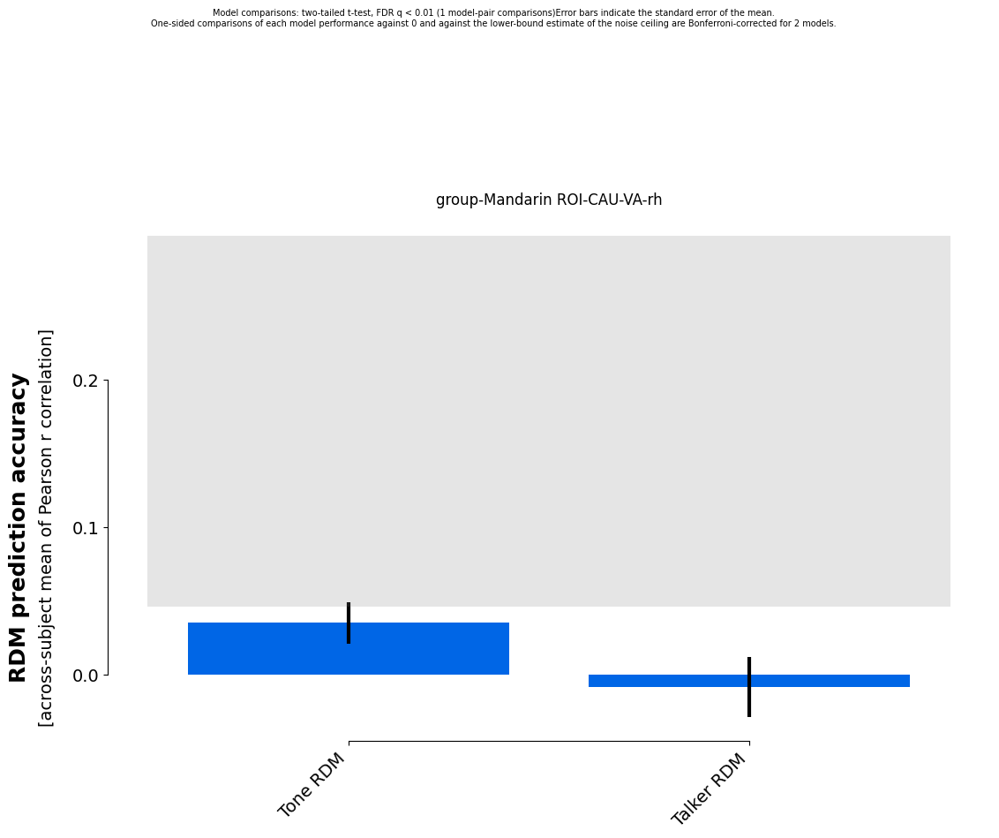

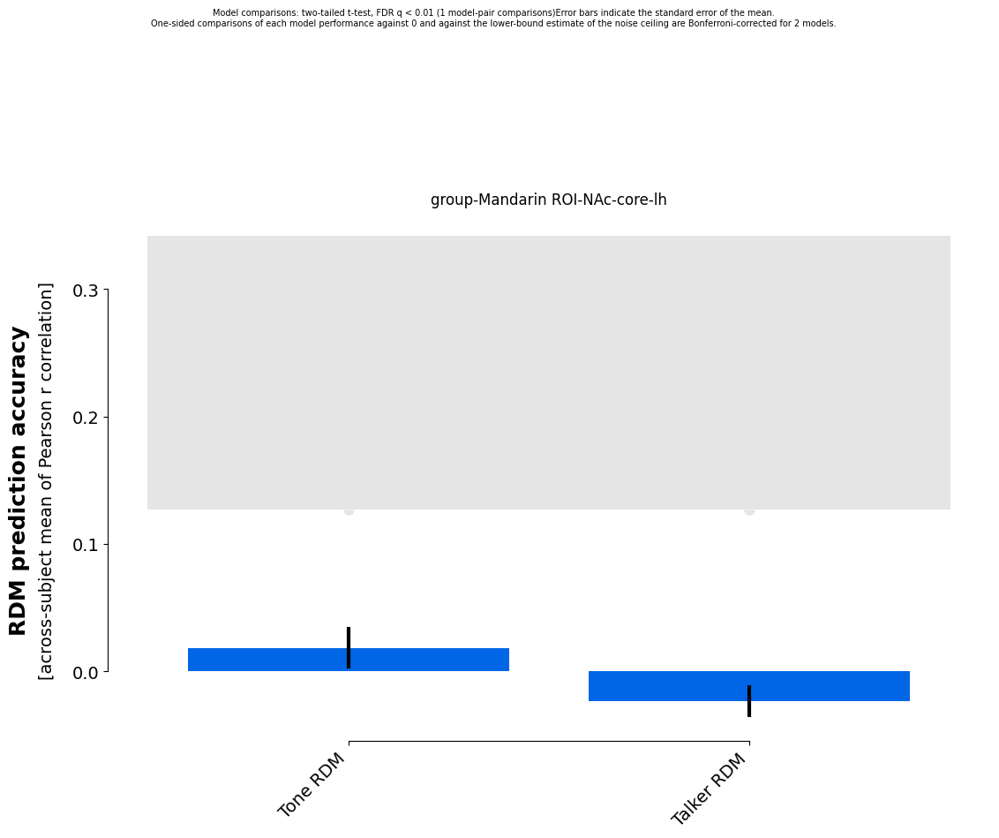

...

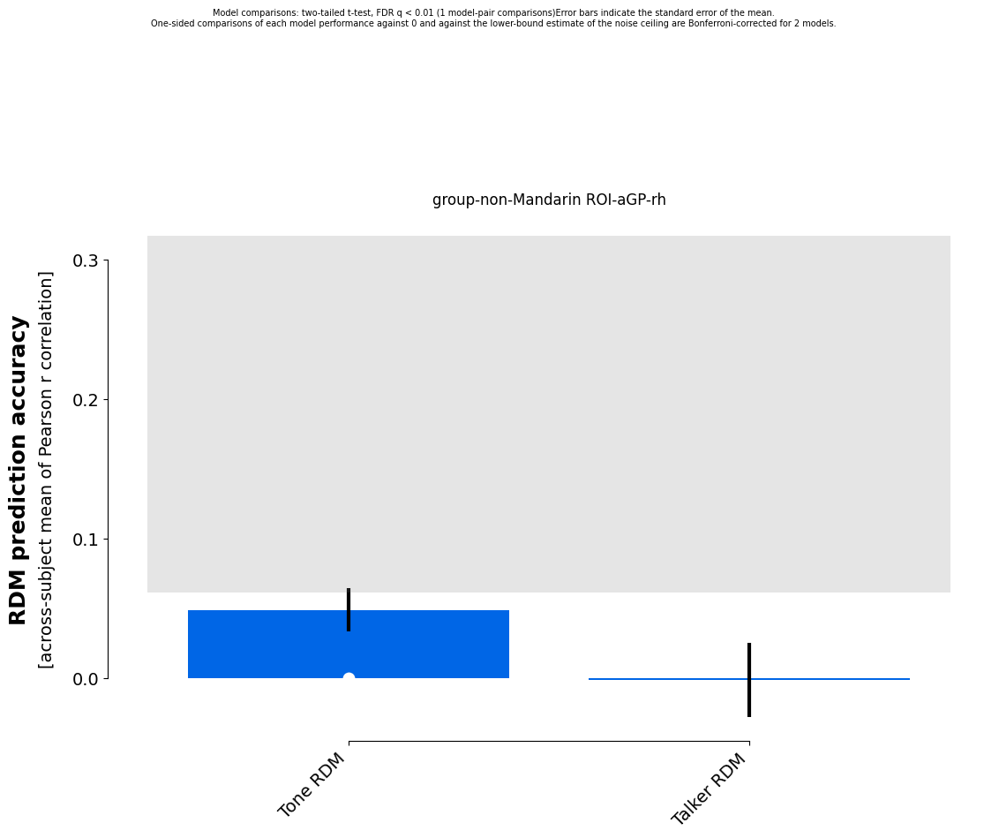

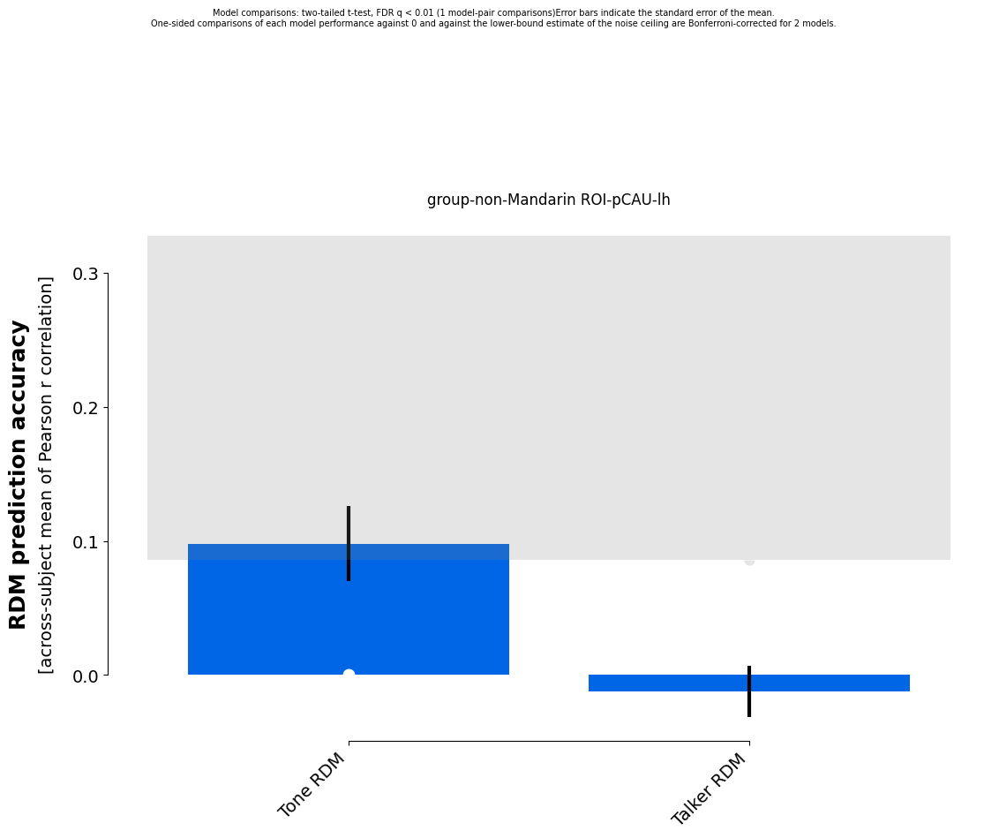

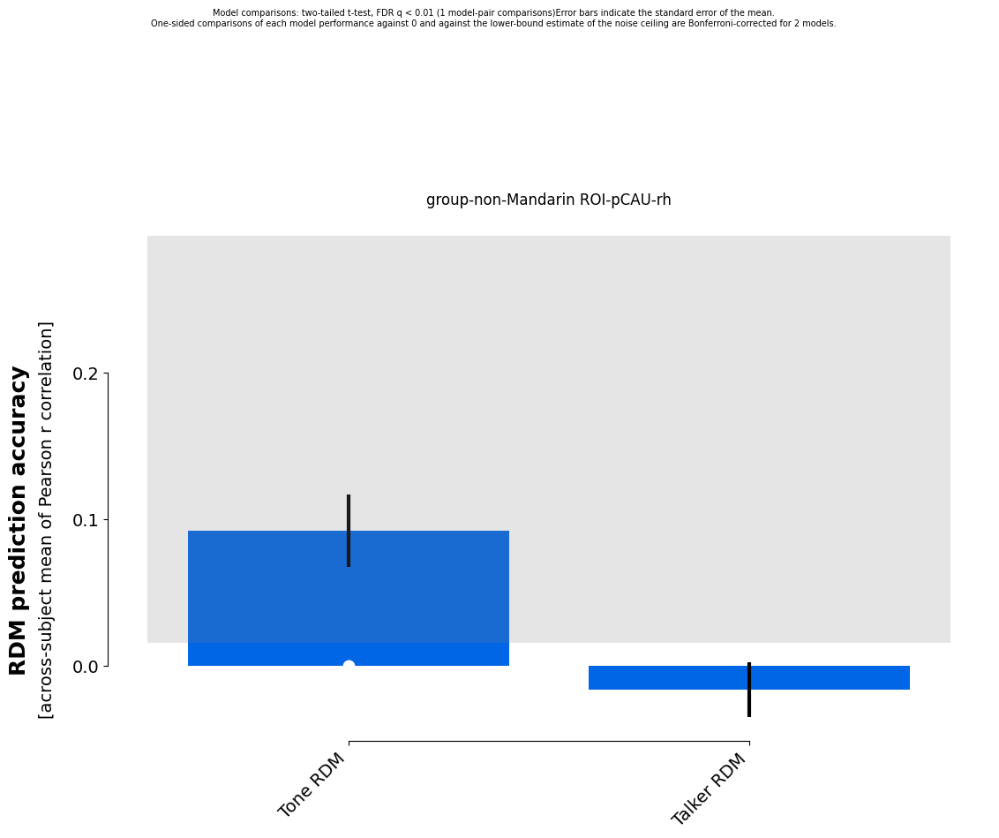

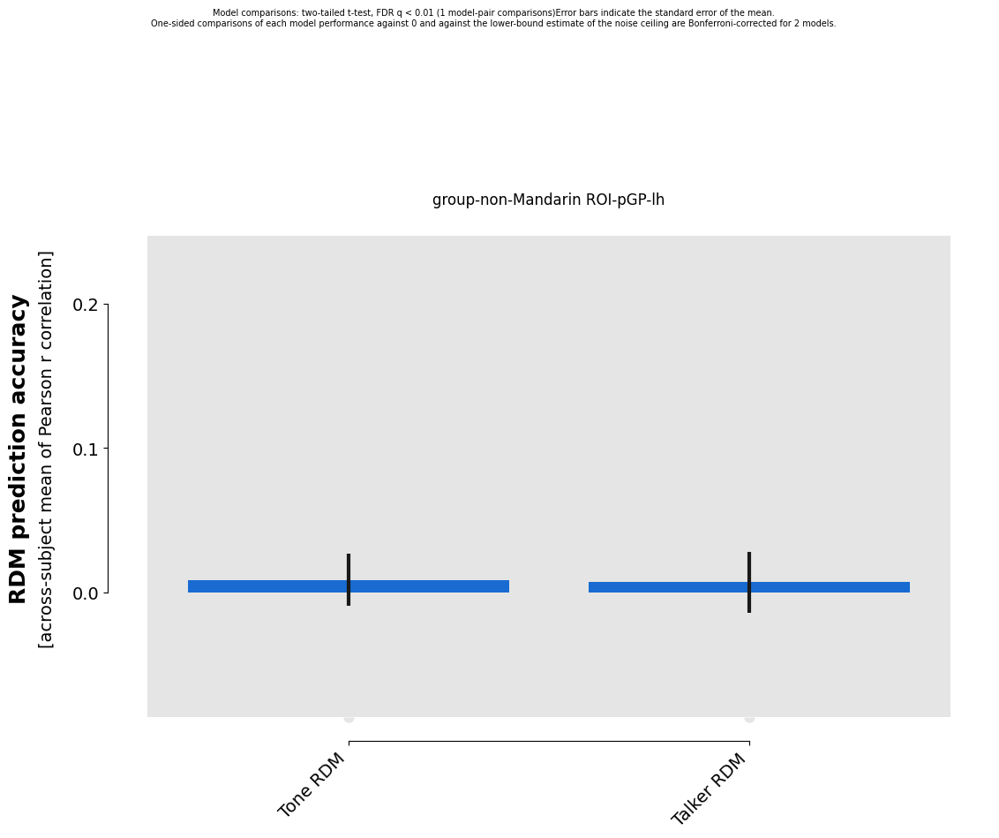

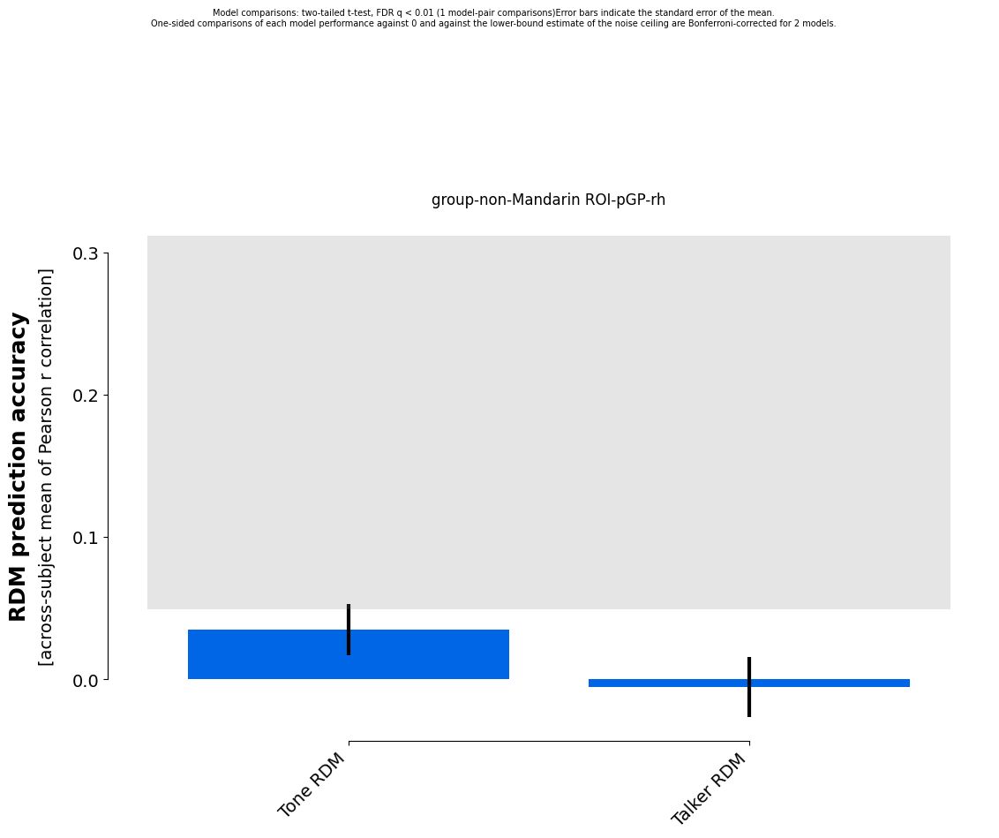

In [111]:
'''
group = 'Mandarin'
ROI = 'mask-R-ParsTri'
'''
roi_results = {}
for group in np.unique(runall_rdms.rdm_descriptors['group']):
    roi_results[group] = {}
    for ROI in np.unique(runall_rdms.rdm_descriptors['ROI']):
        print(f'group-{group} ROI-{ROI}')
        results_grr = rsatoolbox.inference.eval_fixed(all_models, 
                                                      runall_rdms.subset('group', value=group).subset('ROI',value=ROI),  
                                                      method='corr',)
        
        fig, ax1, ax2 = rsatoolbox.vis.plot_model_comparison(results_grr);
        ax1.set_title(f'group-{group} ROI-{ROI}');
        ax1.axes.set_xticklabels(ax1.xaxis.get_majorticklabels(), ha="right")
        
        results_grr.save(f'results-eval/run-all/results-eval_denoised_run-all_group-{group}_{network_name}_ROI-{ROI}.hdf5',overwrite=True)
        
        roi_results[group][ROI] = {}
        roi_results[group][ROI]['Tone'] = results_grr.to_dict()['evaluations'][0][0]
        roi_results[group][ROI]['Talker'] = results_grr.to_dict()['evaluations'][0][1]
        #roi_results[group][ROI] = results_grr.to_dict()['evaluations']
        

In [102]:
results_grr.to_dict()['evaluations']

array([[[ 0.0026862 ,  0.10090646, -0.06258141, -0.05889384,
          0.08359273, -0.01462309, -0.06051162,  0.01372249,
          0.02758022, -0.08965085,  0.09007077, -0.05359025,
         -0.01520426],
        [-0.00897834, -0.06194573,  0.00134612,  0.07898749,
          0.06318325, -0.01997125, -0.13277159, -0.07178078,
         -0.10760059,  0.03522995, -0.0260937 , -0.05064649,
          0.02250392]]])

In [61]:
print(results_grr.summary())

Results for running fixed evaluation for corr on 2 models:

Model      |   Eval ± SEM   | p (against 0) | p (against NC) |
--------------------------------------------------------------
Tone RDM   |  0.035 ± 0.018 |        0.039  |         0.436  |
Talker RDM | -0.005 ± 0.021 |        0.595  |         0.026  |

p-values are based on uncorrected t-tests


#### Custom plots

In [104]:
roi_results

{'Mandarin': {'CAU-DA-lh': {'Tone': array([ 0.0026862 ,  0.10090646, -0.06258141, -0.05889384,  0.08359273,
          -0.01462309, -0.06051162,  0.01372249,  0.02758022, -0.08965085,
           0.09007077, -0.05359025, -0.01520426]),
   'Talker': array([-0.00897834, -0.06194573,  0.00134612,  0.07898749,  0.06318325,
          -0.01997125, -0.13277159, -0.07178078, -0.10760059,  0.03522995,
          -0.0260937 , -0.05064649,  0.02250392])},
  'CAU-DA-rh': {'Tone': array([ 0.15143306,  0.10664858, -0.04309466,  0.00153343,  0.05130456,
          -0.03553317,  0.02195701, -0.00285906,  0.03608224, -0.05157451,
           0.0431768 , -0.02543118,  0.02111727]),
   'Talker': array([-0.08929137, -0.07422059,  0.01706326,  0.10044188, -0.04017822,
          -0.03724896, -0.11117269, -0.04973175, -0.00424715,  0.1096255 ,
           0.02513402, -0.06949733,  0.03191671])},
  'CAU-VA-lh': {'Tone': array([ 0.07851315,  0.00310602, -0.03887132,  0.00373254,  0.03928001,
           0.07284934,  

In [110]:
pd.DataFrame.from_dict(roi_results['Mandarin'], orient='index')

,Tone,Talker
CAU-DA-lh,"[0.002686199966923636, 0.10090646122293268, -0...","[-0.008978338640456707, -0.0619457349258626, 0..."
CAU-DA-rh,"[0.15143305957535022, 0.10664857839431807, -0....","[-0.08929137280242475, -0.07422058705843021, 0..."
CAU-VA-lh,"[0.078513151173939, 0.0031060157856165273, -0....","[-0.06188865588196005, -0.13914048713262323, 0..."
CAU-VA-rh,"[-0.005764416391944989, 0.10645080165644169, -...","[0.03499753193502037, -0.08418328018870913, -0..."
NAc-core-lh,"[0.04553763476037041, 0.08517102764530152, -0....","[-0.021642619629216417, -0.023816674919511824,..."
NAc-core-rh,"[-0.0005884875191884217, -0.007493959275046661...","[-0.03906303908748455, -0.11104536238996227, 0..."
NAc-shell-lh,"[0.02144116842368015, -0.04574958024670876, -0...","[-0.04236356001348158, -0.07937076753099506, 0..."
NAc-shell-rh,"[-0.008072166525829805, -0.03916321149795521, ...","[-0.05249848539979239, -0.013902006190481899, ..."
PUT-DA-lh,"[0.0024100939598891463, -0.05317153720171973, ...","[-0.12114140135308914, 0.07545193885277186, 0...."
PUT-DA-rh,"[-0.04343888798457437, 0.06807715185154714, -0...","[-0.056405534527782866, -0.049093743521662084,..."


## TEST: Categorical model comparisons

In [62]:
results_1 = []
for roi in roi_list:
    print(roi)
    results_1.append(rsatoolbox.inference.eval_fixed(cat_models, 
                                                     runall_rdms.subset('ROI', value=roi).subset('group', value='non-Mandarin'), 
                                                     method='corr',))


CAU-DA-lh
CAU-VA-lh
pCAU-lh
PUT-DA-lh
PUT-DP-lh
PUT-VA-lh
PUT-VP-lh
aGP-lh
pGP-lh
NAc-core-lh
NAc-shell-lh
CAU-DA-rh
CAU-VA-rh
pCAU-rh
PUT-DA-rh
PUT-DP-rh
PUT-VA-rh
PUT-VP-rh
aGP-rh
pGP-rh
NAc-core-rh
NAc-shell-rh


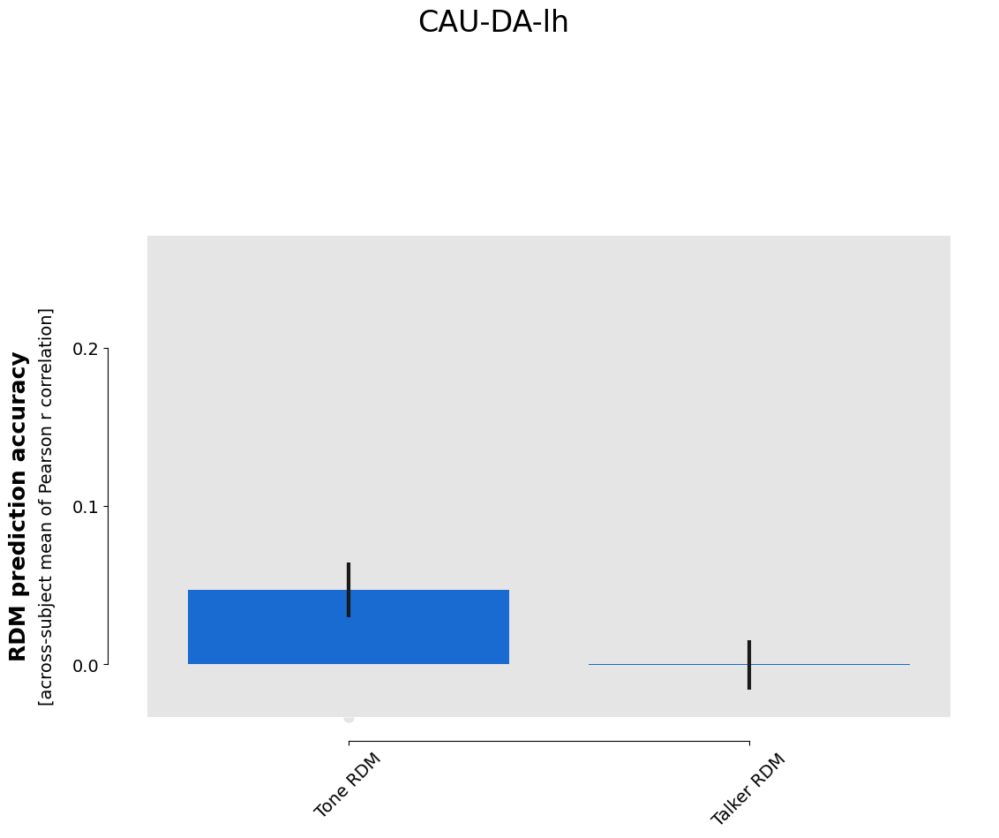

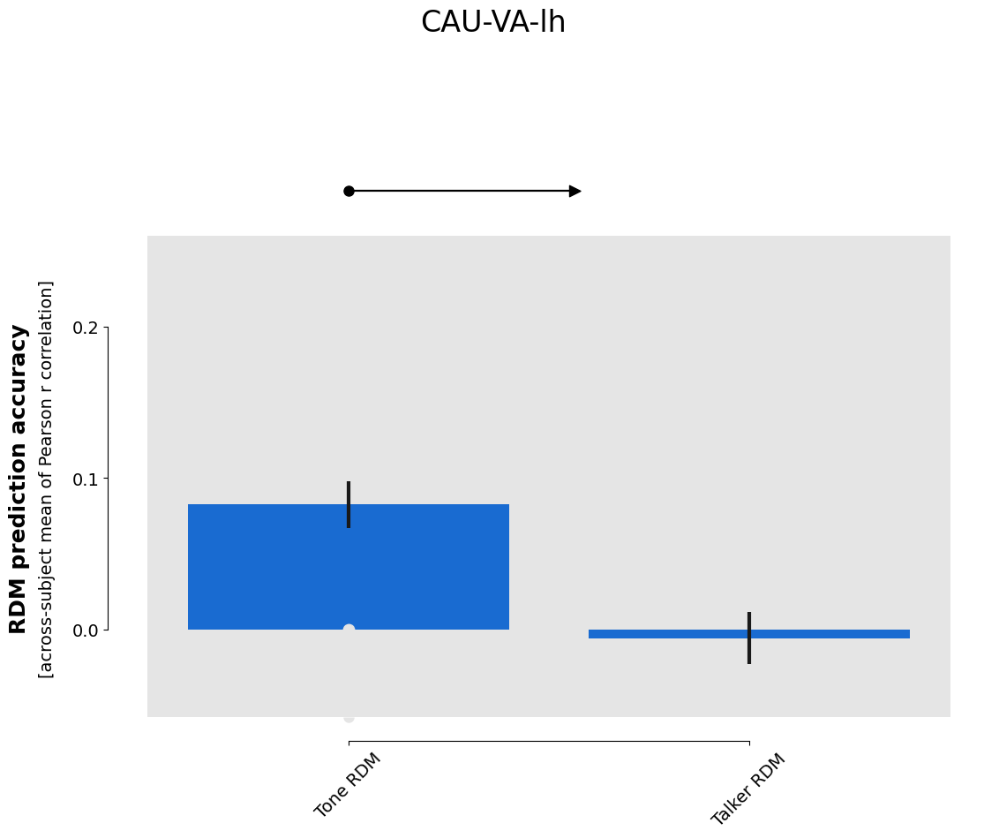

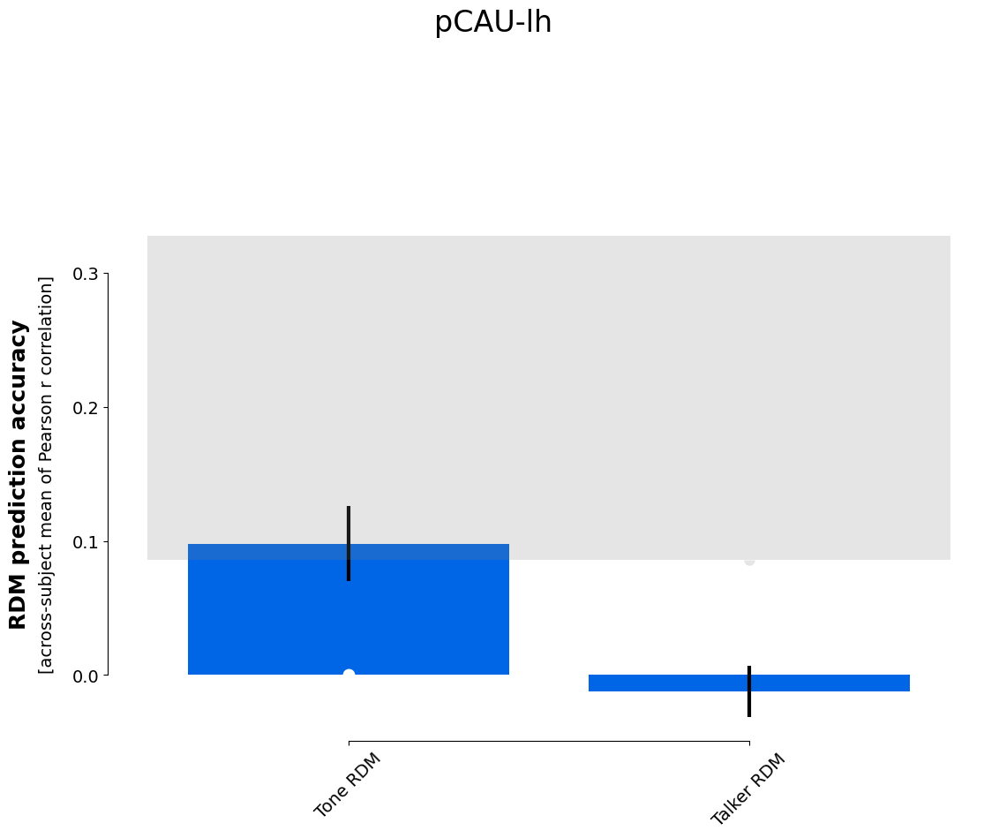

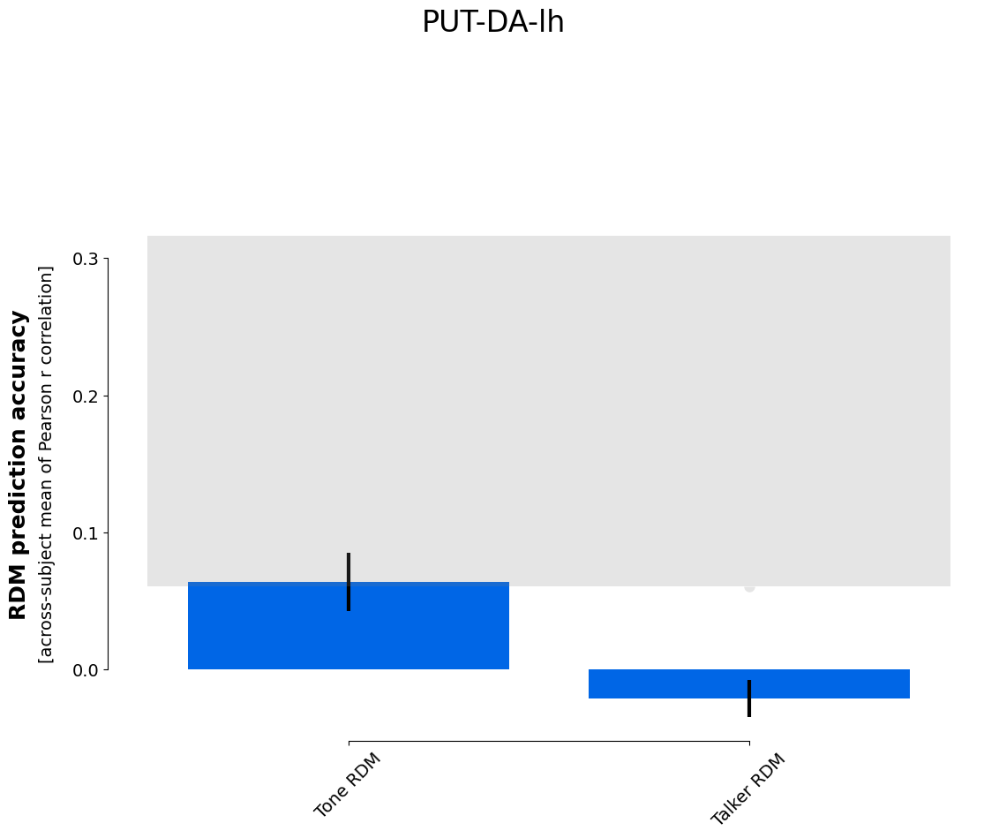

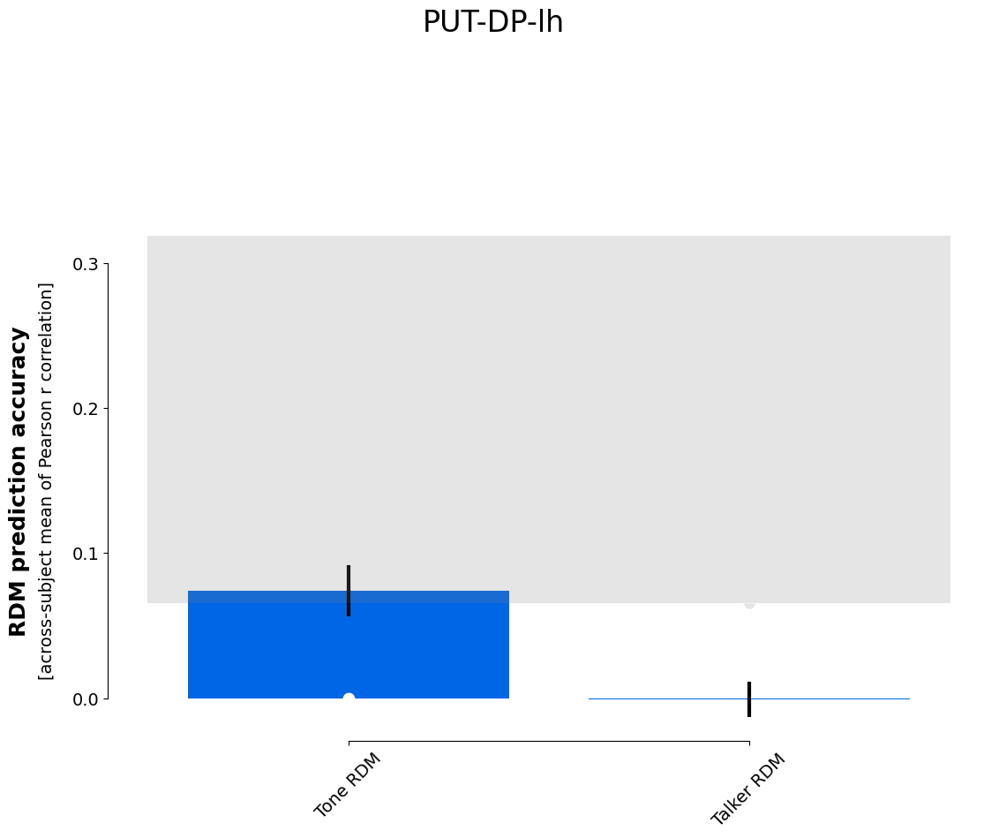

...

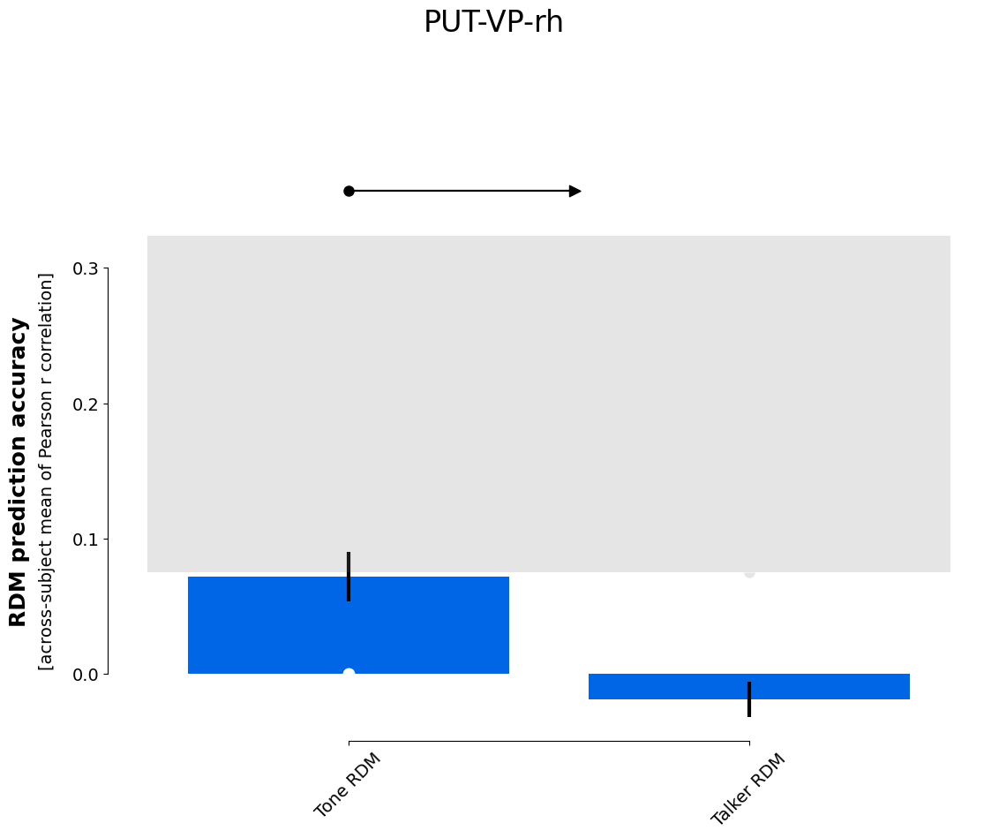

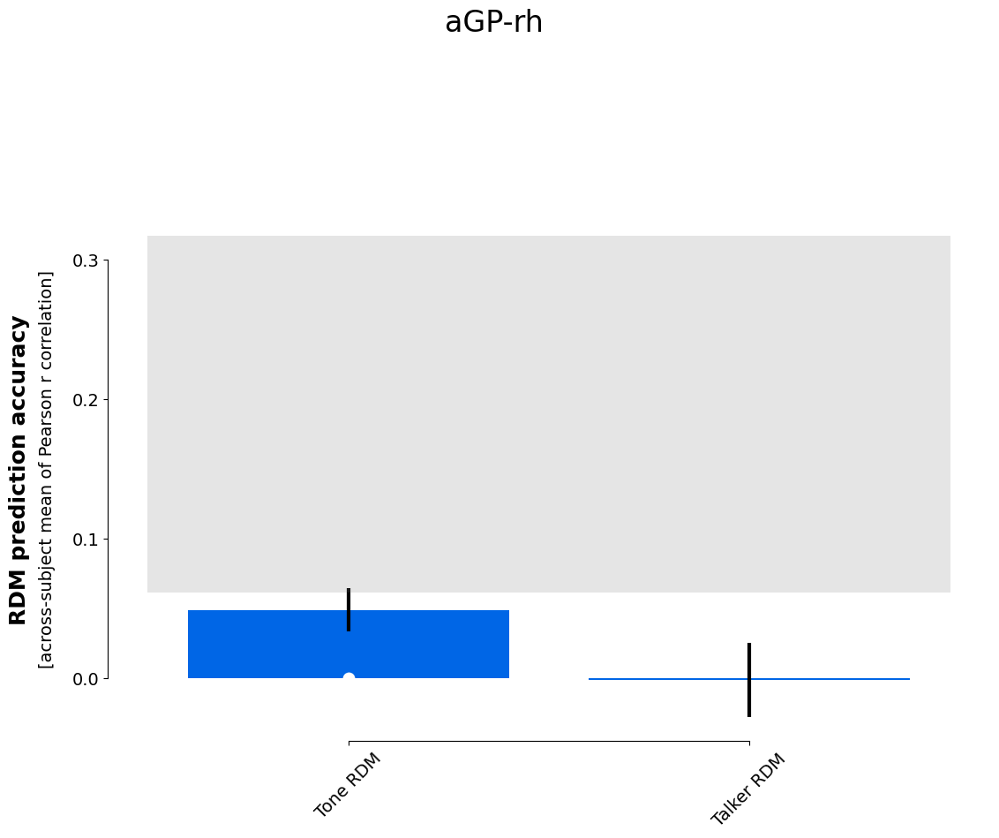

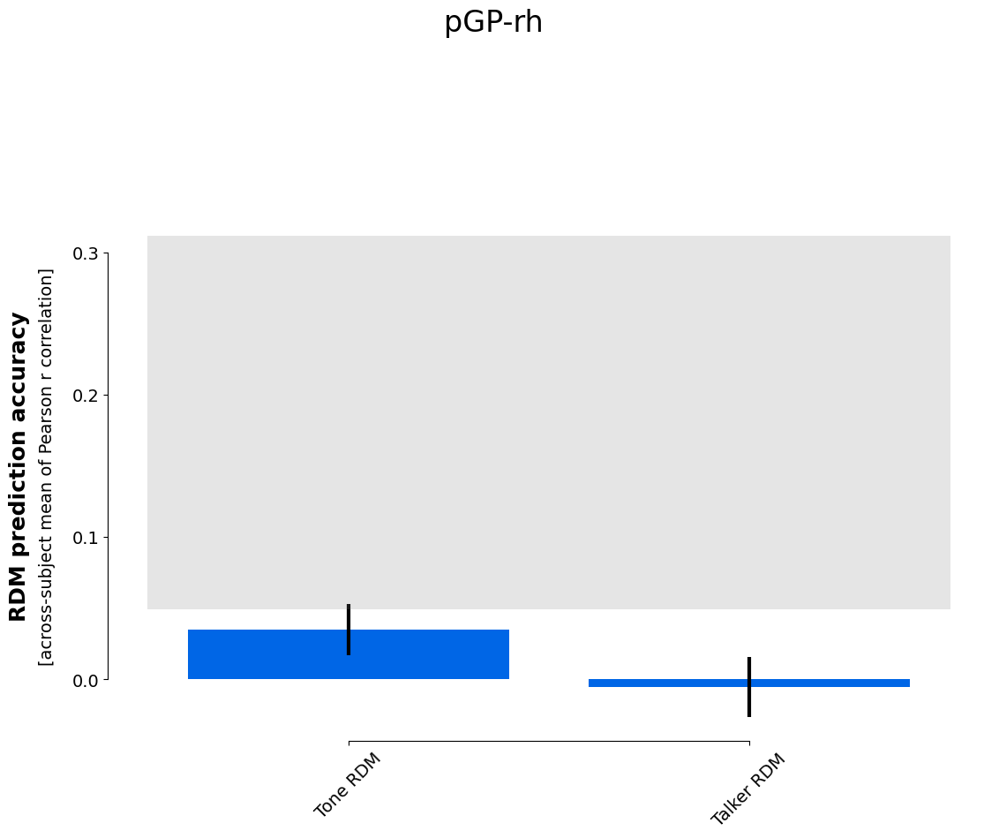

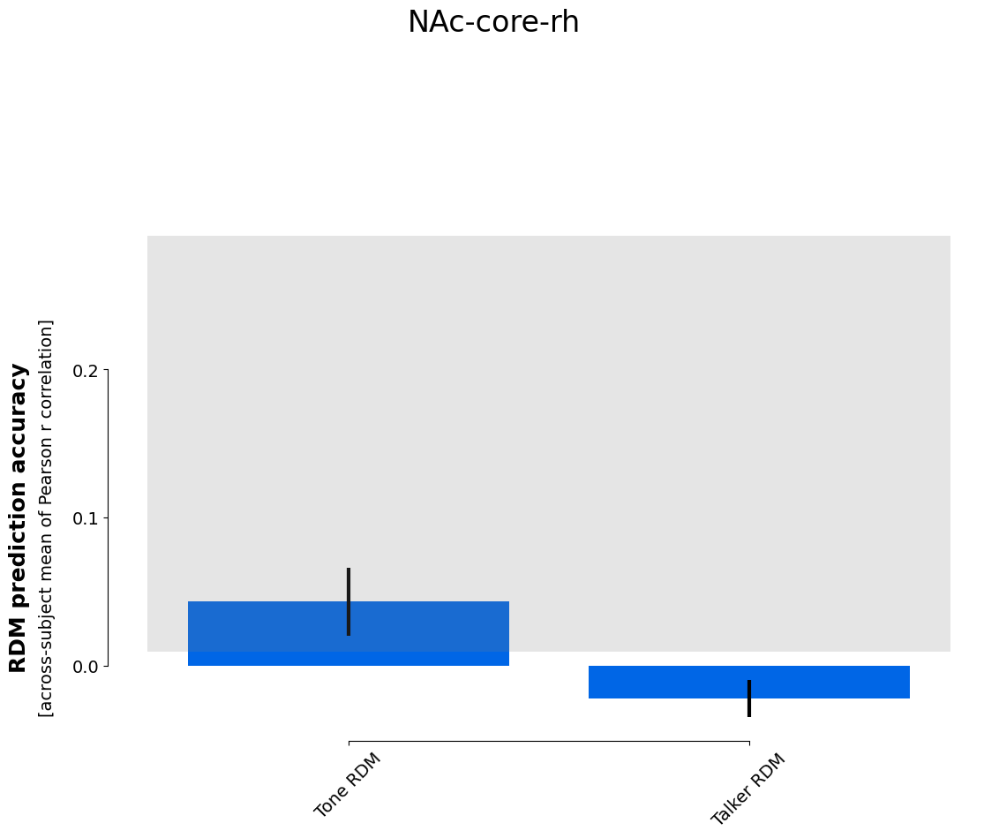

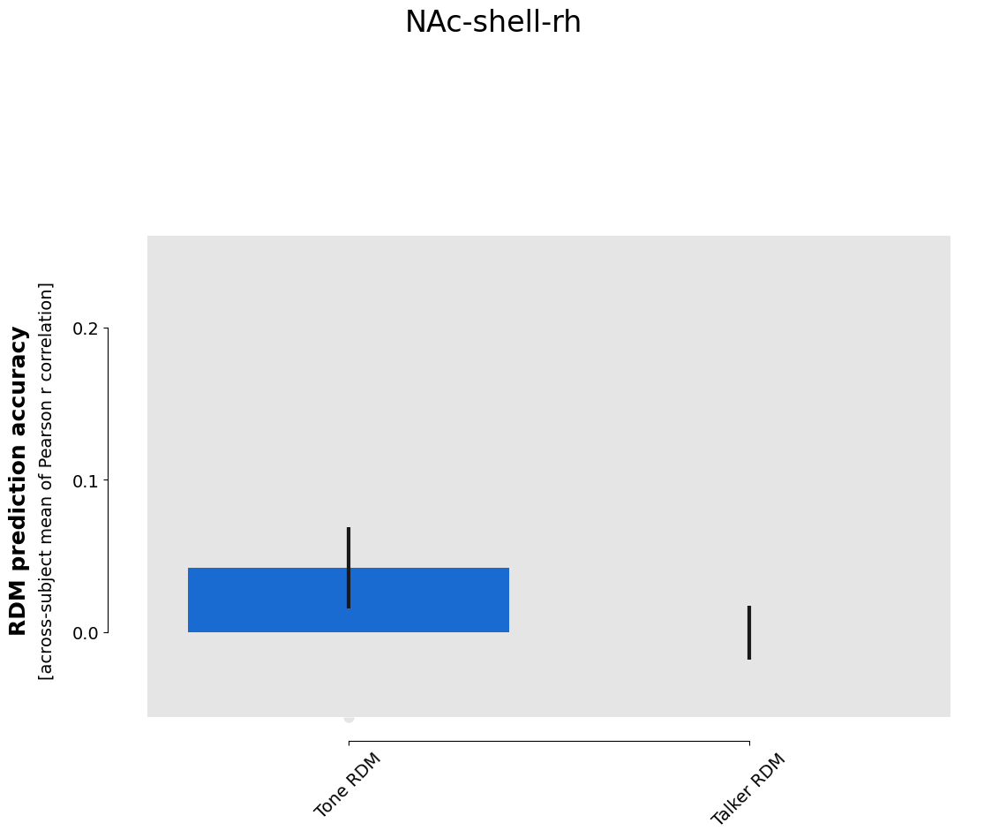

In [63]:
for rx, roi in enumerate(roi_list):
    fig = rsatoolbox.vis.plot_model_comparison(results_1[rx])
    fig[0].suptitle(roi, fontsize=24)

In [64]:
results_boot = rsatoolbox.inference.eval_dual_bootstrap(cat_models, runall_rdms, rdm_descriptor='ROI')

100%|██████████| 1000/1000 [00:56<00:00, 17.62it/s]


(<Figure size 1250x1000 with 2 Axes>, <Axes: >, <Axes: >)

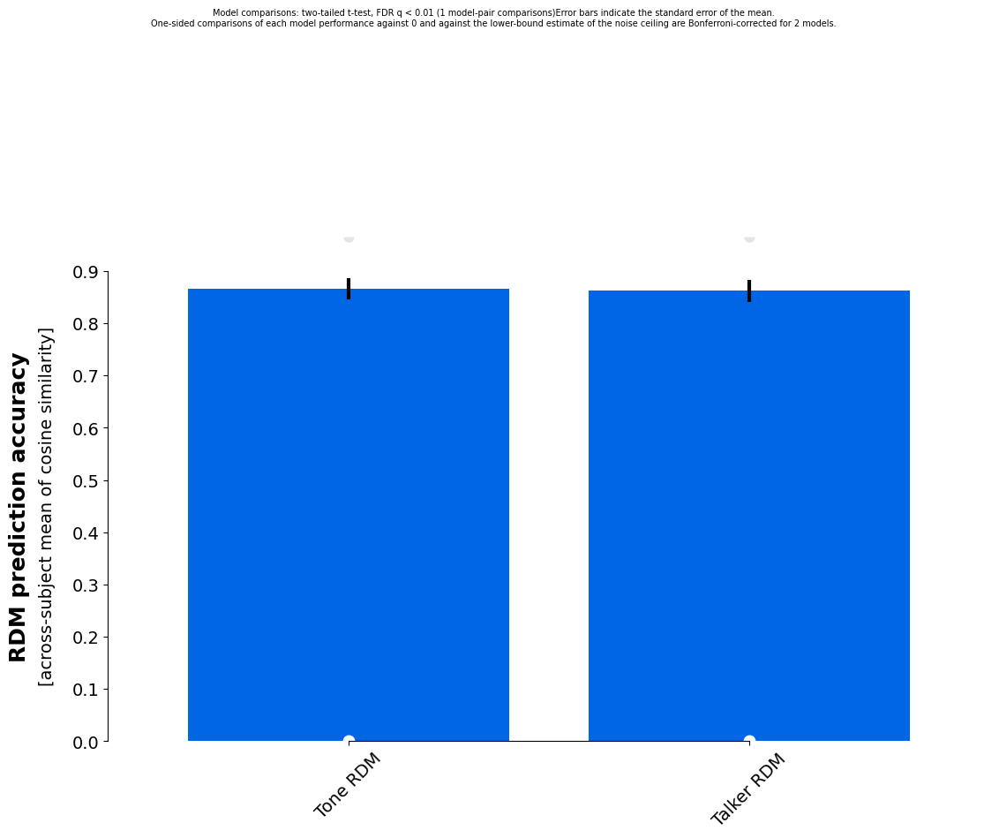

In [65]:
rsatoolbox.vis.plot_model_comparison(results_boot)

## WIP: Hierarchical representation tests

In [40]:
neural_models_dict = {}

neural_models_dict['Mandarin'] = [ModelFixed(x, rdm=mean_rdms_mand.subset('group', value='Mandarin').subset('ROI',value=x)) for x in np.unique(mean_rdms_mand.rdm_descriptors['ROI'])]
neural_models_dict['non-Mandarin'] = [ModelFixed(x, rdm=mean_rdms_nman.subset('group', value='non-Mandarin').subset('ROI',value=x)) for x in np.unique(mean_rdms_nman.rdm_descriptors['ROI'])]


In [ ]:
for group in np.unique(runall_rdms.rdm_descriptors['group']): # ['non-Mandarin']:# 
    for ROI in np.unique(runall_rdms.rdm_descriptors['ROI']):
        print(f'group-{group} ROI-{ROI}')
        results_grr = rsatoolbox.inference.eval_fixed(neural_models_dict[group], 
                                                      runall_rdms.subset('group', value=group).subset('ROI',value=ROI),  
                                                      method='corr',)
        fig, ax1, ax2 = rsatoolbox.vis.plot_model_comparison(results_grr,
                                                             test_pair_comparisons='nili', #False, # getting a bug from plot_arrow()
                                                            );
        ax1.set_title(f'group-{group} ROI-{ROI}');
        ax1.axes.set_xticklabels(ax1.xaxis.get_majorticklabels(), ha="right")